In [37]:
from ultralytics import SAM

# Load a model
model = SAM("sam_b.pt")

# Display model information (optional)
model.info()


Model summary: 173 layers, 93,735,472 parameters, 93,735,472 gradients


(173, 93735472, 93735472, 0.0)

In [38]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import ffmpeg
import shutil
import json
from scipy.ndimage import convolve

def extract_frames(video_path, output_folder, interval):
    os.makedirs(output_folder, exist_ok=True)
    ffmpeg.input(video_path, ss=0).output(
        f"{output_folder}frame_%03d.png", vf=f"fps=1/{interval}"
    ).run()

def remove_forks(skeleton):
    """
    Removes forks in the skeleton, preserving the dominant path.
    """
    # Define a 3x3 connectivity kernel
    kernel = np.array([[1,1,1],
                       [1,10,1],
                       [1,1,1]])

    # Convolve to find branch points
    neighbor_count = convolve(skeleton, kernel, mode='constant', cval=0)
    branch_points = (neighbor_count > 12) & (skeleton > 0)  # Forks have >2 neighbors

    # Create a copy of the skeleton to modify
    pruned_skeleton = skeleton.copy()

    # Iterate over branch points
    branch_coords = np.column_stack(np.where(branch_points))
    for y, x in branch_coords:
        # Extract paths from the fork
        neighbors = [(y+dy, x+dx) for dy, dx in [(-1,0), (1,0), (0,-1), (0,1)]
                     if skeleton[y+dy, x+dx] > 0]
        
        # Measure path length
        path_lengths = []
        for ny, nx in neighbors:
            visited = set()
            queue = [(ny, nx, 1)]  # (y, x, length)
            while queue:
                cy, cx, length = queue.pop(0)
                if (cy, cx) in visited:
                    continue
                visited.add((cy, cx))
                for dy, dx in [(-1,0), (1,0), (0,-1), (0,1)]:
                    ny, nx = cy+dy, cx+dx
                    if skeleton[ny, nx] > 0 and (ny, nx) not in visited:
                        queue.append((ny, nx, length+1))
            path_lengths.append((len(visited), ny, nx))

        # Keep the longest path and remove others
        if path_lengths:
            longest_path = max(path_lengths, key=lambda x: x[0])
            for _, ny, nx in path_lengths:
                if (ny, nx) != (longest_path[1], longest_path[2]):
                    pruned_skeleton[ny, nx] = 0

    return pruned_skeleton

def medial_axis_transform(binary_image, prune_branches):
    binary = (binary_image > 0).astype(np.uint8) * 255
    kernel = cv2.getStructuringElement(cv2.MORPH_CROSS, (3,3))
    skeleton = np.zeros(binary.shape, dtype=np.uint8)
    temp = binary.copy()
    
    while cv2.countNonZero(temp) > 0:
        eroded = cv2.erode(temp, kernel)
        opened = cv2.dilate(eroded, kernel)
        subtract = cv2.subtract(temp, opened)
        skeleton = cv2.bitwise_or(skeleton, subtract)
        temp = eroded.copy()
    if prune_branches:
        skeleton = remove_forks(skeleton)

    return skeleton

def create_SAM_mask(image_path, point):
    frame =  cv2.imread(image_path)
    results = model(image_path, points=point, labels=[1])
    b_mask = np.zeros(frame.shape[:2], np.uint8)

    contour = results[0].masks.xy.pop()
    contour = contour.astype(np.int32)
    contour = contour.reshape(-1, 1, 2)
    _ = cv2.drawContours(b_mask, [contour], -1, (255, 255, 255), cv2.FILLED)
    
    return b_mask

def eucledian_distance_map(skeleton, point):
    skeleton_binary = (skeleton > 0).astype(np.uint8)
    y, x = np.indices(skeleton_binary.shape)
    distance_map = np.sqrt(
        (x - point[0])**2 + 
        (y - point[1])**2
    )
    display_map = np.zeros_like(distance_map, dtype=np.float32)
    display_map[skeleton_binary > 0] = distance_map[skeleton_binary > 0]
    return display_map

def track_actuator_tip(
    frame_folder,
    start_frame,
    anchor_point,
    output_file,
    json_output_file, 
    end_frame=None,
    maximum_tip_travel_between_frames = 100,
    edge_cushion = 20,
    tip_margin = 1,
    debug=False,
    no_wandering_anchor=False,
    opening_kernel=(3,3),
    prune_branches=False
):
    frames = sorted(
        [
            os.path.join(frame_folder, f)
            for f in os.listdir(frame_folder)
            if f.endswith((".png", ".jpg"))
        ]
    )

    start_frame = max(0, start_frame)
    end_frame = min(len(frames), end_frame if end_frame is not None else len(frames))
    print(f"Analyzing frames {start_frame} to {end_frame-1}")
    print(f"Total frames used: {end_frame - start_frame}")

    frames = frames[start_frame:end_frame]

    tip_positions = []
    frame_times = []
    prev_corner = None
    tracking_data = {
        "frames": []
    }

    plt.figure(figsize=(12, 10))
    wandering_point = anchor_point
    for i, frame_path in enumerate(frames):
        frame = cv2.imread(frame_path)
        frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        b_mask = create_SAM_mask(frame_path, wandering_point)
        total_image_y_len, total_image_x_len = b_mask.shape
        white_pixels = np.column_stack(np.where(b_mask == 255))
        # Keep the wandering point at the top of the finger of bacterial leather
        filtered_pixels = white_pixels[
            (white_pixels[:, 1] >= edge_cushion) & 
            (white_pixels[:, 1] <= total_image_x_len - edge_cushion) &
            (white_pixels[:, 0] >= 0) & 
            (white_pixels[:, 0] <= edge_cushion)
        ]
        cy, cx = np.mean(filtered_pixels, axis=0).astype(int)
        
        kernel = np.ones(opening_kernel, np.uint8)
        cleaned_b_mask = cv2.morphologyEx(b_mask, cv2.MORPH_OPEN, kernel, iterations=5)
        skeleton = medial_axis_transform(cleaned_b_mask, prune_branches)
        distance_map = eucledian_distance_map(skeleton, wandering_point)

        result = frame_rgb.copy()
        tip_point = None
        if debug or i % 5 == 0:
            fig, axes = plt.subplots(2, 3, figsize=(15, 10))

            axes[0, 0].imshow(frame_rgb)
            axes[0, 0].set_title("Frame")
            axes[0, 0].axis("off")
            axes[0, 1].imshow(frame_rgb)  
            axes[0, 1].set_title("Frame with Point Selected")
            size = 10  # Size of the "X"
            thickness = 2  # Thickness of the lines
            axes[0, 1].plot([wandering_point[0] - size, wandering_point[0] + size], 
                            [wandering_point[1] - size, wandering_point[1] + size], 
                            color='green', linewidth=thickness)
            axes[0, 1].plot([wandering_point[0] - size, wandering_point[0] + size], 
                            [wandering_point[1] + size, wandering_point[1] - size], 
                            color='green', linewidth=thickness)
            axes[0, 1].axis('off')
            axes[0, 2].imshow(b_mask, cmap="gray")
            axes[0, 2].set_title("Binary Mask")
            axes[0, 2].axis("off")
            axes[1, 0].imshow(cleaned_b_mask, cmap="gray")
            axes[1, 0].set_title("Cleaned Binary Mask")
            axes[1, 0].axis("off")
            axes[1, 1].imshow(skeleton, cmap="gray")
            axes[1, 1].set_title("Skeleton")
            axes[1, 1].axis("off")
            axes[1, 2].imshow(distance_map)
            axes[1, 2].set_title("Distance Mapped Skeleton")
            axes[1, 2].axis("off")
            plt.tight_layout()
            plt.show()

        if no_wandering_anchor:
            wandering_point = anchor_point
        else:
            wandering_point = (cx, cy)
        
        if i == 0:
            max_distance = np.max(distance_map)
            max_points = np.column_stack(np.where(distance_map == max_distance))
            # Filter points within a small margin of the maximum distance
            near_max_points = max_points[distance_map[max_points[:, 0], max_points[:, 1]] >= (max_distance - tip_margin)]

            # Select the bottom-right point among these near-max points
            prev_corner = near_max_points[
                np.lexsort((near_max_points[:, 1], near_max_points[:, 0]))[-1]
            ][::-1]  # Convert to (x, y)

            tip_point = tuple(prev_corner)

        else:
            x, y = prev_corner
            
            y_min = max(edge_cushion, y - maximum_tip_travel_between_frames // 2)
            y_max = min(distance_map.shape[0] - edge_cushion, y + maximum_tip_travel_between_frames // 2)
            x_min = max(edge_cushion, x - maximum_tip_travel_between_frames // 2)
            x_max = min(distance_map.shape[1] - edge_cushion, x + maximum_tip_travel_between_frames // 2)
            
            window = distance_map[y_min:y_max, x_min:x_max]
            
            if np.any(~np.isnan(window)):
                max_window_distance = np.max(window)
                max_window_points = np.column_stack(np.where(window == max_window_distance))
                
                near_max_window_points = max_window_points[window[max_window_points[:, 0], max_window_points[:, 1]] >= (max_window_distance - tip_margin)]
                
                local_max_idx = near_max_window_points[
                    np.lexsort((near_max_window_points[:, 1], near_max_window_points[:, 0]))[-1]
                ]
                
                tip_point = (
                    x_min + local_max_idx[1], 
                    y_min + local_max_idx[0]
                )
                prev_corner = tip_point
            else:
                raise Exception("No valid points found in search window")

        if tip_point is not None:
            cv2.circle(result, tip_point, 5, (0, 0, 255), -1)
            tip_positions.append(tip_point)
            frame_times.append(i)
            
            import base64
            from io import BytesIO
            _, buffer = cv2.imencode('.png', b_mask)
            mask_base64 = base64.b64encode(buffer).decode('utf-8')
            
            frame_data = {
                "frame_index": start_frame + i,
                "frame_path": frame_path,
                "tip_position": {"x": int(tip_point[0]), "y": int(tip_point[1])},
                "anchor_point": {"x": int(wandering_point[0]), "y": int(wandering_point[1])},
                "mask": mask_base64
            }
            
            tracking_data["frames"].append(frame_data)
            
            with open(json_output_file, 'w') as f:
                json.dump(tracking_data, f)
        if debug or i % 5 == 0:
            plt.figure(figsize=(12, 5))
            plt.subplot(1, 2, 1)
            plt.imshow(result)
            plt.title(f"Frame {i} - Detected Tip")
            plt.axis("off")

            if len(tip_positions) > 1:
                tip_array = np.array(tip_positions)
                plt.subplot(1, 2, 2)
                plt.plot(tip_array[:, 0], tip_array[:, 1], "b-o")
                plt.scatter(tip_array[-1, 0], tip_array[-1, 1], color="red", s=100)
                plt.gca().invert_yaxis()
                plt.title("Tip Trajectory")
                plt.xlabel("X Position (pixels)")
                plt.ylabel("Y Position (pixels)")
                plt.grid(True)

            plt.tight_layout()
            plt.draw()
            plt.pause(0.1)
            plt.close()

    if tip_positions:
        tip_array = np.array(tip_positions)
        np.savetxt(
            output_file,
            np.column_stack((frame_times, tip_array)),
            delimiter=",",
            header="minutes,x,y",
            comments="",
        )

        plt.figure(figsize=(10, 8))
        plt.plot(tip_array[:, 0], tip_array[:, 1], "b-o")
        plt.gca().invert_yaxis()
        plt.title("Complete Tip Trajectory")
        plt.xlabel("X Position (pixels)")
        plt.ylabel("Y Position (pixels)")
        plt.grid(True)
        plt.savefig("tip_trajectory.png")
        plt.show()

    return tip_positions, frame_times #, tracking_data

ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

Analyzing frames 3 to 74
Total frames used: 72

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 373.7ms
Speed: 3.0ms preprocess, 373.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

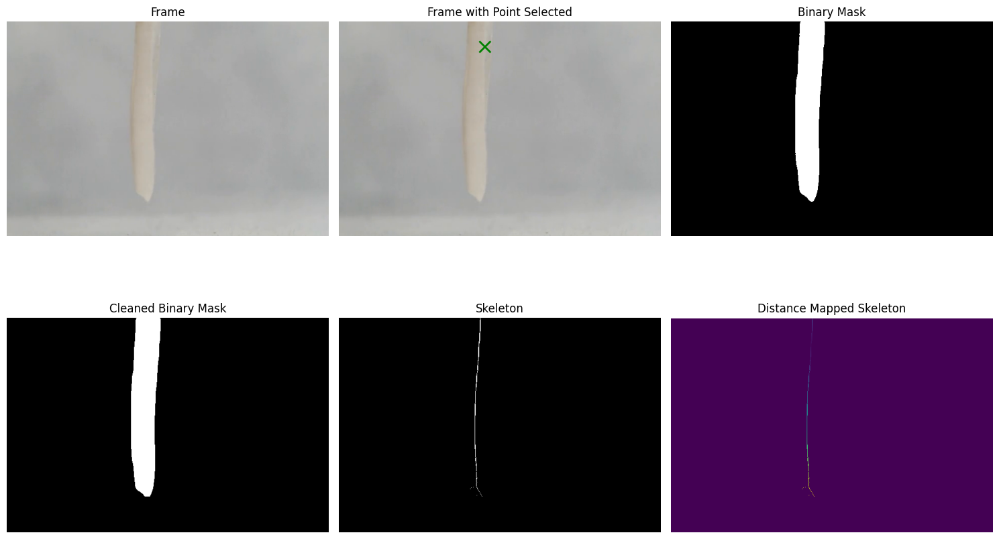

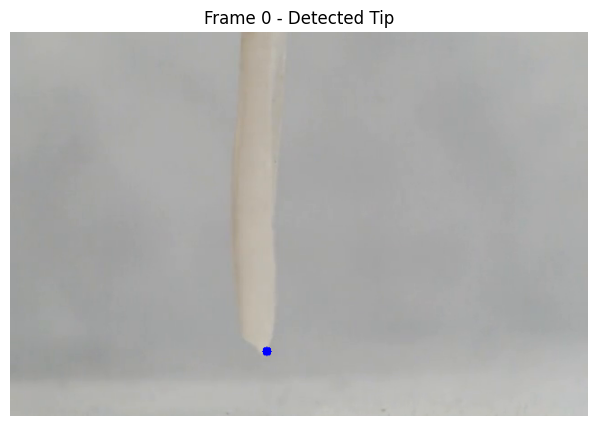


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 345.0ms
Speed: 5.6ms preprocess, 345.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 333.4ms
Speed: 3.1ms preprocess, 333.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 330.9ms
Speed: 3.2ms preprocess, 330.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 329.2ms
Speed: 3.1ms preprocess, 329.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 330.6ms
Speed: 3.0ms preprocess, 330.6

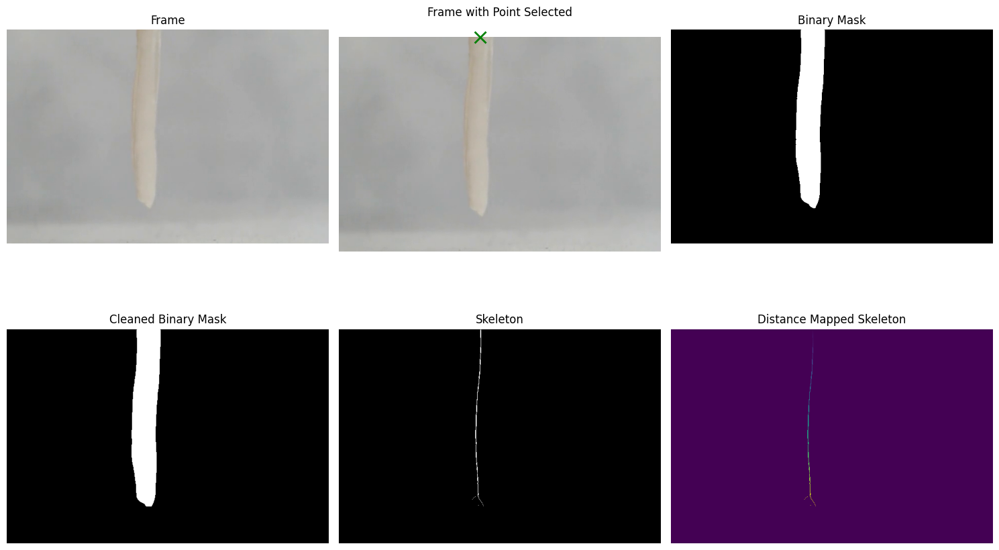

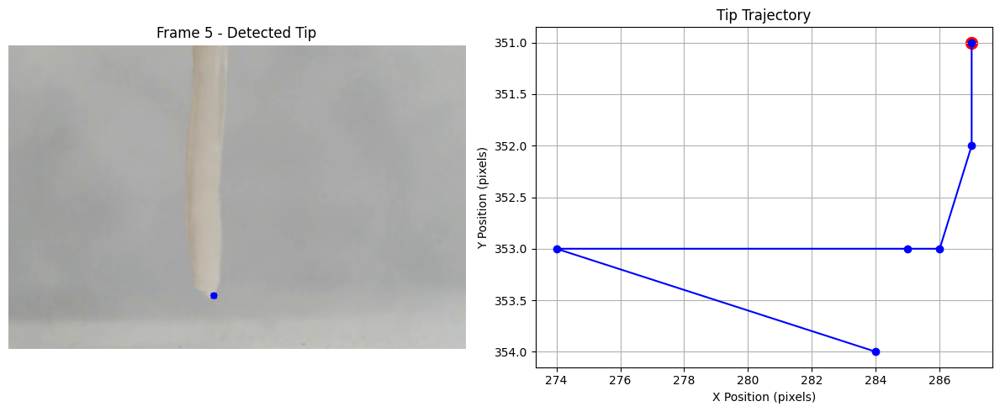


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 329.2ms
Speed: 4.9ms preprocess, 329.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 334.3ms
Speed: 3.1ms preprocess, 334.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 341.6ms
Speed: 3.1ms preprocess, 341.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 332.8ms
Speed: 3.0ms preprocess, 332.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 332.8ms
Speed: 3.1ms preprocess, 332.8

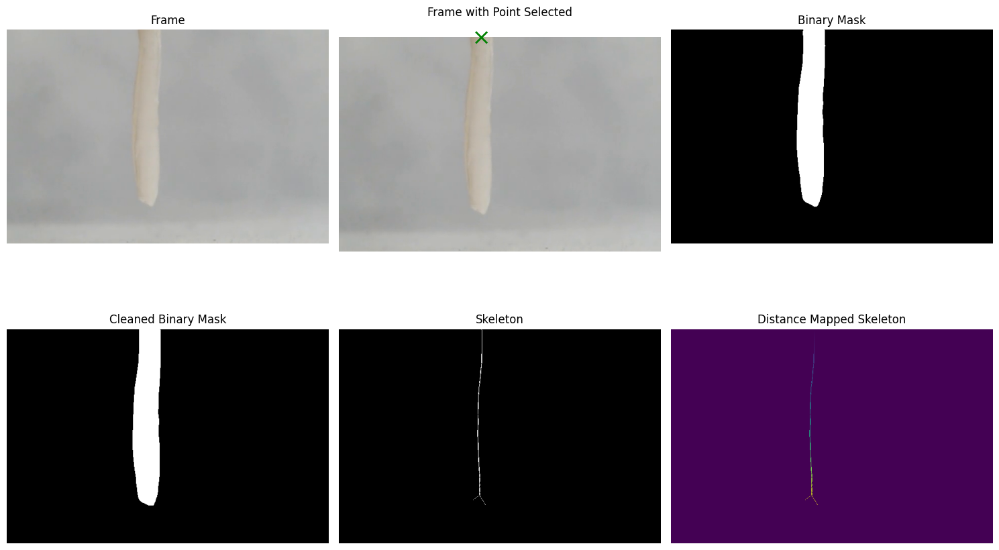

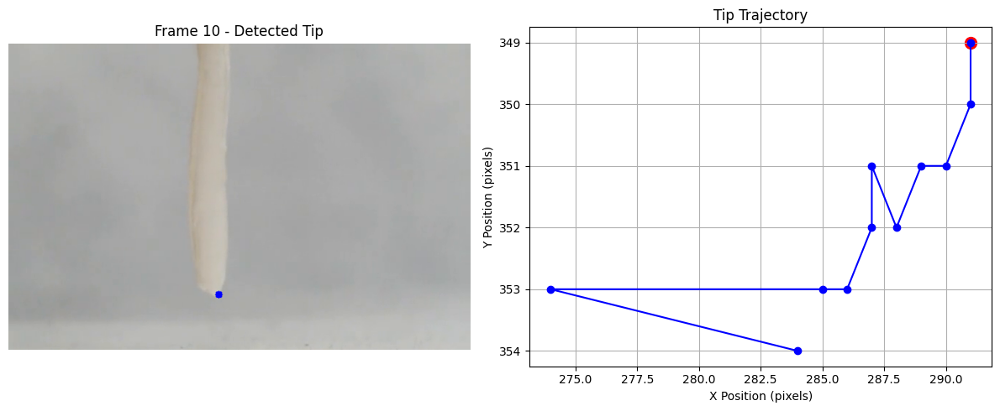


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 329.7ms
Speed: 4.8ms preprocess, 329.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 334.3ms
Speed: 10.6ms preprocess, 334.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 329.8ms
Speed: 3.0ms preprocess, 329.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 328.3ms
Speed: 3.1ms preprocess, 328.3ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 328.4ms
Speed: 3.0ms preprocess, 328.

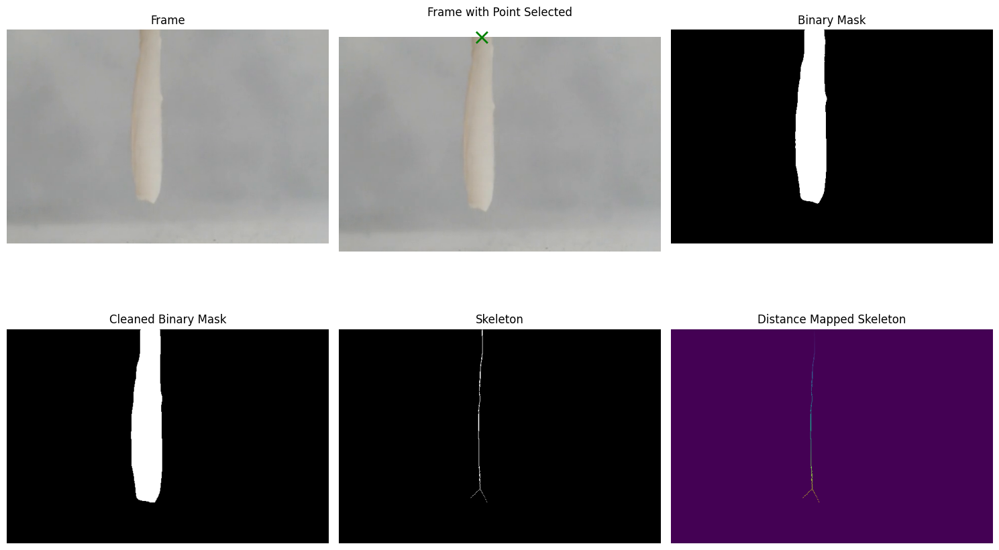

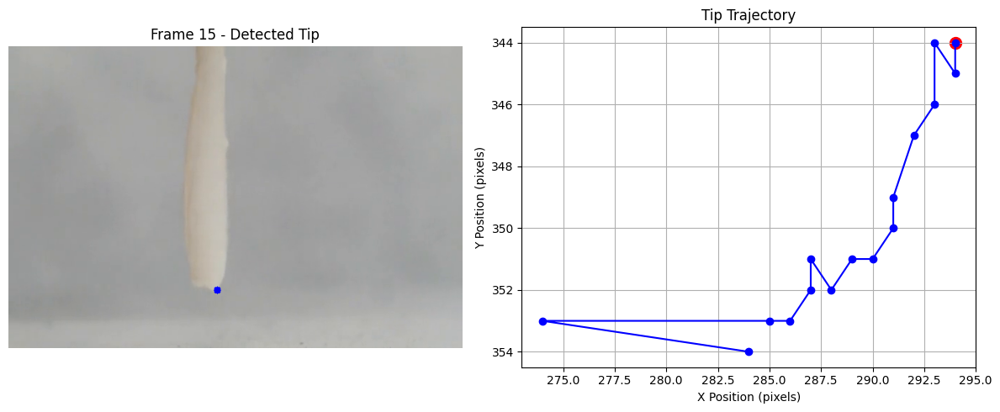


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 336.3ms
Speed: 4.8ms preprocess, 336.3ms inference, 4.1ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 324.7ms
Speed: 3.0ms preprocess, 324.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 324.5ms
Speed: 3.0ms preprocess, 324.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 324.2ms
Speed: 3.0ms preprocess, 324.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 324.5ms
Speed: 3.4ms preprocess, 324.5

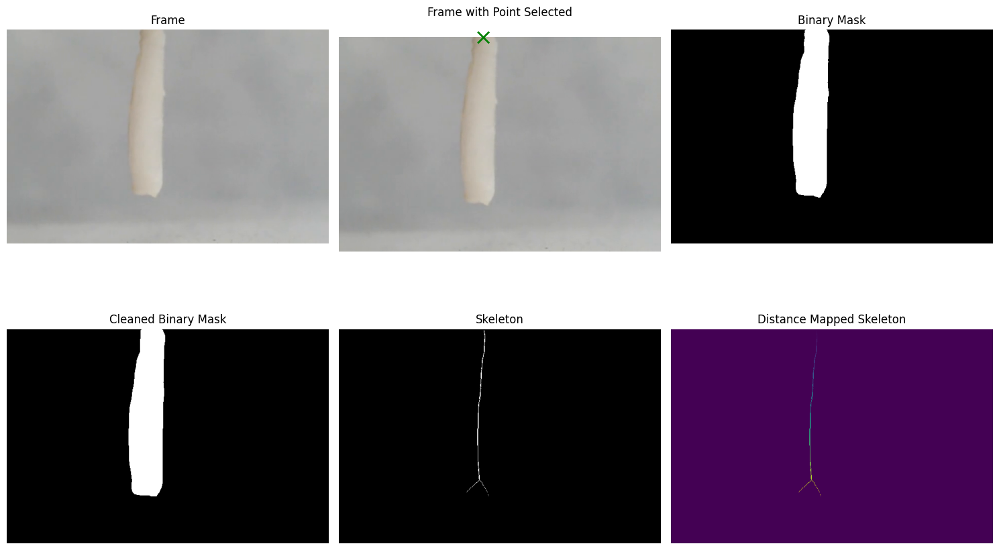

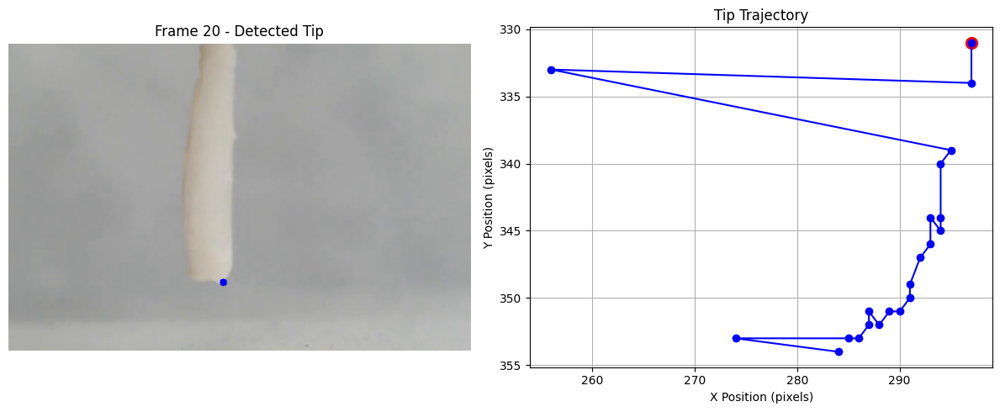


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 332.5ms
Speed: 4.9ms preprocess, 332.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 331.6ms
Speed: 9.1ms preprocess, 331.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 332.1ms
Speed: 3.0ms preprocess, 332.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 331.2ms
Speed: 3.0ms preprocess, 331.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 331.5ms
Speed: 3.0ms preprocess, 331.5

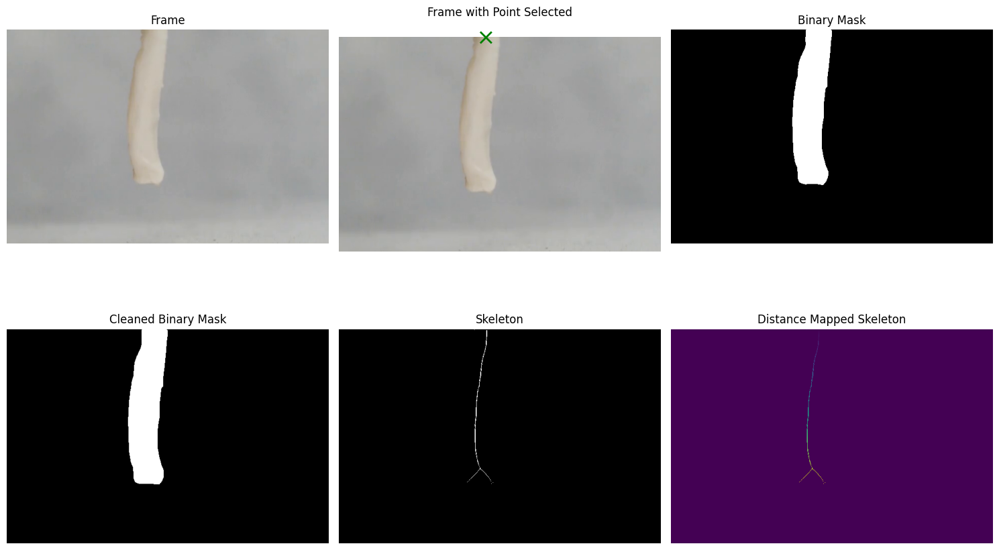

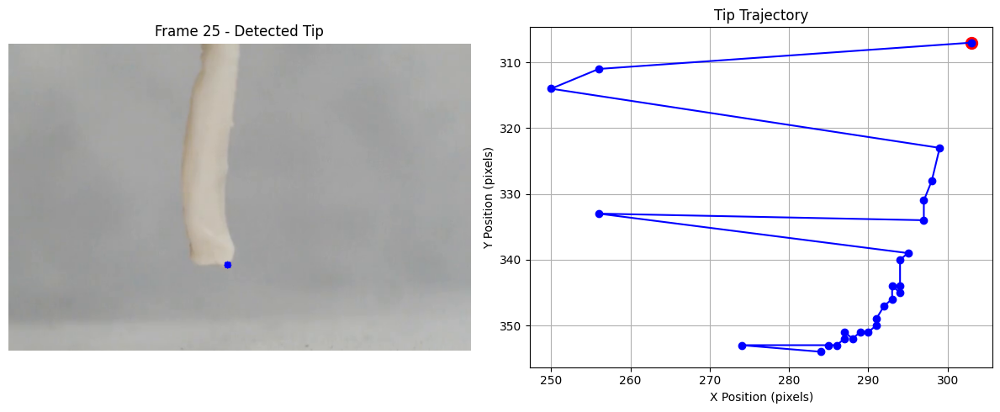


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 330.9ms
Speed: 4.9ms preprocess, 330.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 333.4ms
Speed: 9.6ms preprocess, 333.4ms inference, 0.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 333.3ms
Speed: 3.1ms preprocess, 333.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 334.9ms
Speed: 3.0ms preprocess, 334.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 332.0ms
Speed: 3.1ms preprocess, 332.0

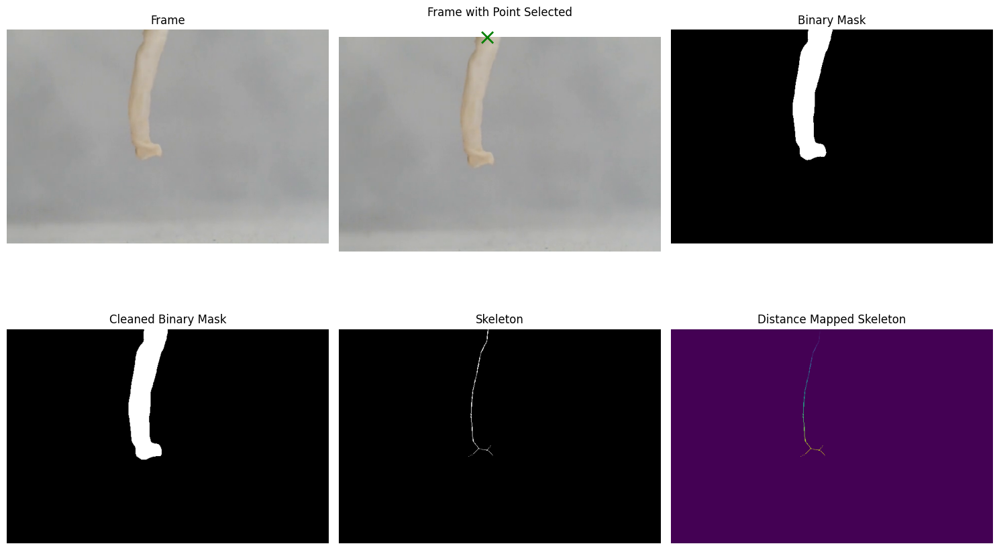

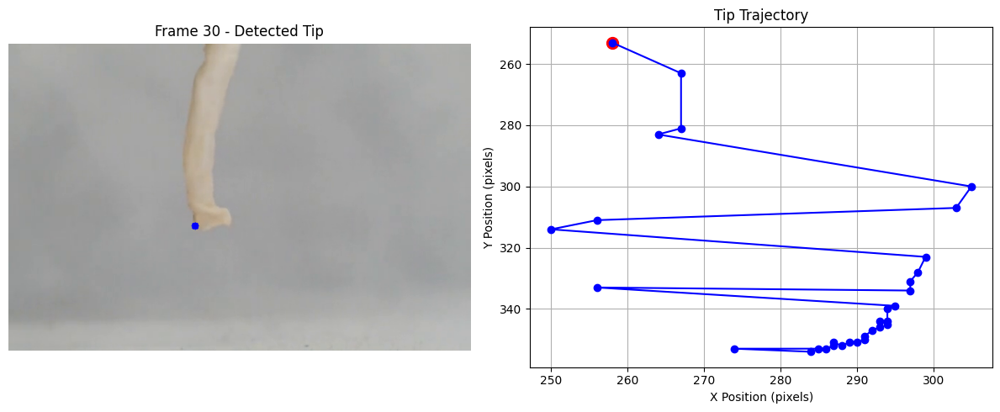


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 325.4ms
Speed: 4.9ms preprocess, 325.4ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_036.png: 1024x1024 1 0, 334.6ms
Speed: 4.3ms preprocess, 334.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_037.png: 1024x1024 1 0, 332.6ms
Speed: 3.0ms preprocess, 332.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_038.png: 1024x1024 1 0, 329.7ms
Speed: 3.0ms preprocess, 329.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_039.png: 1024x1024 1 0, 327.9ms
Speed: 3.1ms preprocess, 327.9

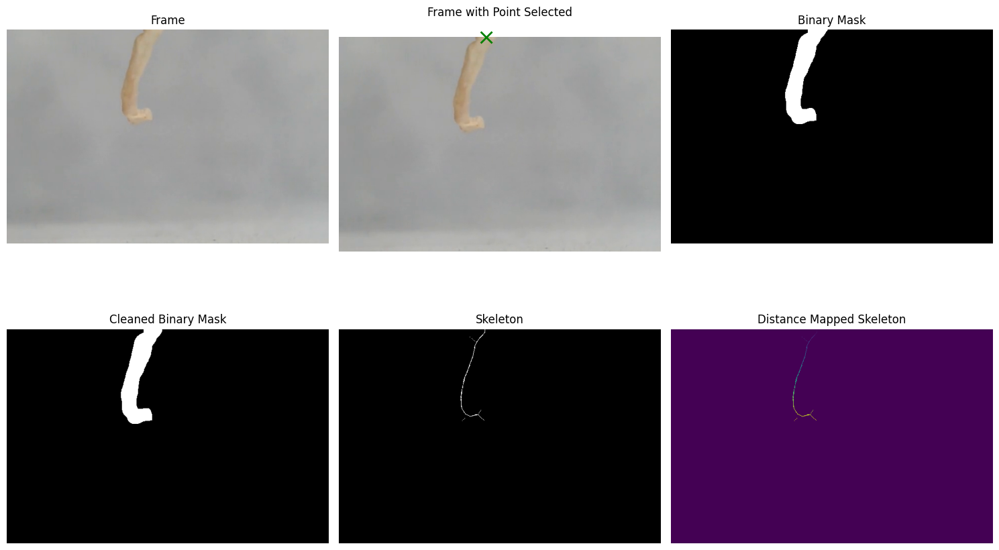

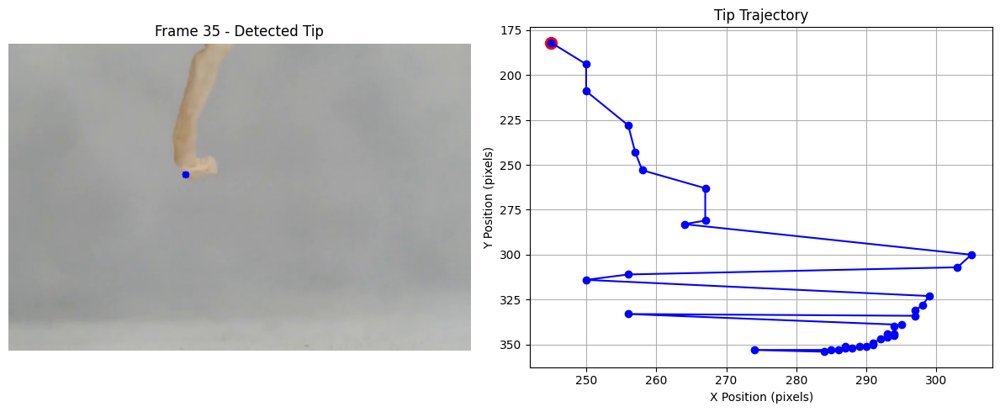


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_040.png: 1024x1024 1 0, 327.5ms
Speed: 4.8ms preprocess, 327.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_041.png: 1024x1024 1 0, 327.1ms
Speed: 2.9ms preprocess, 327.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_042.png: 1024x1024 1 0, 329.2ms
Speed: 2.9ms preprocess, 329.2ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_043.png: 1024x1024 1 0, 325.9ms
Speed: 3.1ms preprocess, 325.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_044.png: 1024x1024 1 0, 326.1ms
Speed: 2.9ms preprocess, 326.1

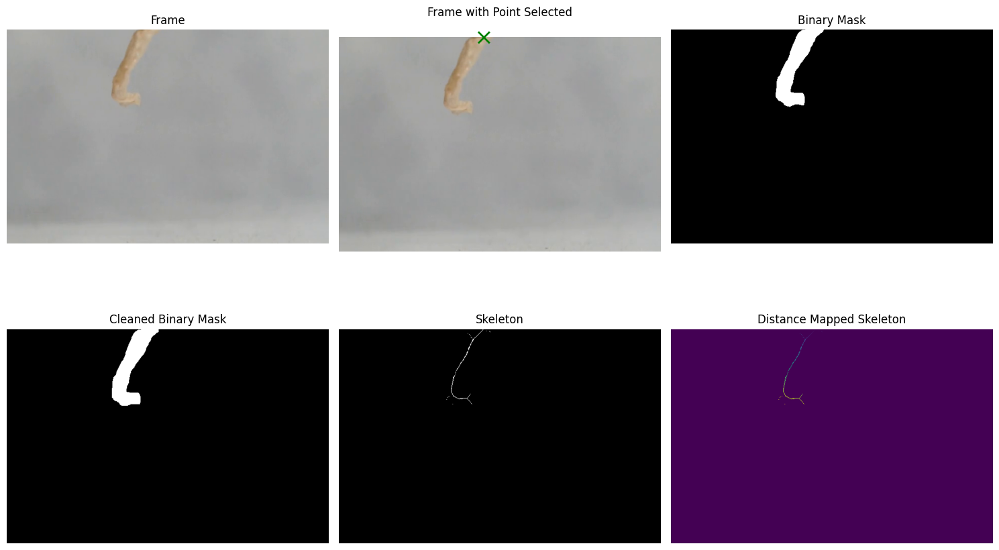

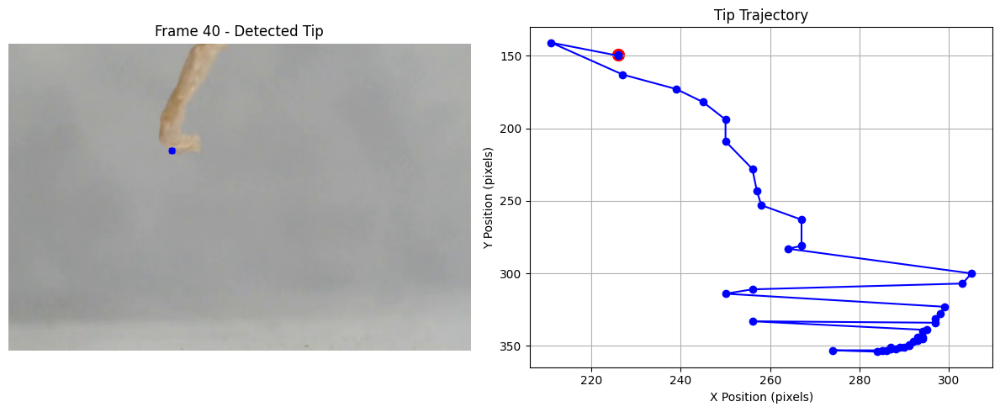


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_045.png: 1024x1024 1 0, 327.4ms
Speed: 4.8ms preprocess, 327.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_046.png: 1024x1024 1 0, 340.8ms
Speed: 2.9ms preprocess, 340.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_047.png: 1024x1024 1 0, 327.1ms
Speed: 2.9ms preprocess, 327.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_048.png: 1024x1024 1 0, 326.5ms
Speed: 2.9ms preprocess, 326.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_049.png: 1024x1024 1 0, 324.2ms
Speed: 2.9ms preprocess, 324.2

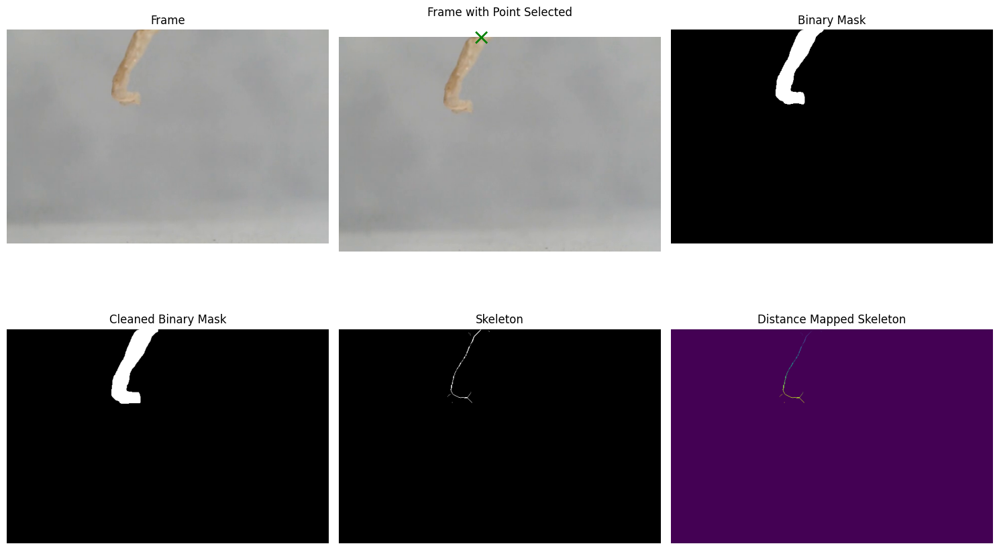

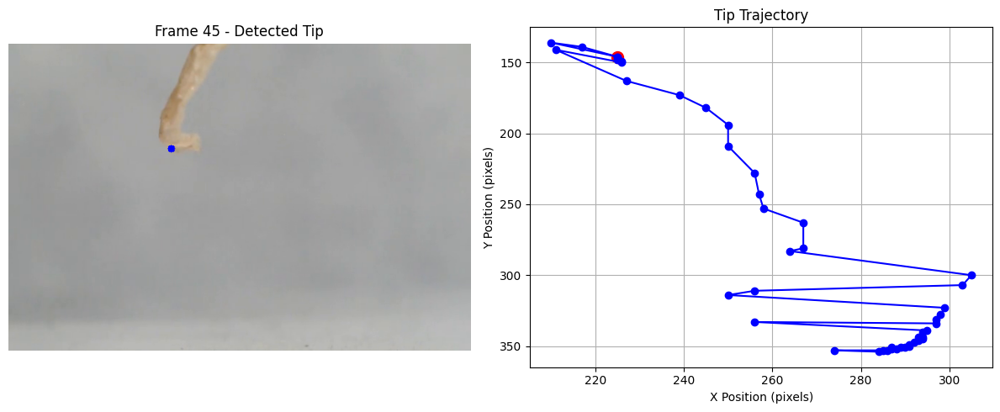


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_050.png: 1024x1024 1 0, 333.6ms
Speed: 5.2ms preprocess, 333.6ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_051.png: 1024x1024 1 0, 342.2ms
Speed: 3.1ms preprocess, 342.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_052.png: 1024x1024 1 0, 332.2ms
Speed: 3.1ms preprocess, 332.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_053.png: 1024x1024 1 0, 333.1ms
Speed: 3.1ms preprocess, 333.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_054.png: 1024x1024 1 0, 333.7ms
Speed: 3.0ms preprocess, 333.7

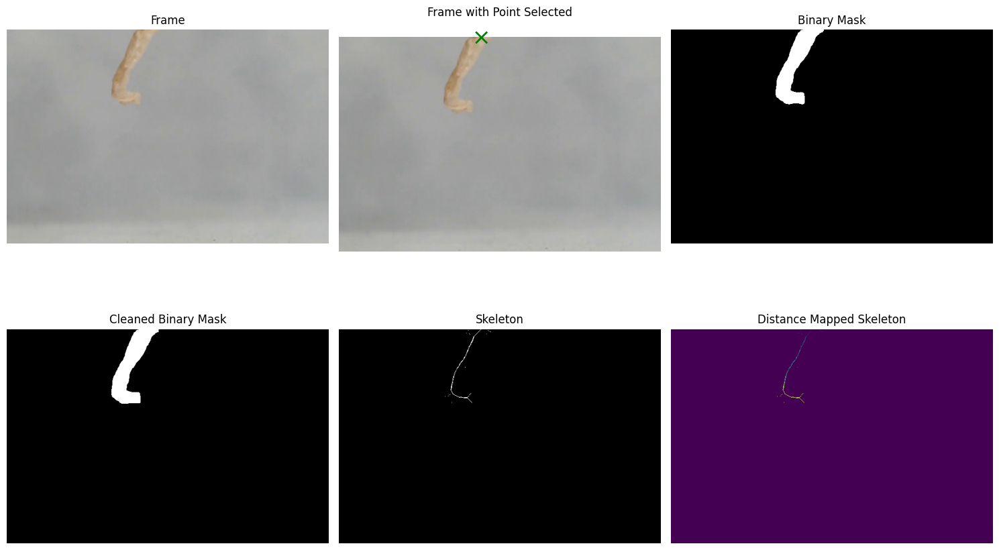

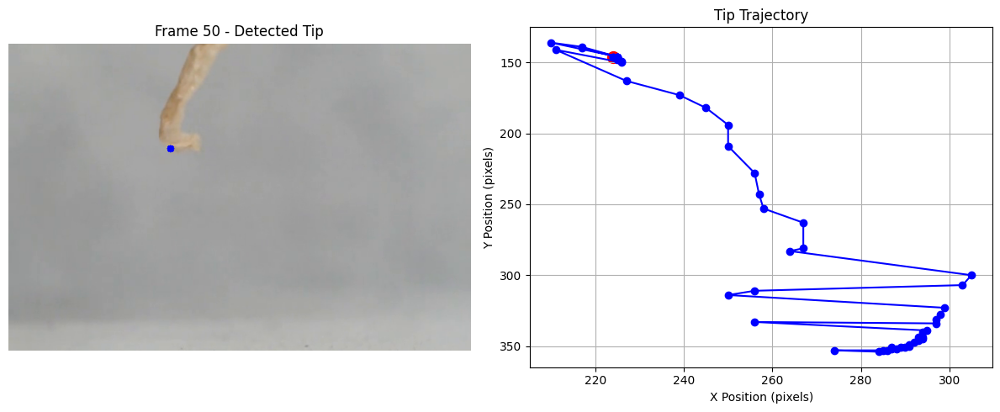


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_055.png: 1024x1024 1 0, 331.9ms
Speed: 3.0ms preprocess, 331.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_056.png: 1024x1024 1 0, 344.1ms
Speed: 3.1ms preprocess, 344.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_057.png: 1024x1024 1 0, 334.5ms
Speed: 3.0ms preprocess, 334.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_058.png: 1024x1024 1 0, 335.5ms
Speed: 3.4ms preprocess, 335.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_059.png: 1024x1024 1 0, 333.6ms
Speed: 3.0ms preprocess, 333.6

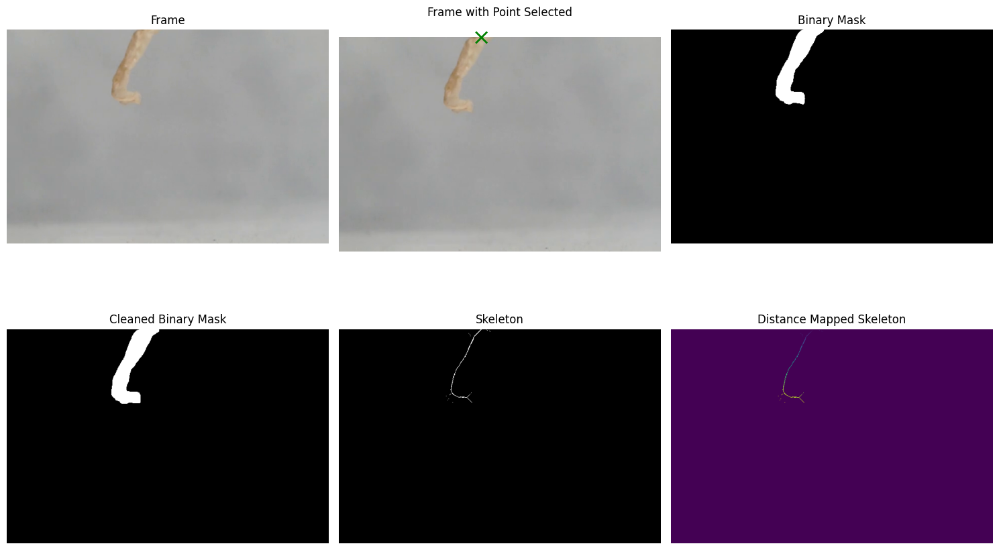

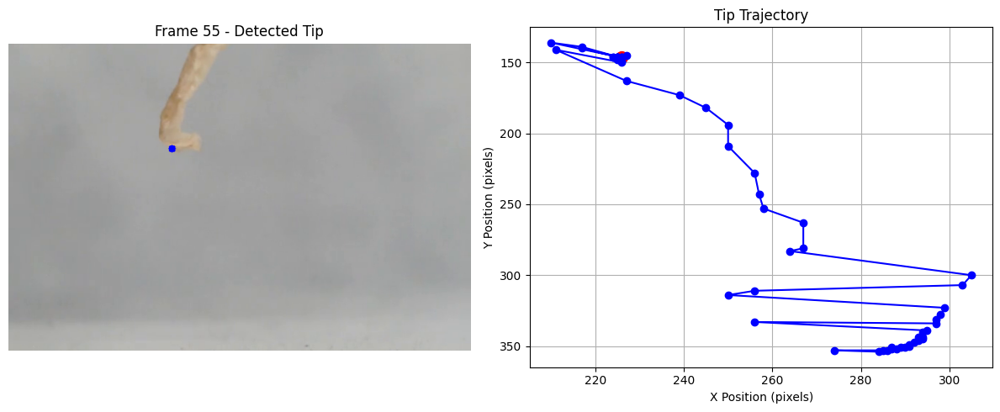


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_060.png: 1024x1024 1 0, 333.7ms
Speed: 4.8ms preprocess, 333.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_061.png: 1024x1024 1 0, 351.8ms
Speed: 3.0ms preprocess, 351.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_062.png: 1024x1024 1 0, 334.4ms
Speed: 3.0ms preprocess, 334.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_063.png: 1024x1024 1 0, 332.9ms
Speed: 3.1ms preprocess, 332.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_064.png: 1024x1024 1 0, 336.2ms
Speed: 3.1ms preprocess, 336.2

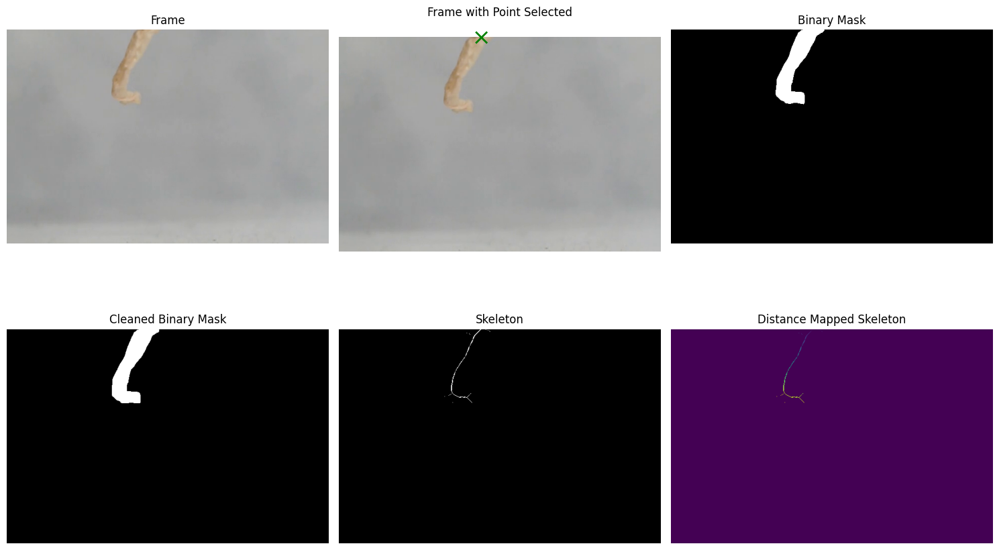

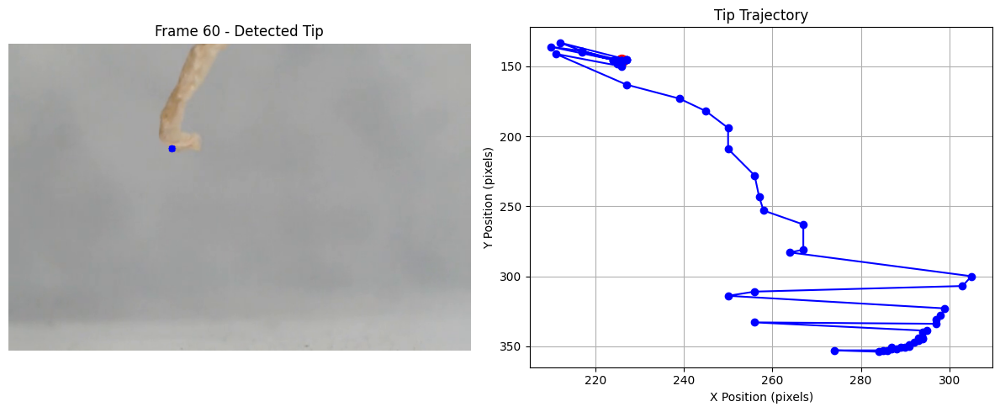


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_065.png: 1024x1024 1 0, 348.0ms
Speed: 4.9ms preprocess, 348.0ms inference, 2.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_066.png: 1024x1024 1 0, 333.3ms
Speed: 3.1ms preprocess, 333.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_067.png: 1024x1024 1 0, 332.6ms
Speed: 3.1ms preprocess, 332.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_068.png: 1024x1024 1 0, 332.4ms
Speed: 3.1ms preprocess, 332.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_069.png: 1024x1024 1 0, 332.7ms
Speed: 3.1ms preprocess, 332.7

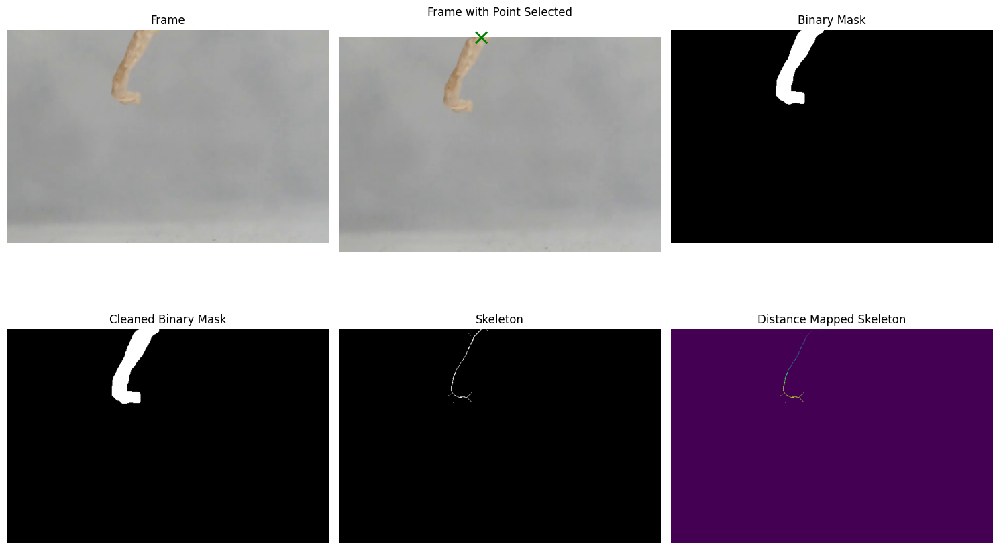

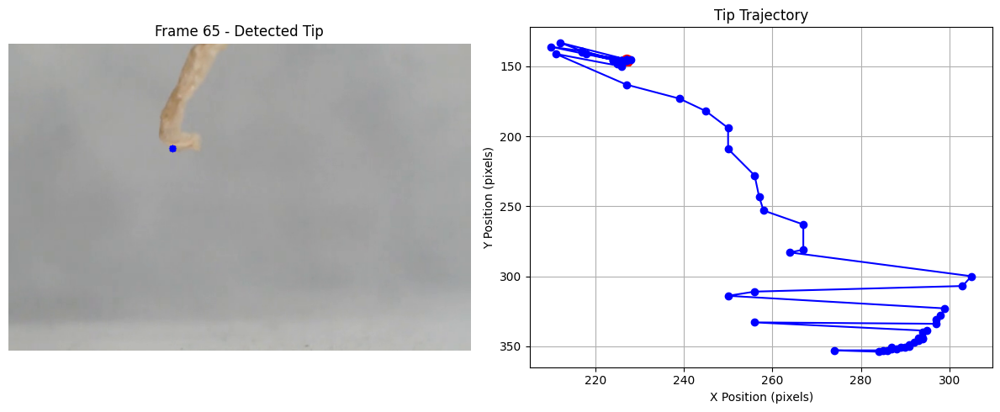


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_070.png: 1024x1024 1 0, 328.4ms
Speed: 5.0ms preprocess, 328.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_071.png: 1024x1024 1 0, 332.9ms
Speed: 3.1ms preprocess, 332.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_072.png: 1024x1024 1 0, 332.8ms
Speed: 3.1ms preprocess, 332.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_073.png: 1024x1024 1 0, 333.3ms
Speed: 3.1ms preprocess, 333.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_074.png: 1024x1024 1 0, 335.2ms
Speed: 3.1ms preprocess, 335.2

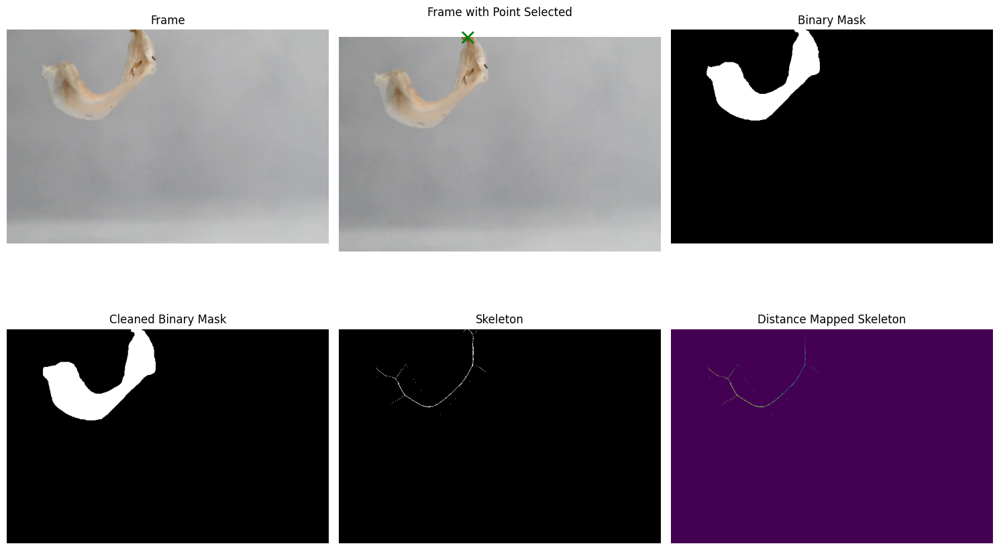

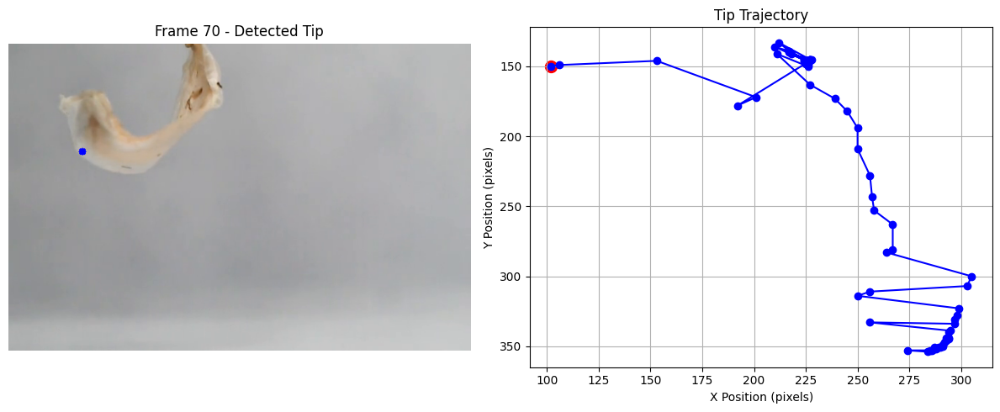


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_075.png: 1024x1024 1 0, 345.9ms
Speed: 5.0ms preprocess, 345.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


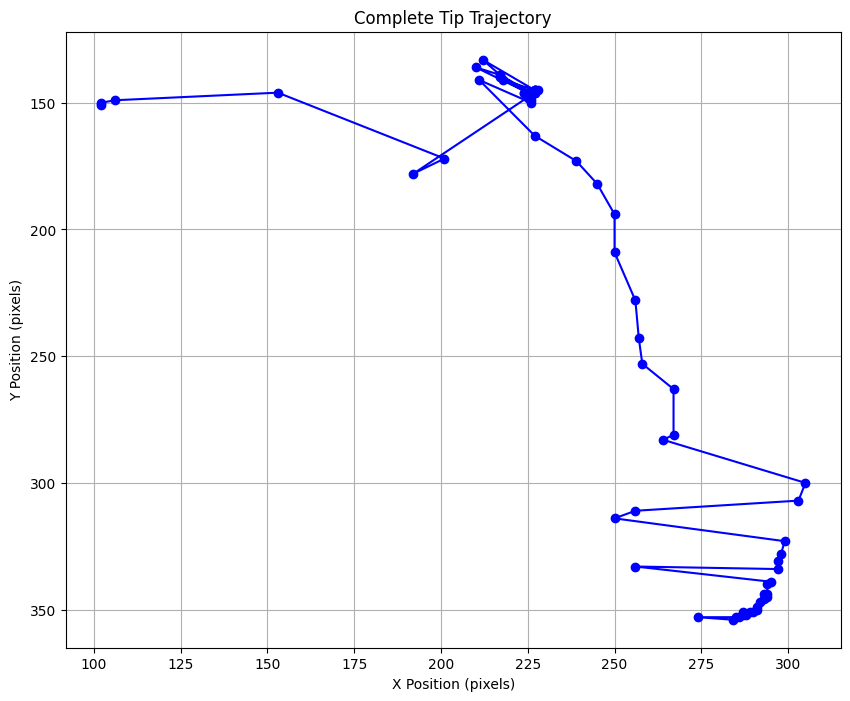

In [39]:
# Set paths
video_name = f"control_idx0_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 3
end_frame = None
frame_interval=0.6
point = (290, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    maximum_tip_travel_between_frames = 100,
    edge_cushion =0,
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

Analyzing frames 3 to 30
Total frames used: 28



ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 333.1ms
Speed: 3.0ms preprocess, 333.1ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

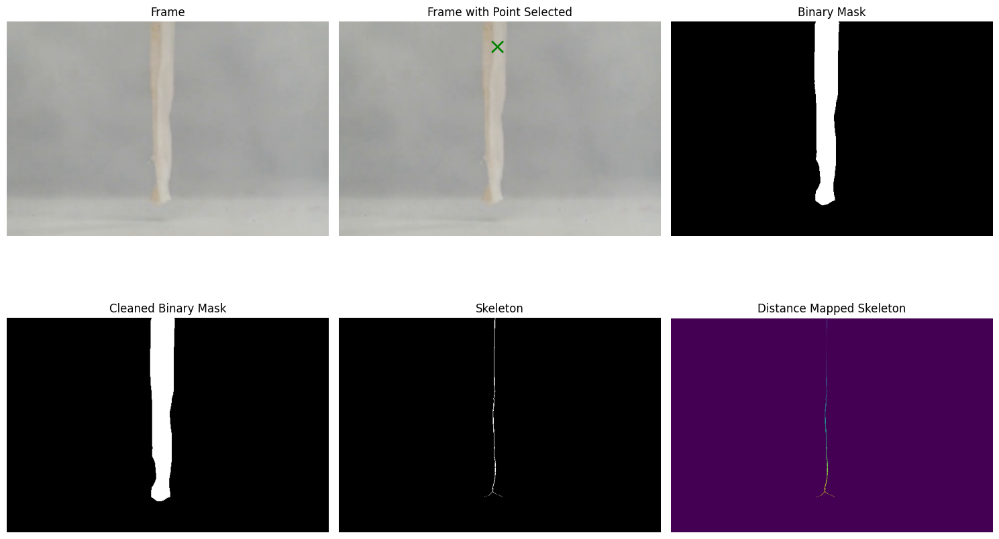

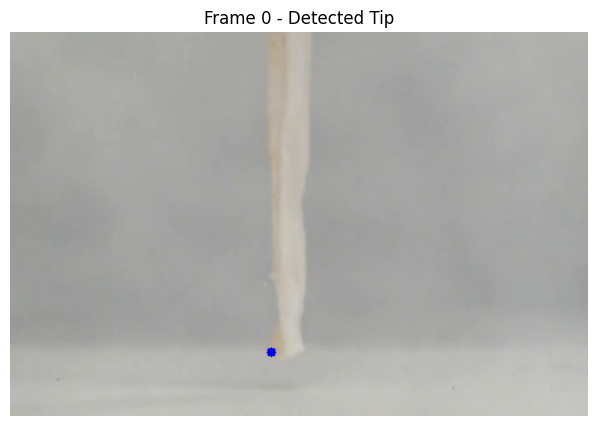


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 325.5ms
Speed: 5.1ms preprocess, 325.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 344.7ms
Speed: 3.1ms preprocess, 344.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 332.9ms
Speed: 3.1ms preprocess, 332.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 333.2ms
Speed: 3.1ms preprocess, 333.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 332.3ms
Speed: 3.0ms preprocess, 332.3

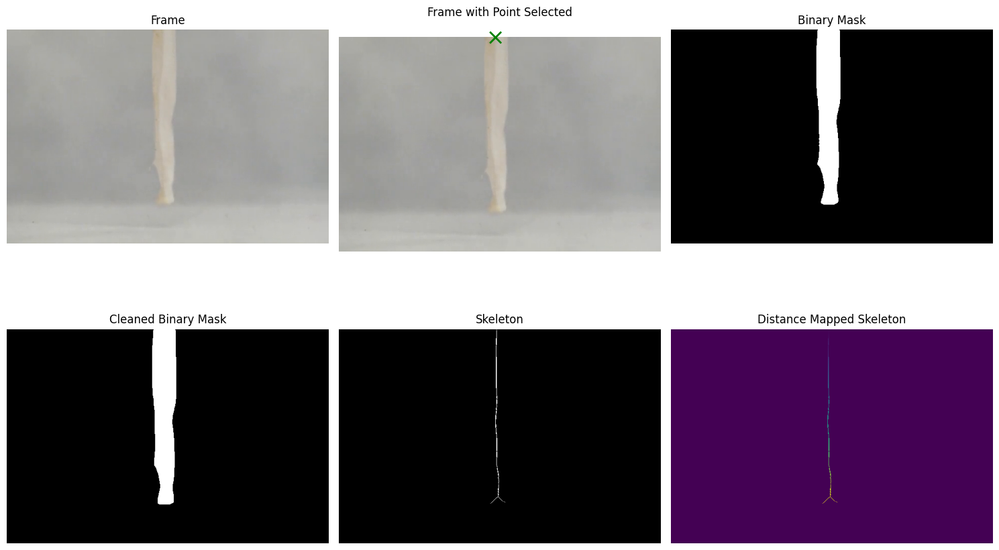

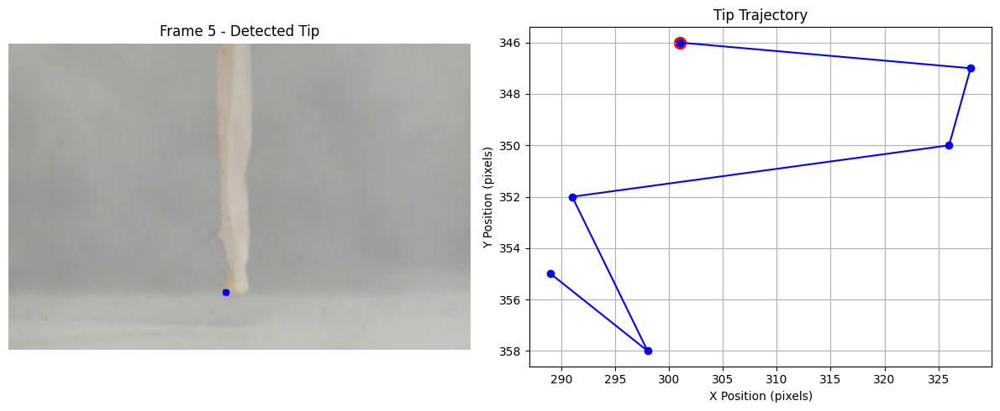


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 338.1ms
Speed: 6.1ms preprocess, 338.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 332.5ms
Speed: 3.1ms preprocess, 332.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 332.7ms
Speed: 3.6ms preprocess, 332.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 332.5ms
Speed: 3.1ms preprocess, 332.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 335.9ms
Speed: 3.1ms preprocess, 335.9

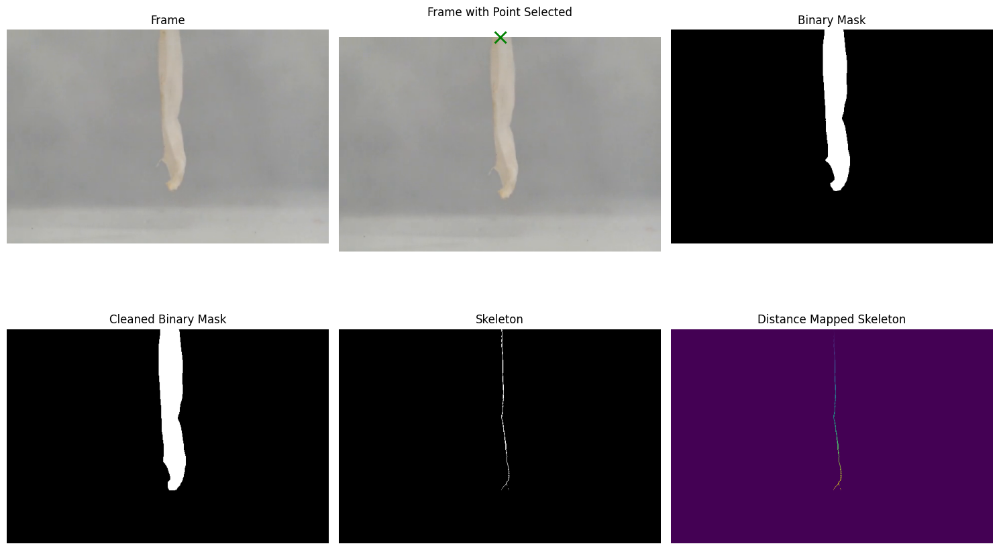

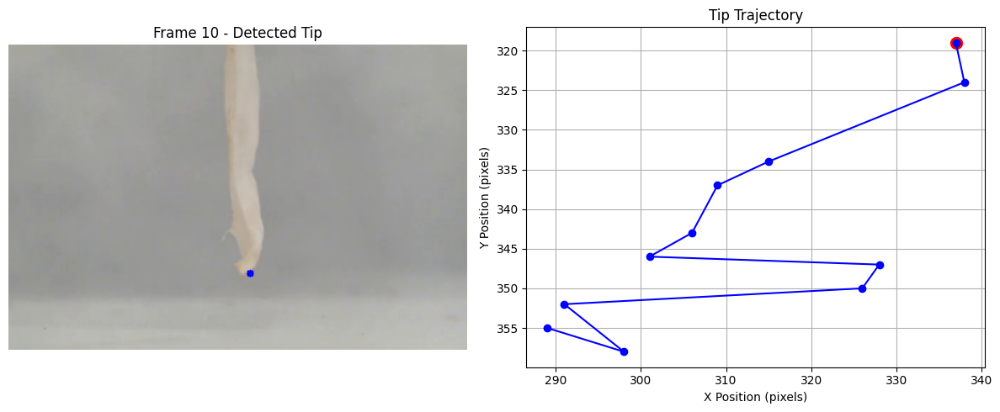


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 331.8ms
Speed: 4.8ms preprocess, 331.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 338.8ms
Speed: 3.1ms preprocess, 338.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 333.2ms
Speed: 3.2ms preprocess, 333.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 332.1ms
Speed: 3.0ms preprocess, 332.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 332.0ms
Speed: 3.0ms preprocess, 332.0

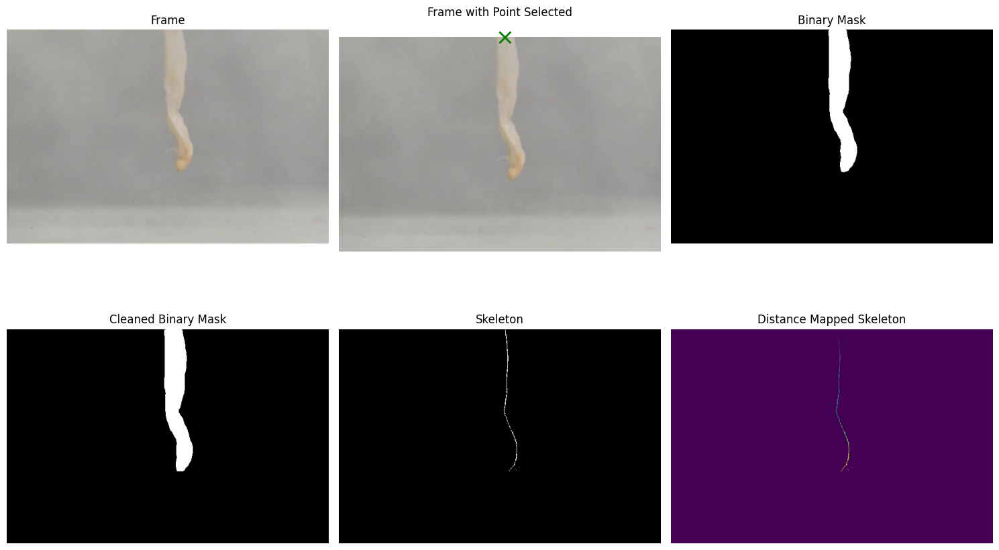

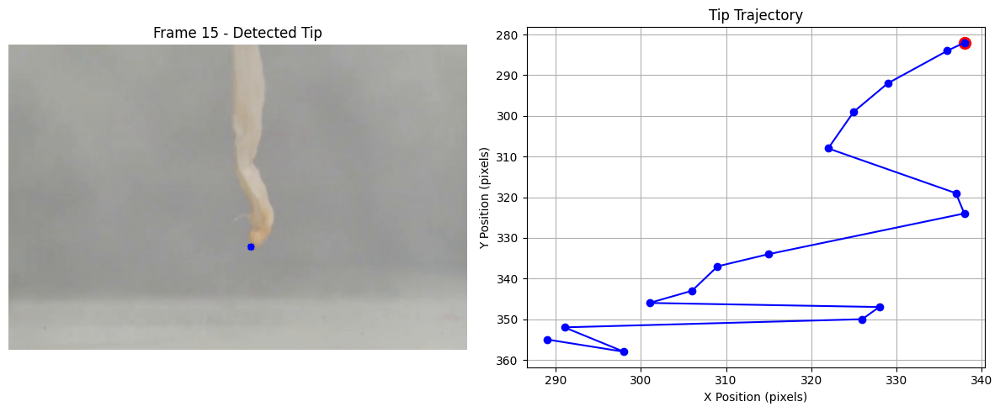


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 334.5ms
Speed: 4.8ms preprocess, 334.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 343.0ms
Speed: 3.0ms preprocess, 343.0ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 327.9ms
Speed: 3.0ms preprocess, 327.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 327.7ms
Speed: 3.0ms preprocess, 327.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 329.7ms
Speed: 3.1ms preprocess, 329.7

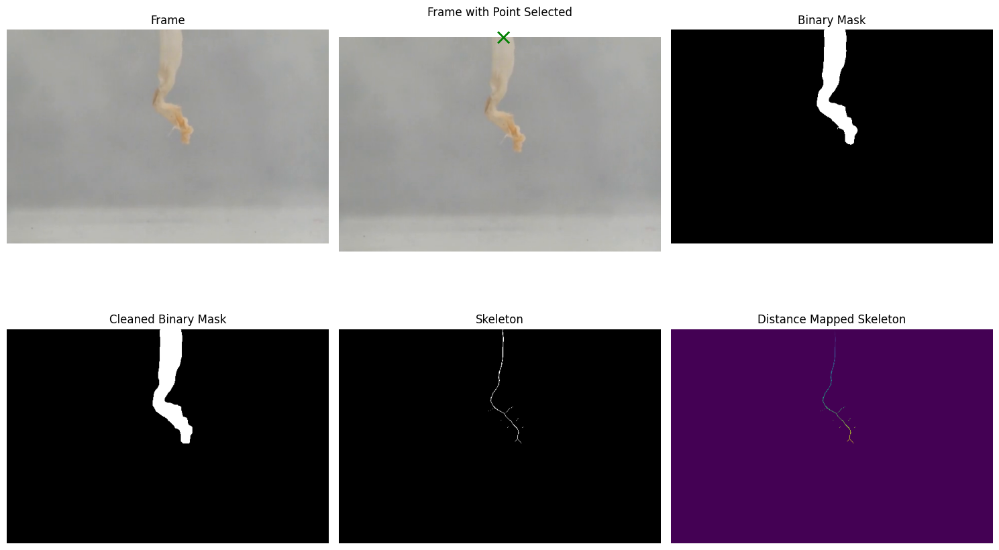

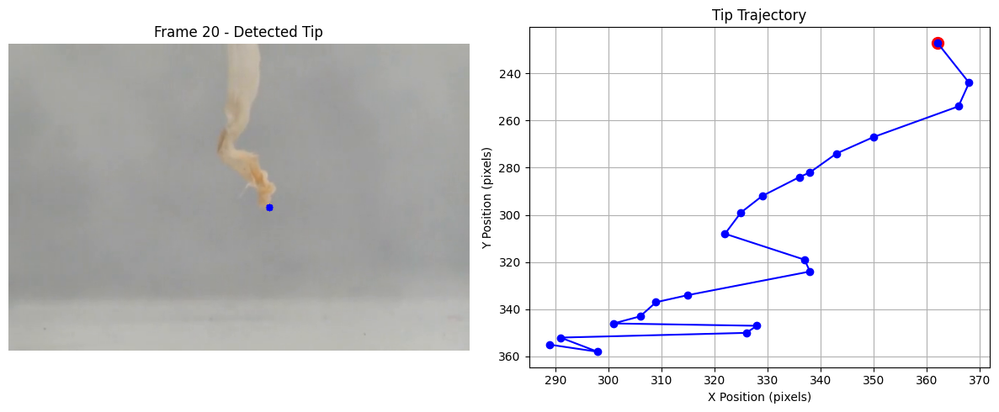


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 334.4ms
Speed: 4.9ms preprocess, 334.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 340.5ms
Speed: 3.1ms preprocess, 340.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 330.5ms
Speed: 3.1ms preprocess, 330.5ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 330.5ms
Speed: 3.1ms preprocess, 330.5ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 330.6ms
Speed: 3.1ms preprocess, 330.6

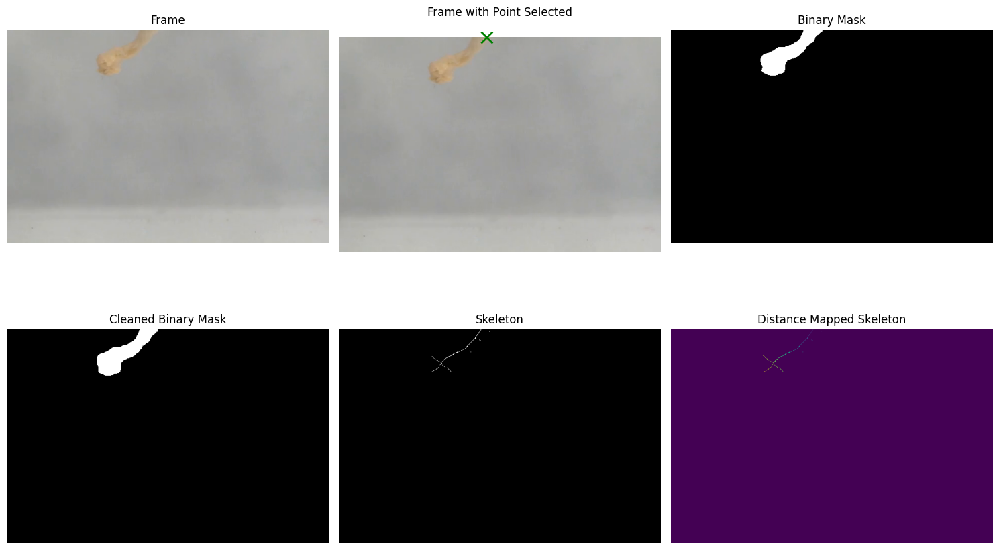

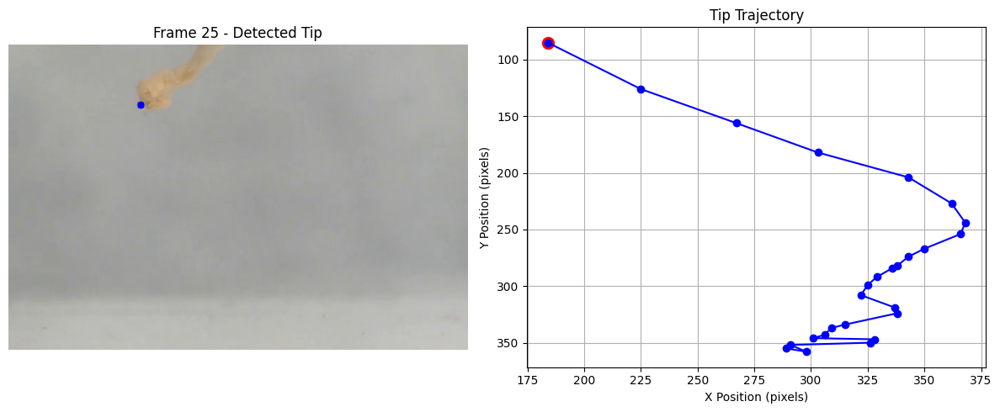


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 330.9ms
Speed: 5.0ms preprocess, 330.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 341.6ms
Speed: 3.1ms preprocess, 341.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


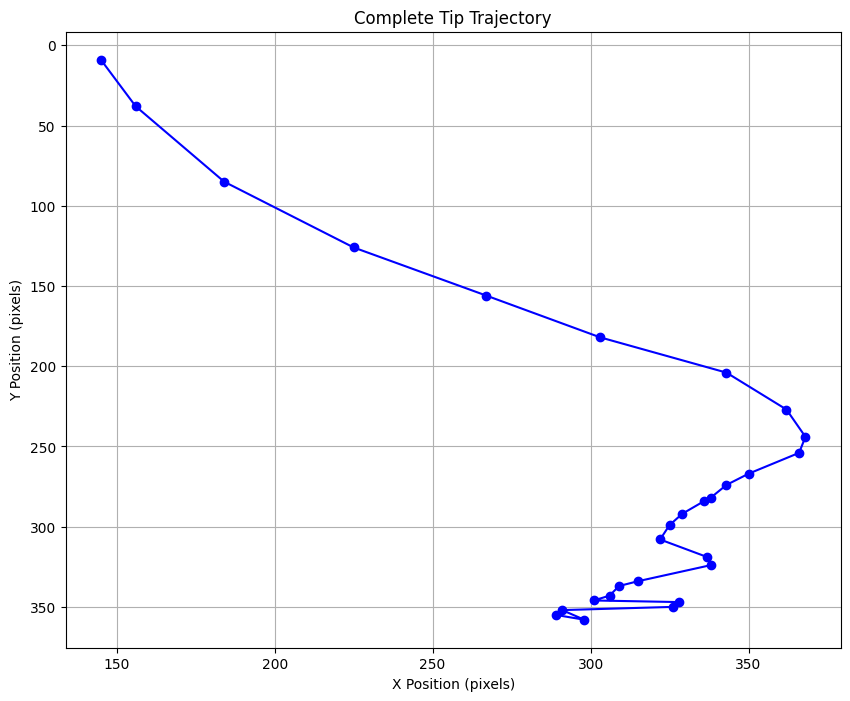

In [40]:
# Set paths
video_name = f"control_idx1_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 3
end_frame = None
frame_interval=0.6
point = (315, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    edge_cushion =0
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

Analyzing frames 3 to 43
Total frames used: 41



ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 359.5ms
Speed: 3.1ms preprocess, 359.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

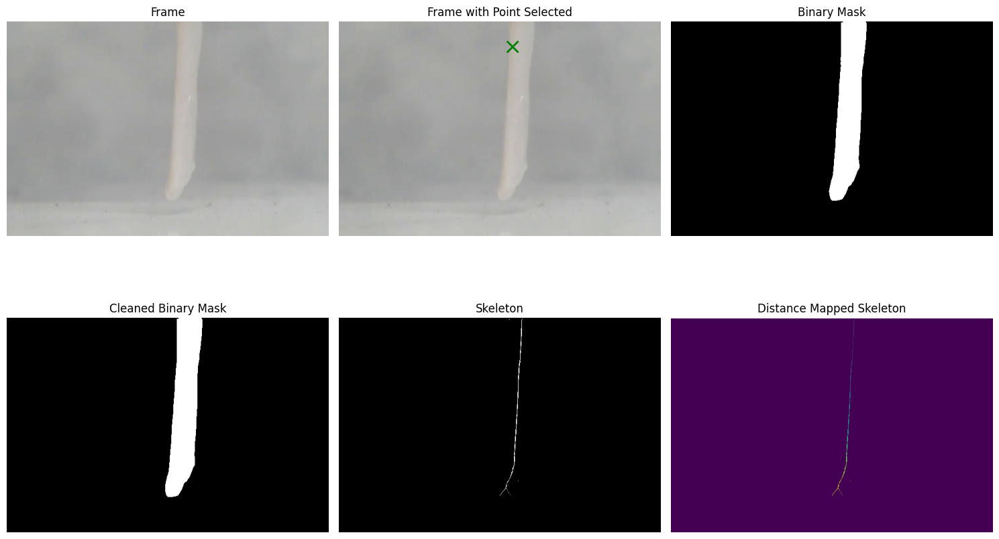

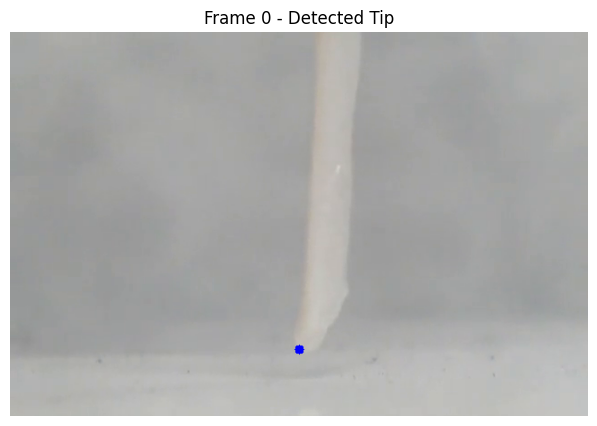


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 326.7ms
Speed: 4.9ms preprocess, 326.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 329.1ms
Speed: 3.1ms preprocess, 329.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 329.5ms
Speed: 3.1ms preprocess, 329.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 329.2ms
Speed: 3.1ms preprocess, 329.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 328.8ms
Speed: 3.1ms preprocess, 328.8

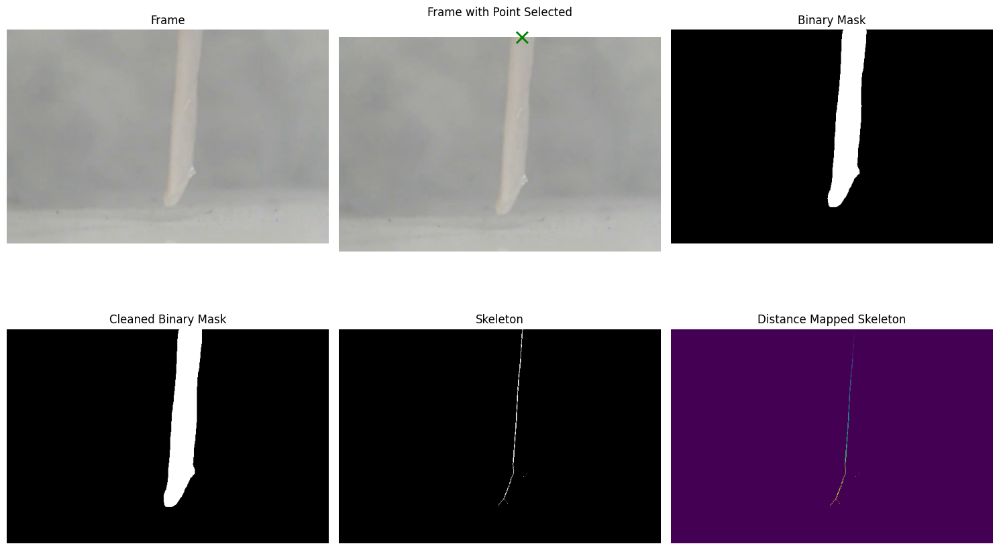

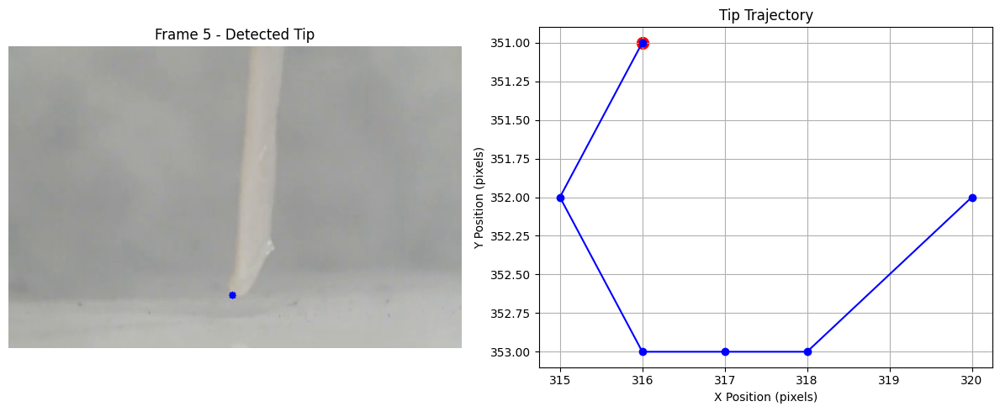


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 334.4ms
Speed: 4.8ms preprocess, 334.4ms inference, 2.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 329.2ms
Speed: 3.0ms preprocess, 329.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 328.5ms
Speed: 3.0ms preprocess, 328.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 328.7ms
Speed: 3.0ms preprocess, 328.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 329.6ms
Speed: 3.0ms preprocess, 329.6

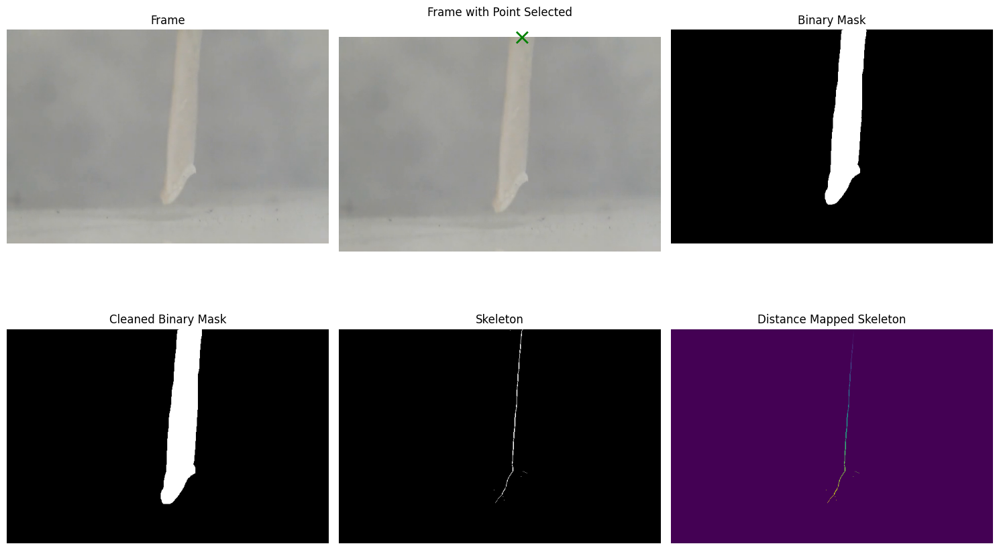

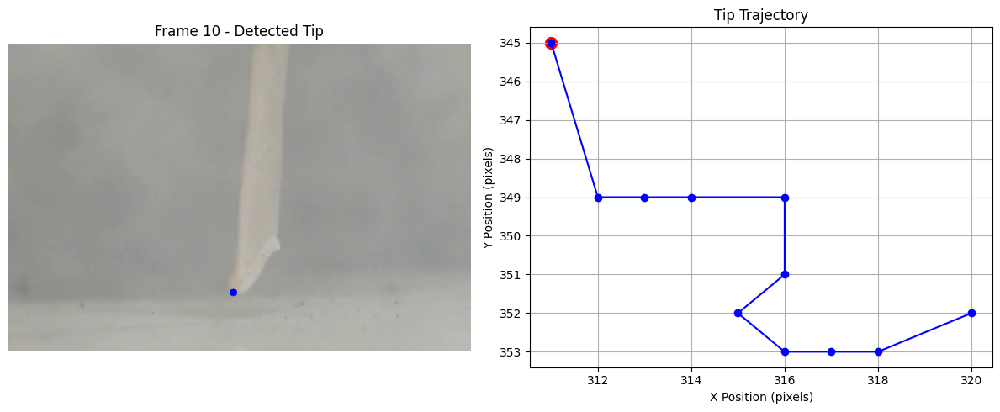


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 340.3ms
Speed: 4.8ms preprocess, 340.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 336.1ms
Speed: 3.1ms preprocess, 336.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 337.0ms
Speed: 3.1ms preprocess, 337.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 335.2ms
Speed: 3.5ms preprocess, 335.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 336.0ms
Speed: 3.1ms preprocess, 336.0

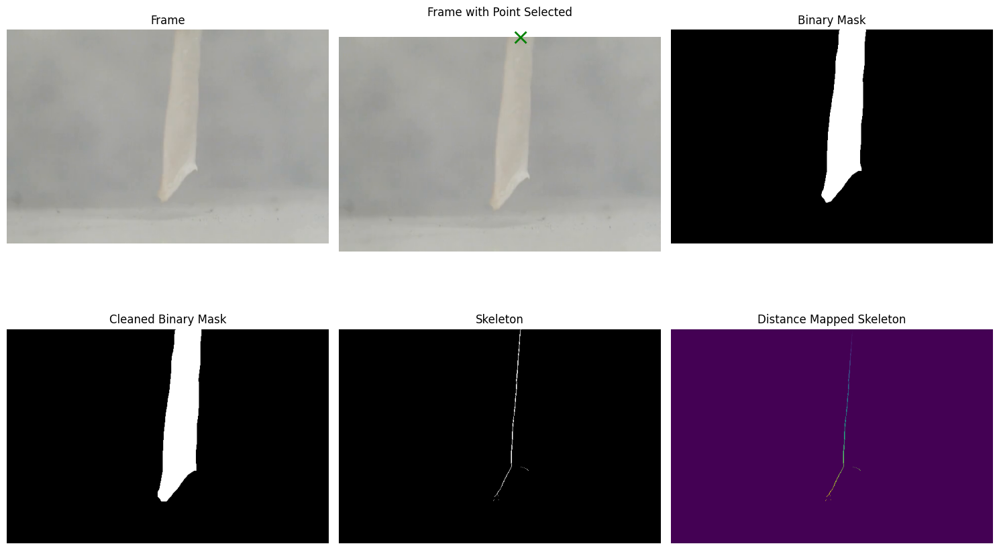

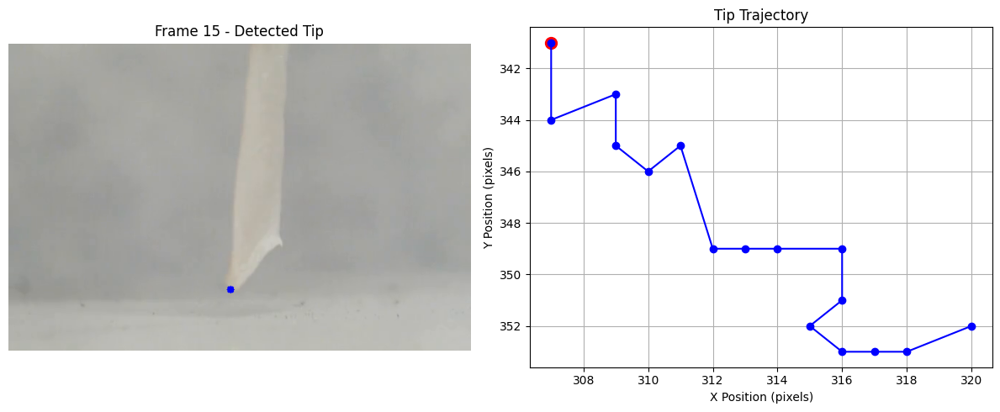


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 335.3ms
Speed: 5.0ms preprocess, 335.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 342.1ms
Speed: 3.0ms preprocess, 342.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 329.5ms
Speed: 3.1ms preprocess, 329.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 329.7ms
Speed: 3.0ms preprocess, 329.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 330.4ms
Speed: 3.1ms preprocess, 330.4

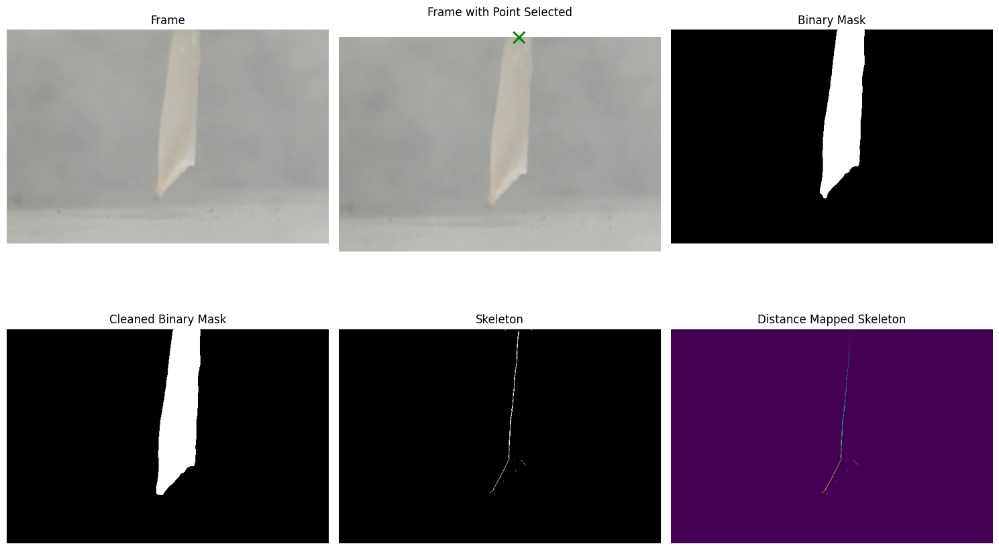

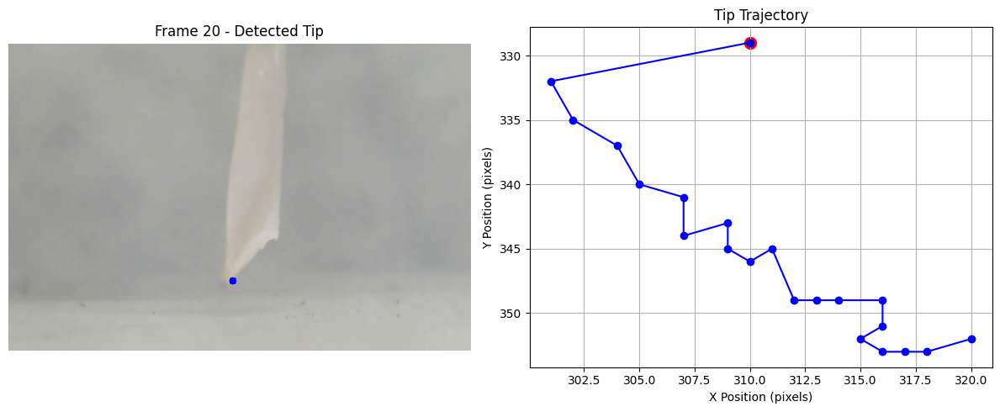


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 331.2ms
Speed: 5.0ms preprocess, 331.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 345.9ms
Speed: 3.0ms preprocess, 345.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 329.6ms
Speed: 3.1ms preprocess, 329.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 330.5ms
Speed: 3.0ms preprocess, 330.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 330.0ms
Speed: 3.2ms preprocess, 330.0

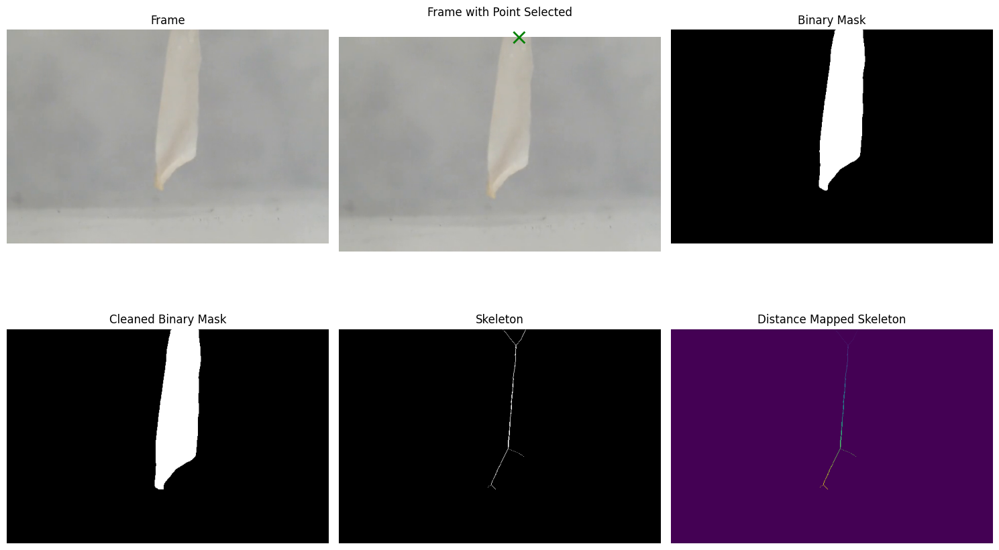

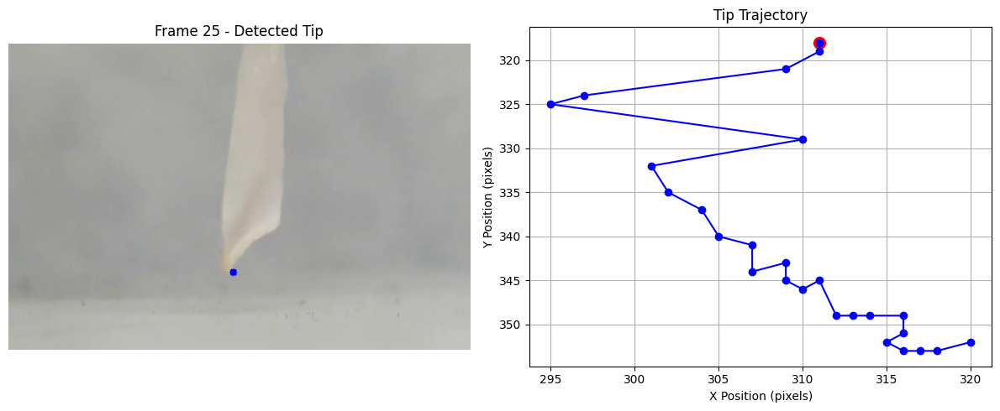


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 330.2ms
Speed: 5.2ms preprocess, 330.2ms inference, 0.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 329.5ms
Speed: 3.2ms preprocess, 329.5ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 330.1ms
Speed: 3.1ms preprocess, 330.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 330.1ms
Speed: 3.0ms preprocess, 330.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 330.1ms
Speed: 3.1ms preprocess, 330.1

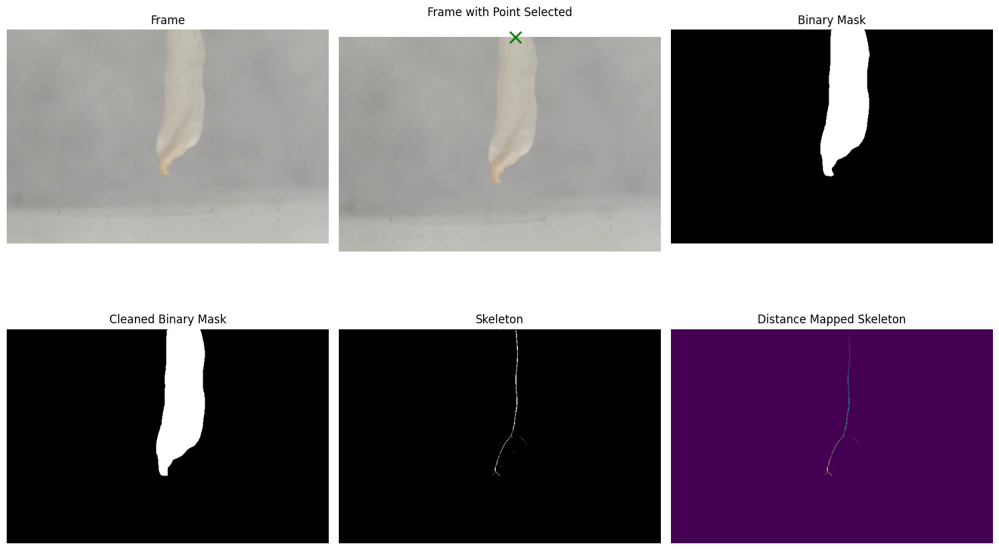

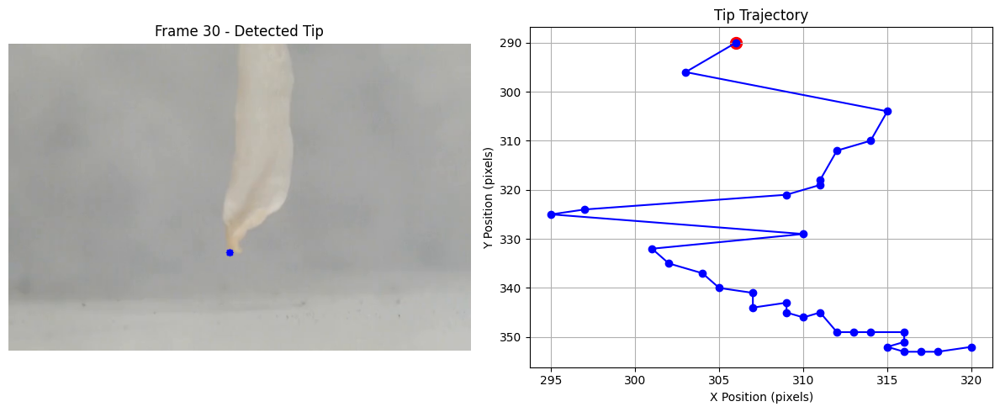


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 330.0ms
Speed: 4.8ms preprocess, 330.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_036.png: 1024x1024 1 0, 331.6ms
Speed: 3.1ms preprocess, 331.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_037.png: 1024x1024 1 0, 329.4ms
Speed: 3.1ms preprocess, 329.4ms inference, 0.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_038.png: 1024x1024 1 0, 332.1ms
Speed: 3.1ms preprocess, 332.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_039.png: 1024x1024 1 0, 332.4ms
Speed: 3.1ms preprocess, 332.4

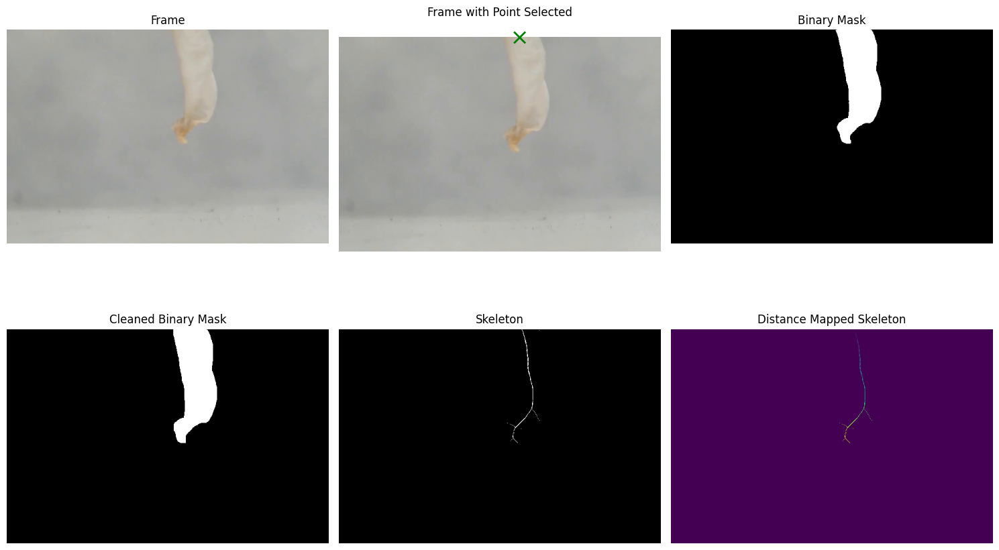

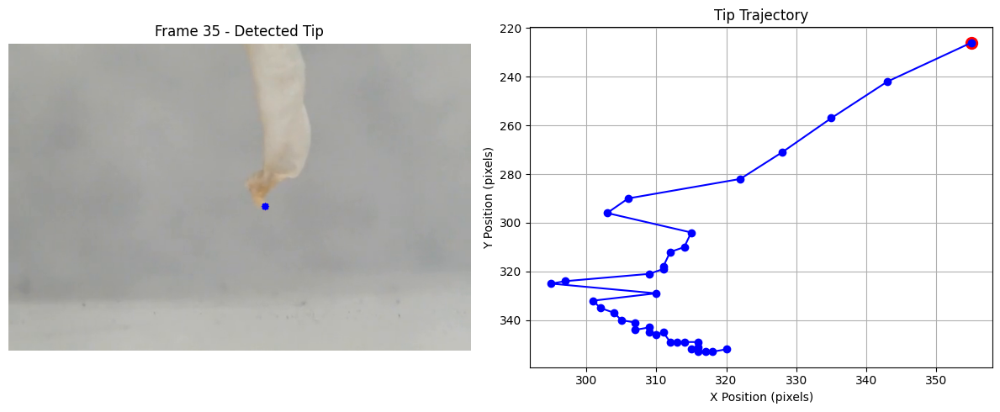


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_040.png: 1024x1024 1 0, 344.7ms
Speed: 4.9ms preprocess, 344.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_041.png: 1024x1024 1 0, 333.5ms
Speed: 3.3ms preprocess, 333.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_042.png: 1024x1024 1 0, 336.2ms
Speed: 3.1ms preprocess, 336.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_043.png: 1024x1024 1 0, 335.1ms
Speed: 3.2ms preprocess, 335.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_044.png: 1024x1024 1 0, 333.7ms
Speed: 3.2ms preprocess, 333.7

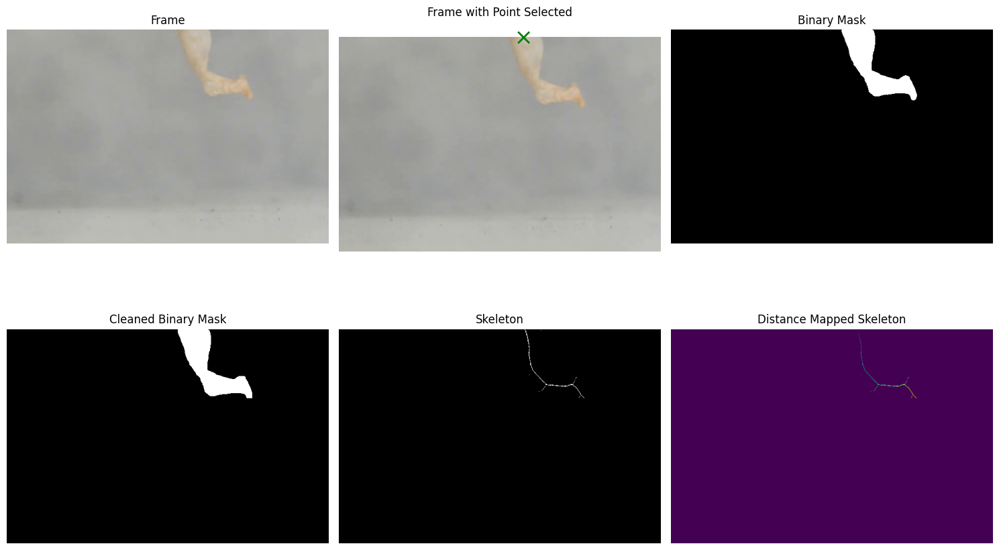

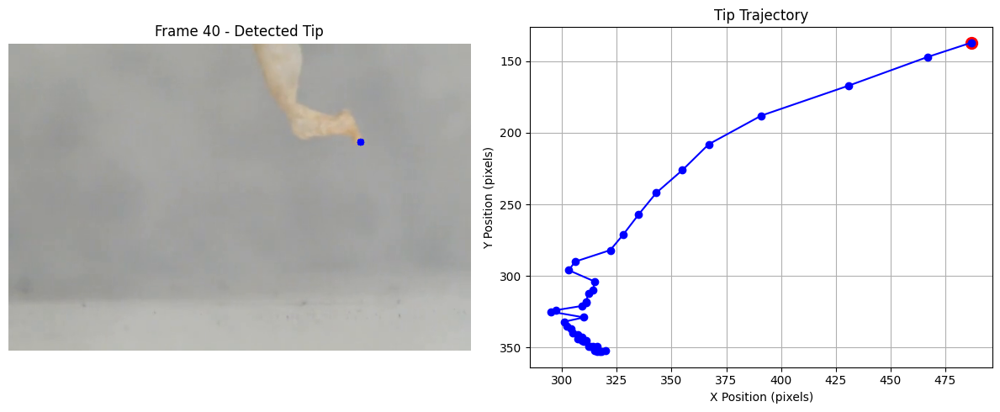

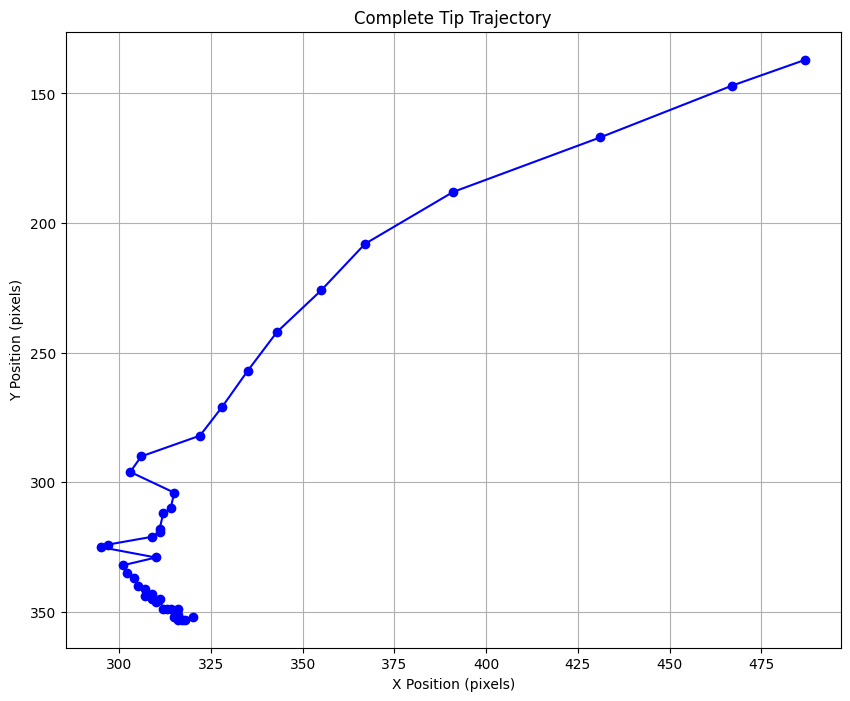

In [41]:
# Set paths
video_name = f"control_idx2_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 3
end_frame = 44
frame_interval=0.6
point = (345, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    edge_cushion =0
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

Analyzing frames 3 to 60
Total frames used: 58

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 335.7ms
Speed: 3.2ms preprocess, 335.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

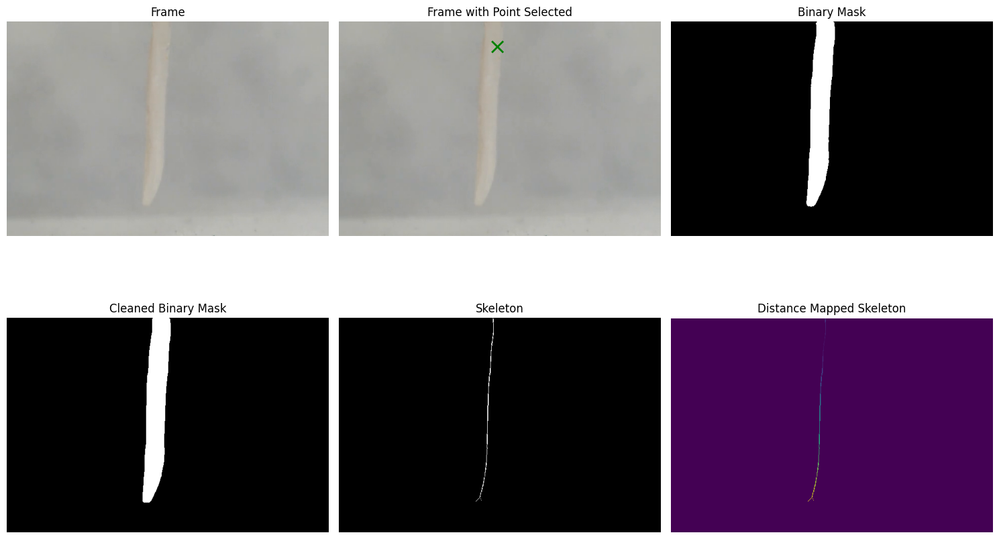

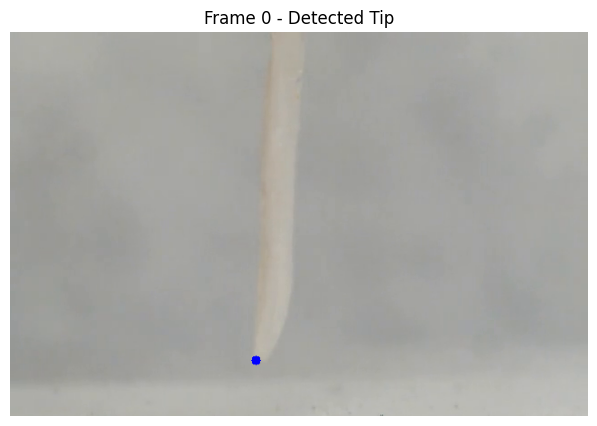


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 337.9ms
Speed: 5.0ms preprocess, 337.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 342.6ms
Speed: 3.1ms preprocess, 342.6ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 329.1ms
Speed: 4.3ms preprocess, 329.1ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 328.0ms
Speed: 3.2ms preprocess, 328.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 328.0ms
Speed: 3.0ms preprocess, 328.0

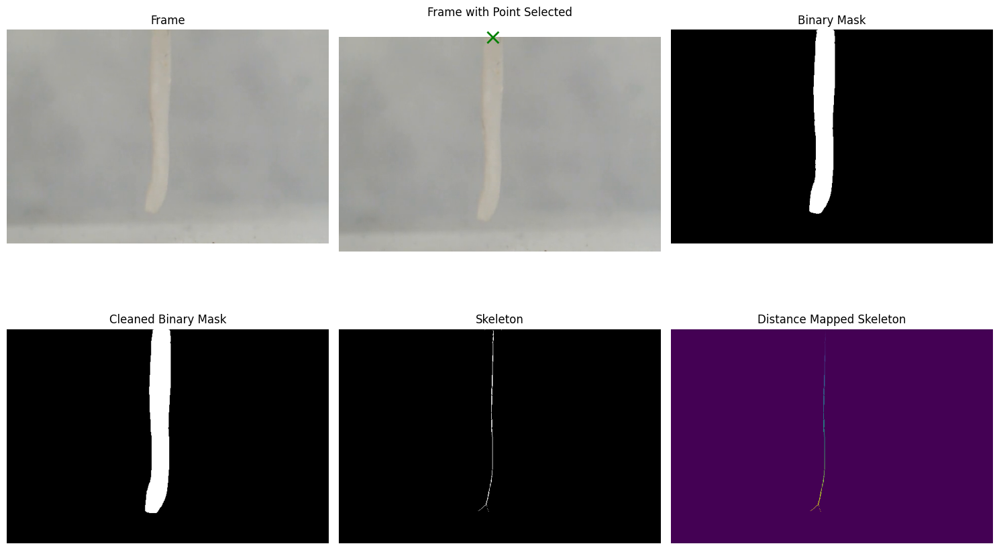

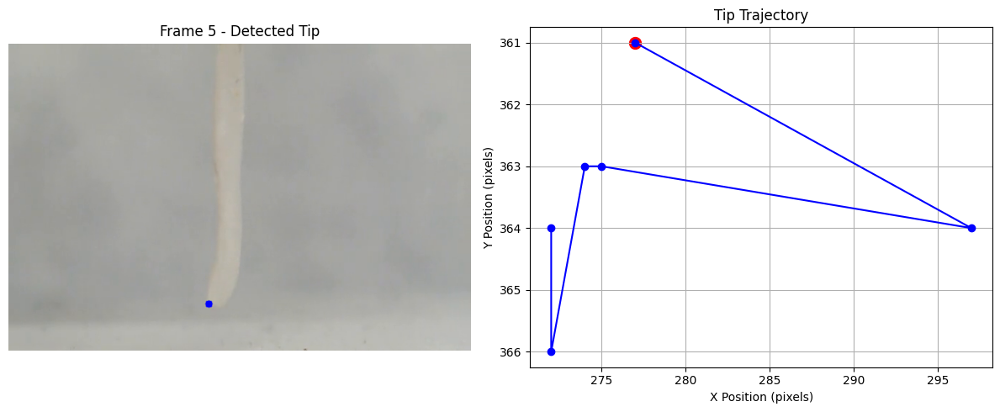


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 349.1ms
Speed: 4.9ms preprocess, 349.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 330.0ms
Speed: 3.1ms preprocess, 330.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 329.7ms
Speed: 3.1ms preprocess, 329.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 329.8ms
Speed: 3.1ms preprocess, 329.8ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 329.8ms
Speed: 3.1ms preprocess, 329.8

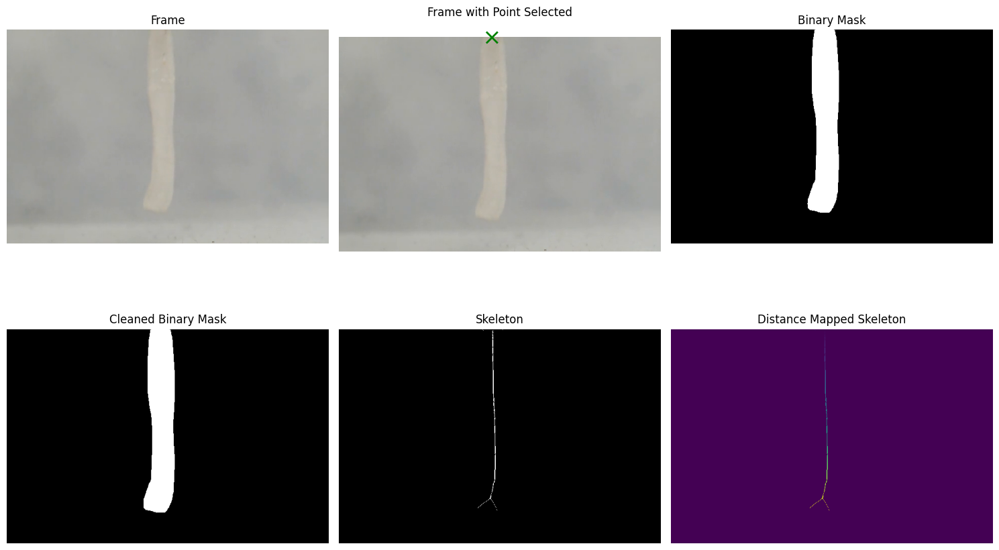

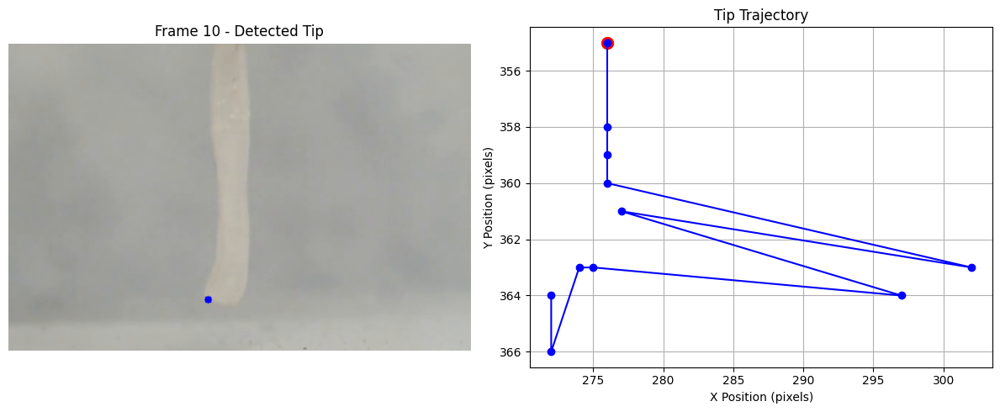


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 334.8ms
Speed: 4.9ms preprocess, 334.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 352.9ms
Speed: 3.0ms preprocess, 352.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 335.9ms
Speed: 3.0ms preprocess, 335.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 337.0ms
Speed: 3.1ms preprocess, 337.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 334.7ms
Speed: 3.1ms preprocess, 334.7

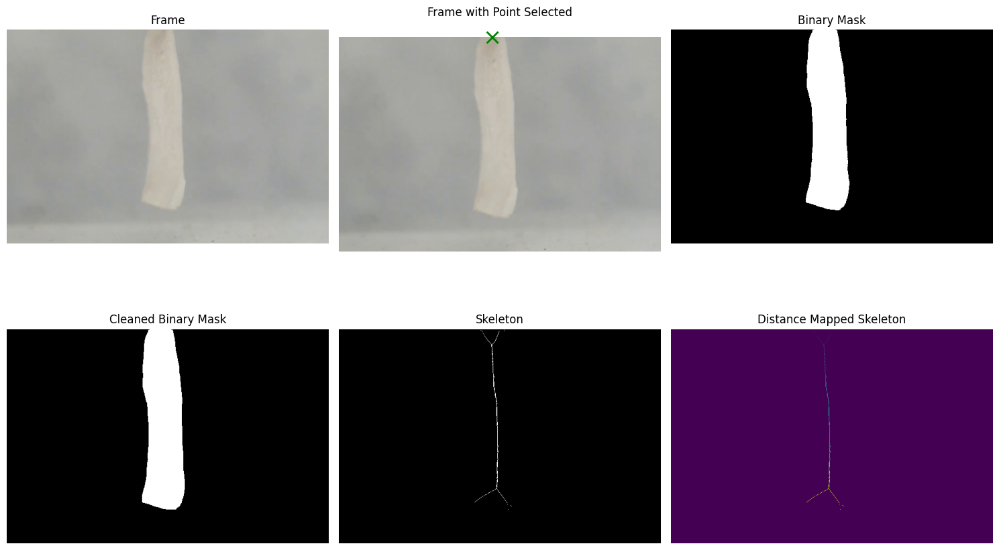

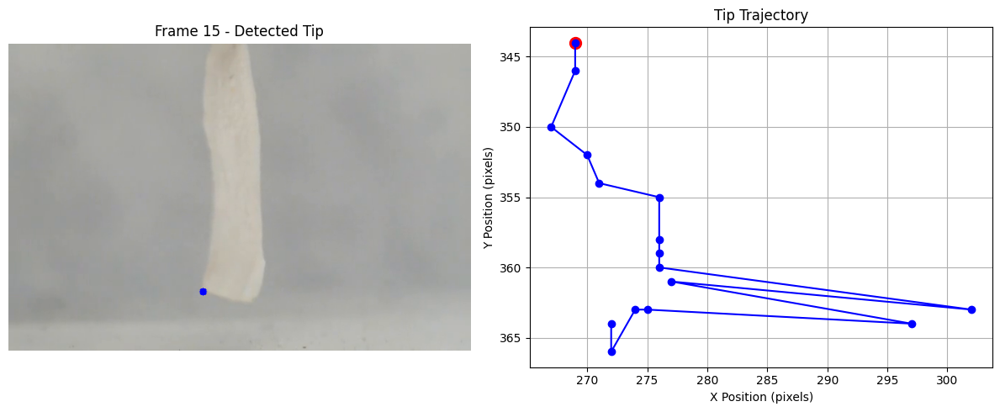


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 326.1ms
Speed: 4.9ms preprocess, 326.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 327.5ms
Speed: 3.1ms preprocess, 327.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 328.6ms
Speed: 2.9ms preprocess, 328.6ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 328.2ms
Speed: 3.1ms preprocess, 328.2ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 328.3ms
Speed: 3.0ms preprocess, 328.3

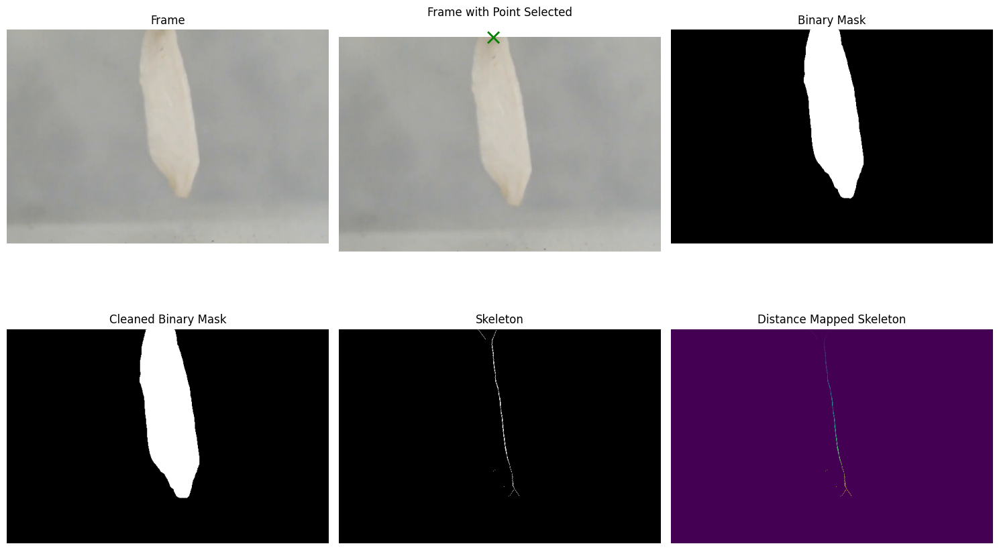

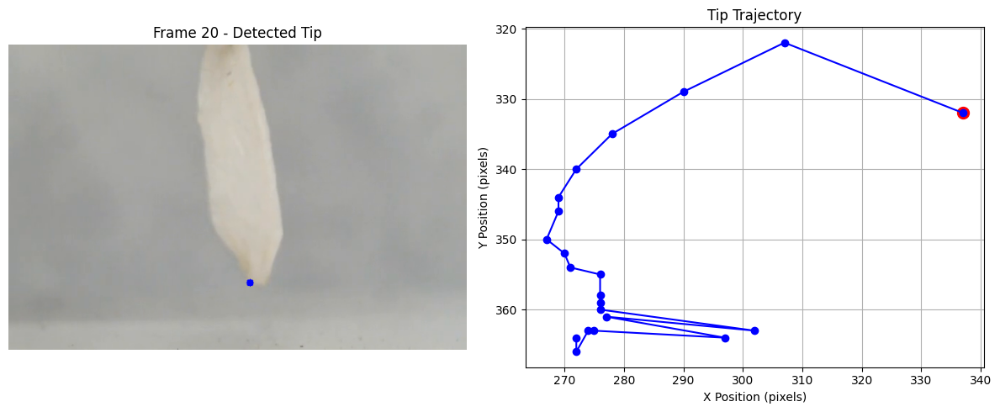


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 349.8ms
Speed: 5.0ms preprocess, 349.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 335.1ms
Speed: 3.0ms preprocess, 335.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 337.4ms
Speed: 3.6ms preprocess, 337.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 337.4ms
Speed: 3.0ms preprocess, 337.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 337.0ms
Speed: 3.1ms preprocess, 337.0

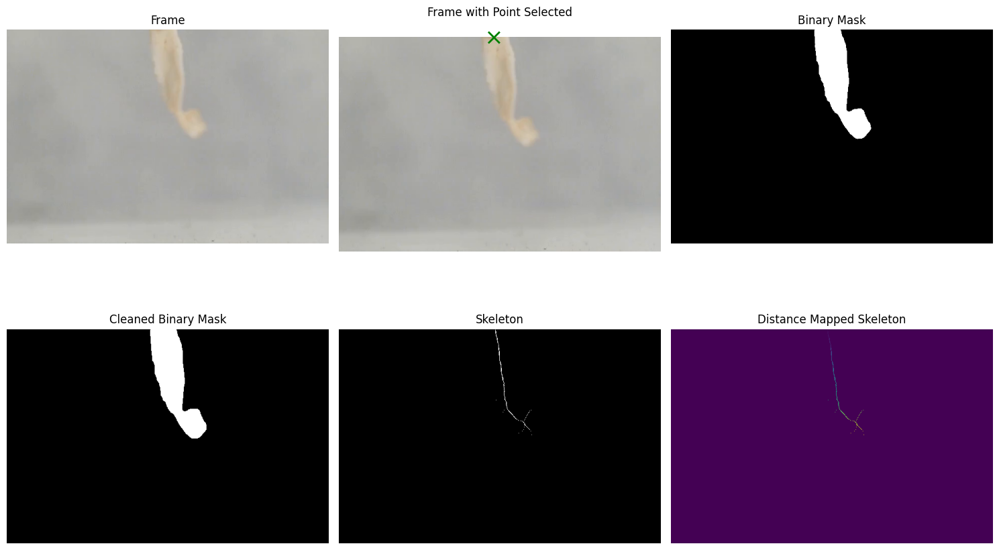

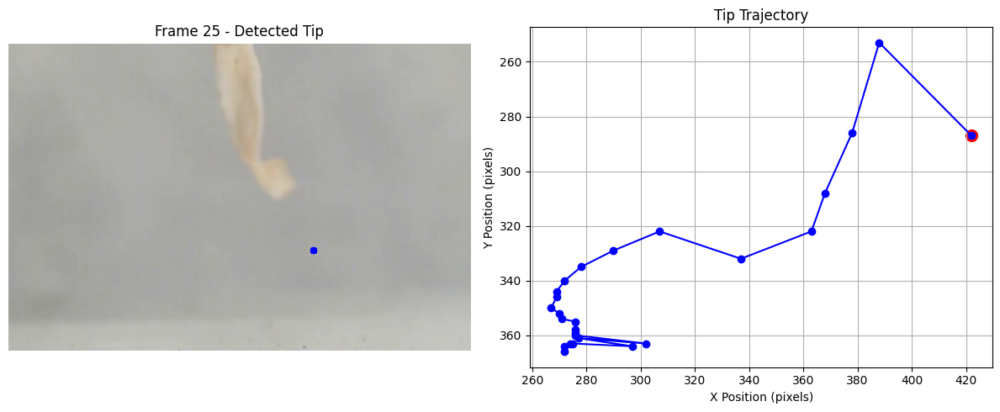


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 343.5ms
Speed: 4.9ms preprocess, 343.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 336.7ms
Speed: 3.0ms preprocess, 336.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 336.5ms
Speed: 3.0ms preprocess, 336.5ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 335.0ms
Speed: 3.0ms preprocess, 335.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 337.2ms
Speed: 3.0ms preprocess, 337.2

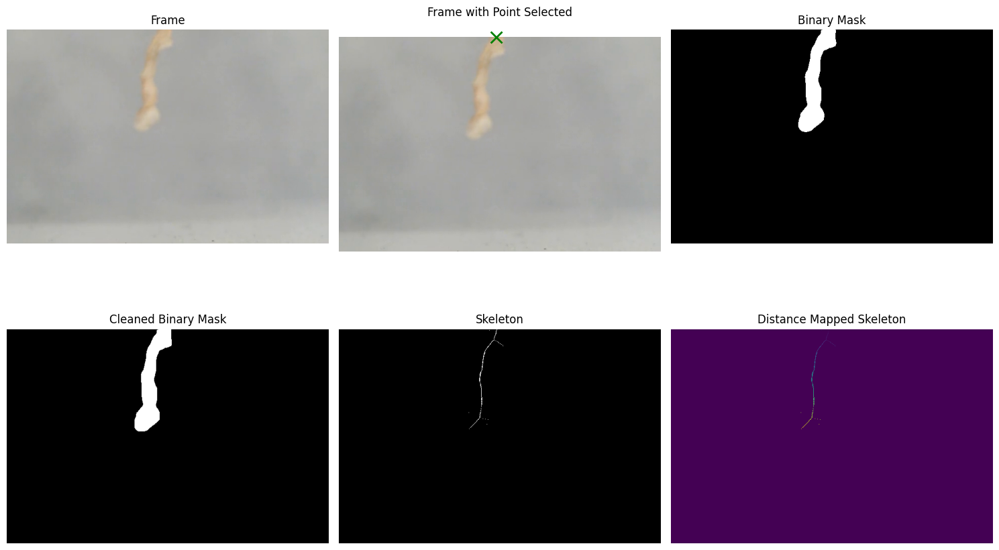

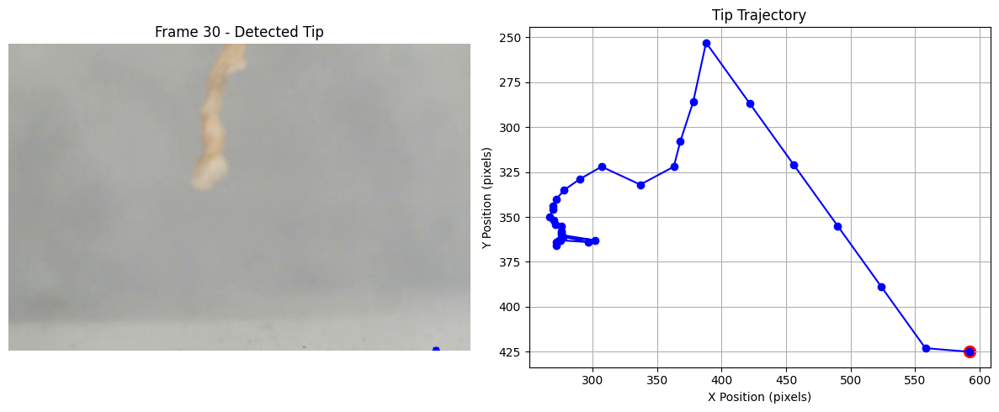


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 333.8ms
Speed: 5.0ms preprocess, 333.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_036.png: 1024x1024 1 0, 345.9ms
Speed: 3.0ms preprocess, 345.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_037.png: 1024x1024 1 0, 333.5ms
Speed: 3.0ms preprocess, 333.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_038.png: 1024x1024 1 0, 333.5ms
Speed: 2.9ms preprocess, 333.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_039.png: 1024x1024 1 0, 334.3ms
Speed: 3.0ms preprocess, 334.3

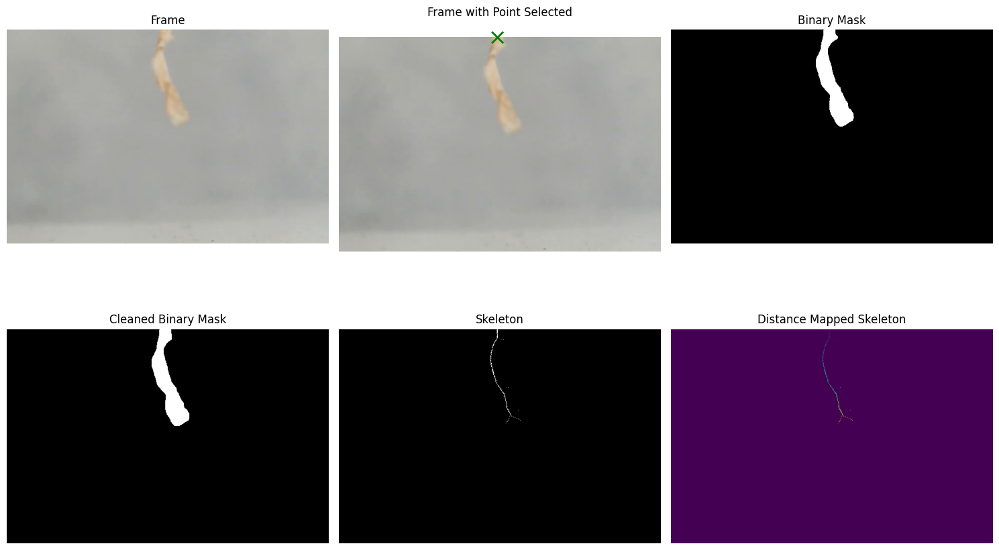

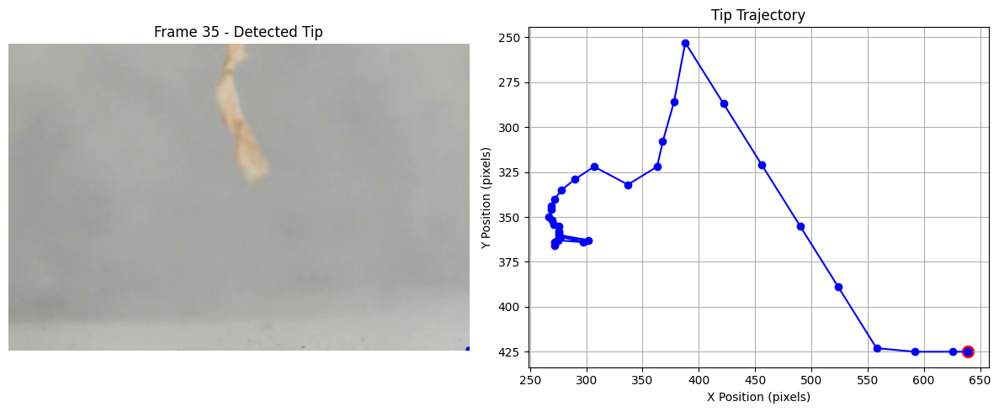


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_040.png: 1024x1024 1 0, 335.3ms
Speed: 4.9ms preprocess, 335.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_041.png: 1024x1024 1 0, 347.3ms
Speed: 3.1ms preprocess, 347.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_042.png: 1024x1024 1 0, 336.4ms
Speed: 2.9ms preprocess, 336.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_043.png: 1024x1024 1 0, 334.8ms
Speed: 3.0ms preprocess, 334.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_044.png: 1024x1024 1 0, 336.2ms
Speed: 3.2ms preprocess, 336.2

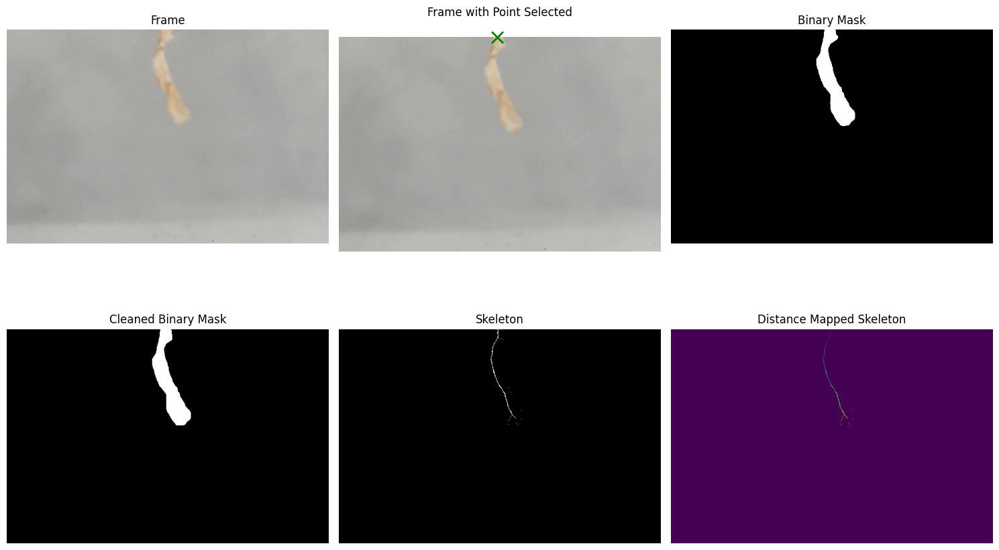

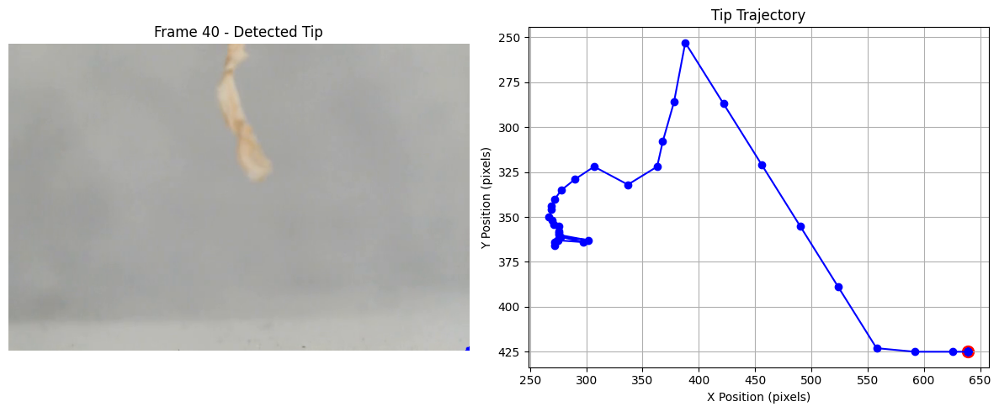


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_045.png: 1024x1024 1 0, 331.6ms
Speed: 4.8ms preprocess, 331.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_046.png: 1024x1024 1 0, 329.9ms
Speed: 12.1ms preprocess, 329.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_047.png: 1024x1024 1 0, 329.4ms
Speed: 2.9ms preprocess, 329.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_048.png: 1024x1024 1 0, 329.5ms
Speed: 3.0ms preprocess, 329.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_049.png: 1024x1024 1 0, 329.7ms
Speed: 3.0ms preprocess, 329.

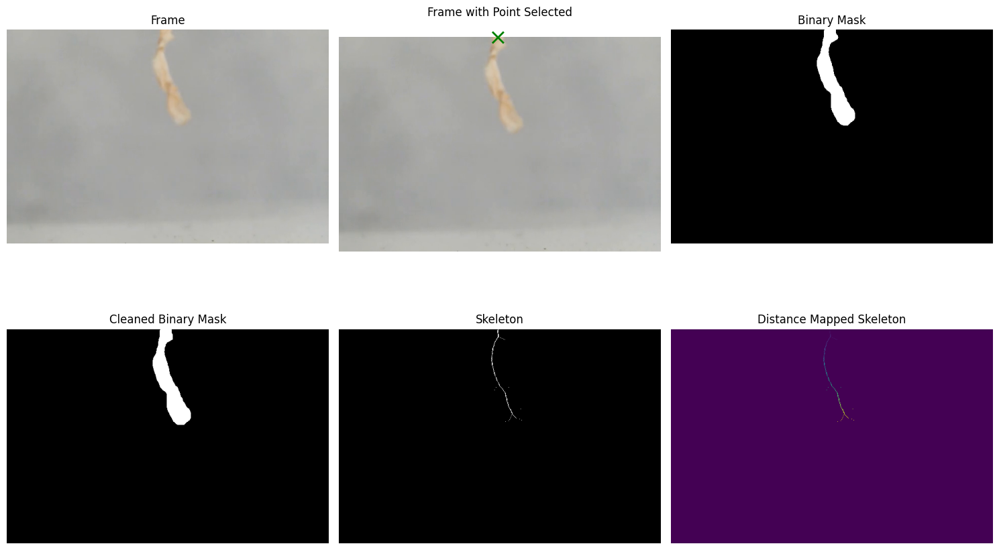

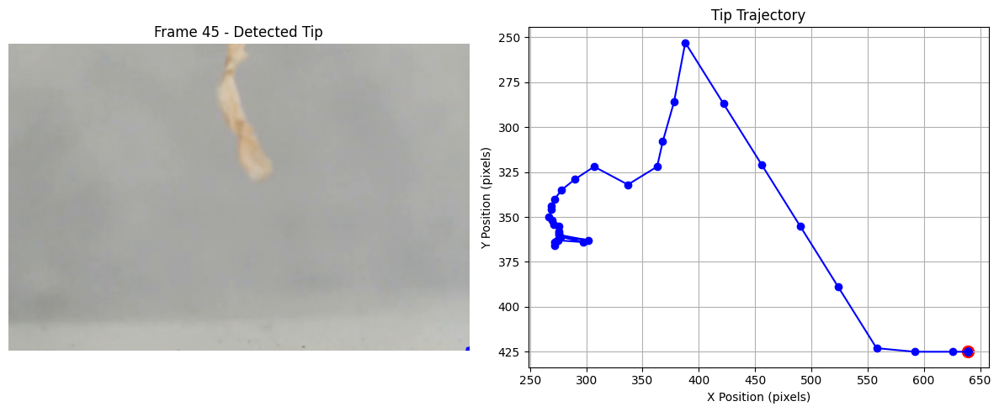


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_050.png: 1024x1024 1 0, 336.0ms
Speed: 4.9ms preprocess, 336.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_051.png: 1024x1024 1 0, 351.4ms
Speed: 3.2ms preprocess, 351.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_052.png: 1024x1024 1 0, 334.1ms
Speed: 3.1ms preprocess, 334.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_053.png: 1024x1024 1 0, 335.0ms
Speed: 3.1ms preprocess, 335.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_054.png: 1024x1024 1 0, 334.9ms
Speed: 3.2ms preprocess, 334.9

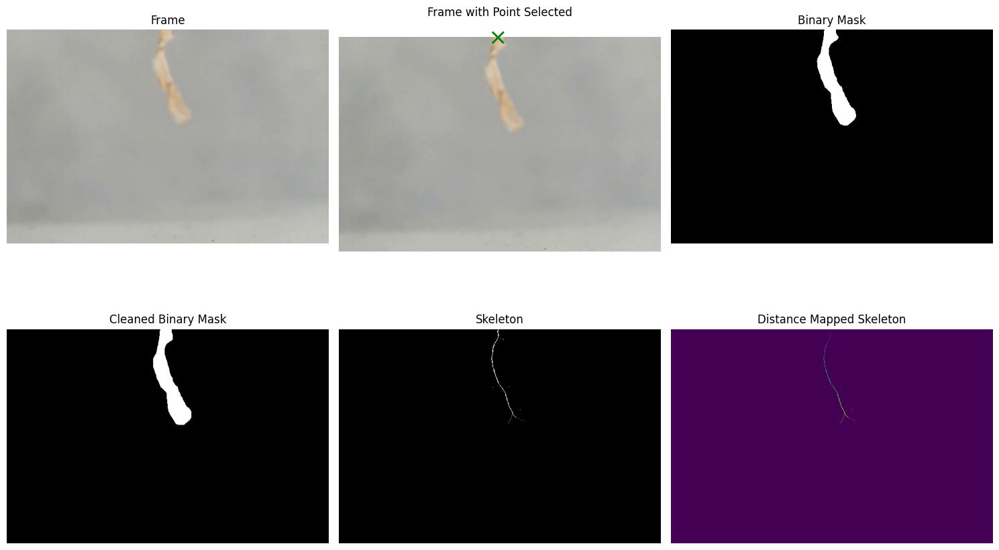

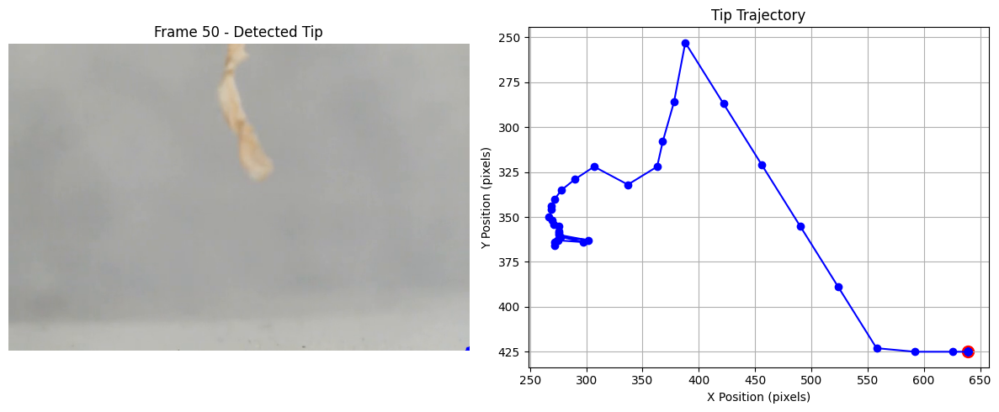


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_055.png: 1024x1024 1 0, 340.4ms
Speed: 10.1ms preprocess, 340.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_056.png: 1024x1024 1 0, 351.4ms
Speed: 3.2ms preprocess, 351.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_057.png: 1024x1024 1 0, 337.8ms
Speed: 3.1ms preprocess, 337.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_058.png: 1024x1024 1 0, 335.1ms
Speed: 3.1ms preprocess, 335.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_059.png: 1024x1024 1 0, 335.4ms
Speed: 3.1ms preprocess, 335.

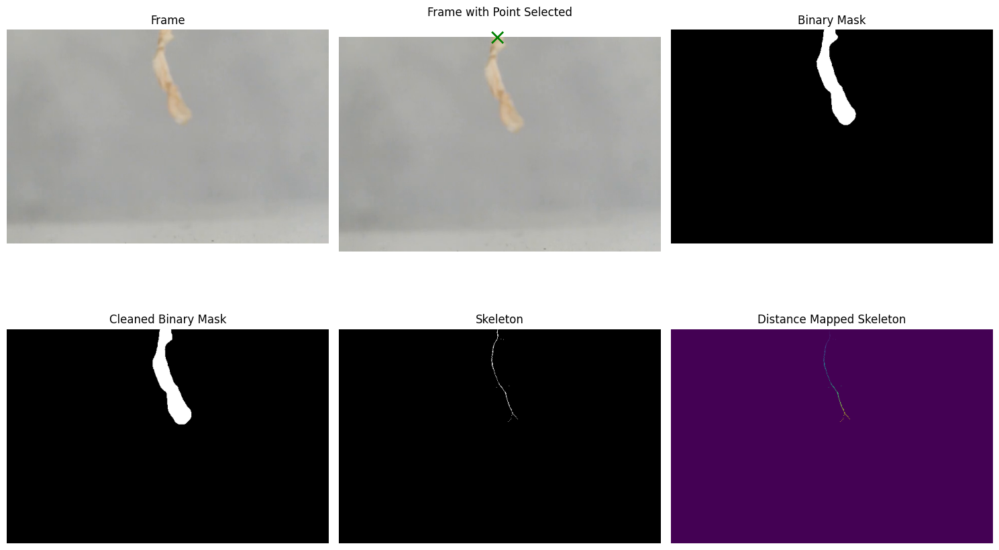

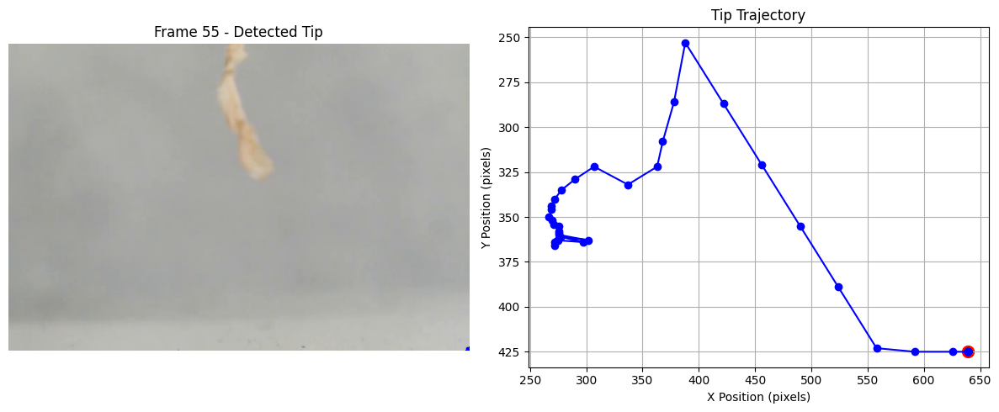


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_060.png: 1024x1024 1 0, 329.5ms
Speed: 4.9ms preprocess, 329.5ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_061.png: 1024x1024 1 0, 332.9ms
Speed: 13.9ms preprocess, 332.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


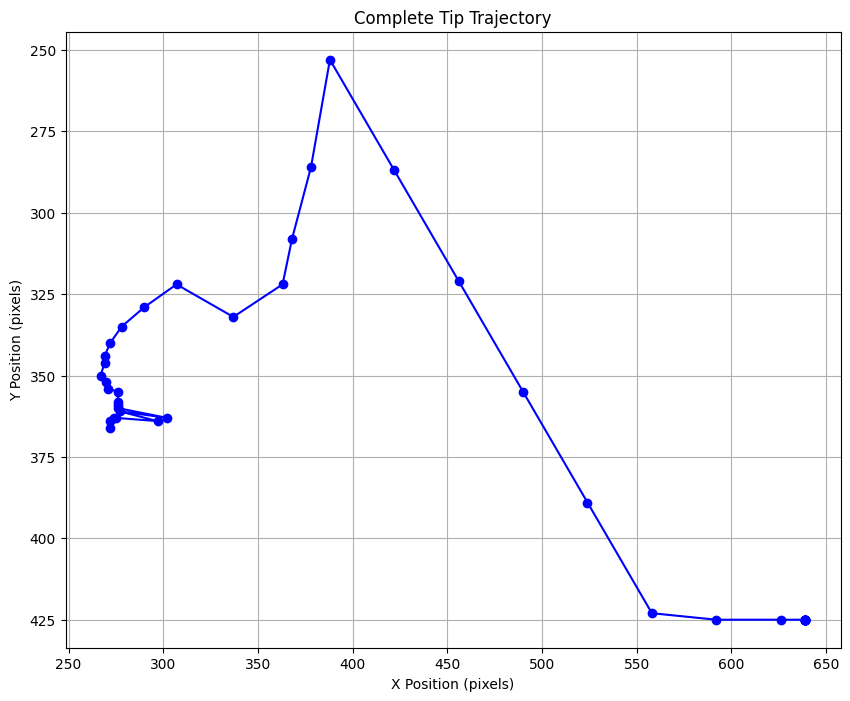

In [42]:
# Set paths
video_name = f"control_idx3_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 3
end_frame = None
frame_interval=0.6
point = (315, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    maximum_tip_travel_between_frames = 70,
    edge_cushion =0,
    tip_margin=40
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

Analyzing frames 0 to 43
Total frames used: 44



ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_001.png: 1024x1024 1 0, 359.6ms
Speed: 3.1ms preprocess, 359.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

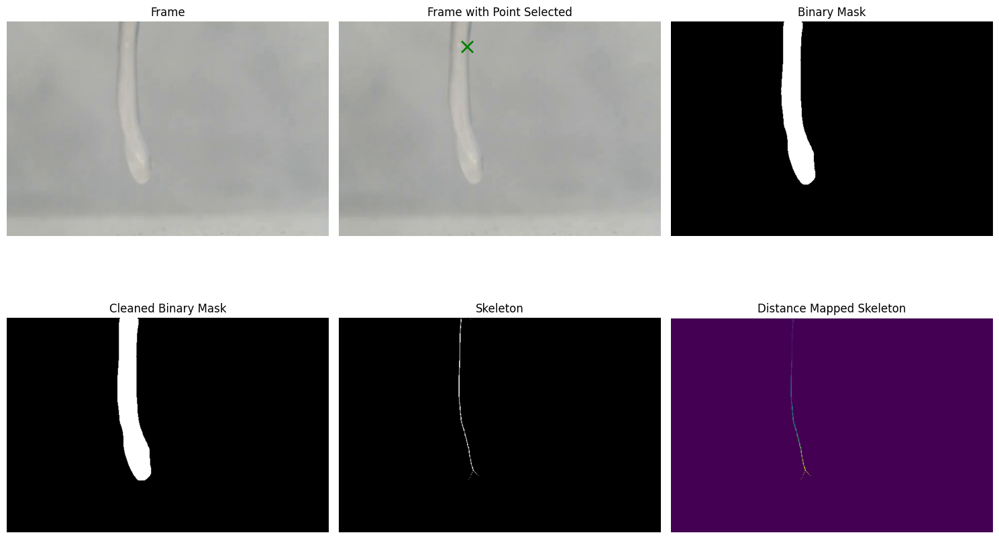

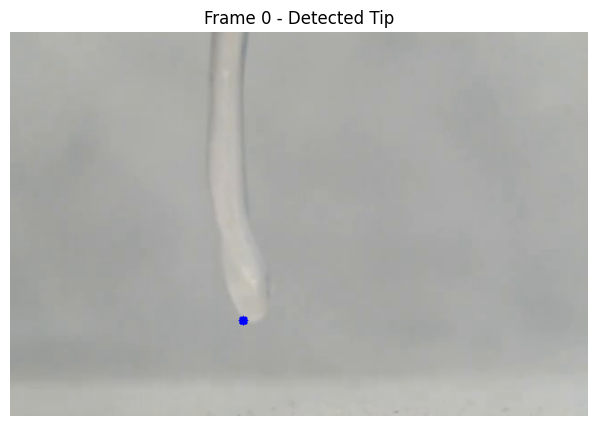


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_002.png: 1024x1024 1 0, 333.4ms
Speed: 4.9ms preprocess, 333.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_003.png: 1024x1024 1 0, 332.2ms
Speed: 10.6ms preprocess, 332.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 329.0ms
Speed: 3.1ms preprocess, 329.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 328.3ms
Speed: 3.1ms preprocess, 328.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 330.9ms
Speed: 3.1ms preprocess, 330.

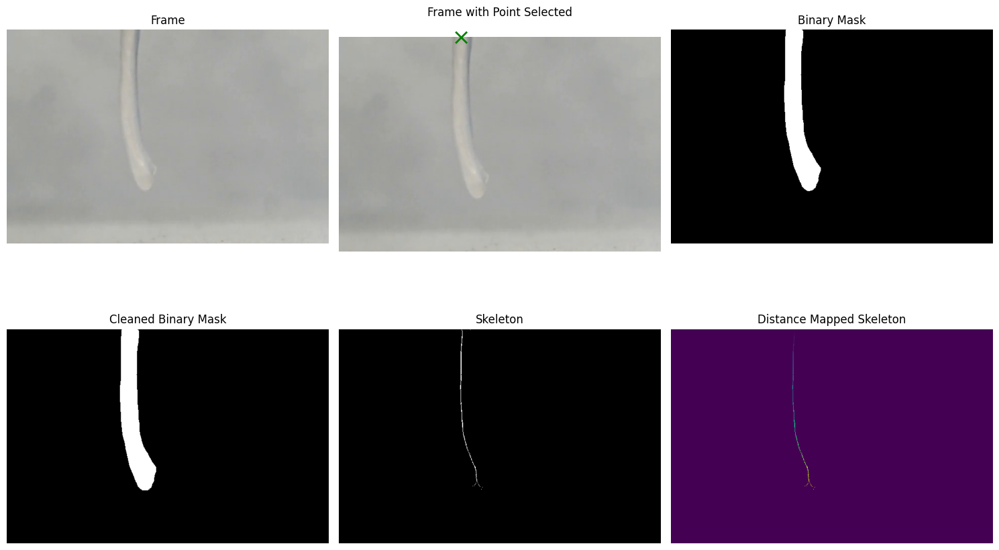

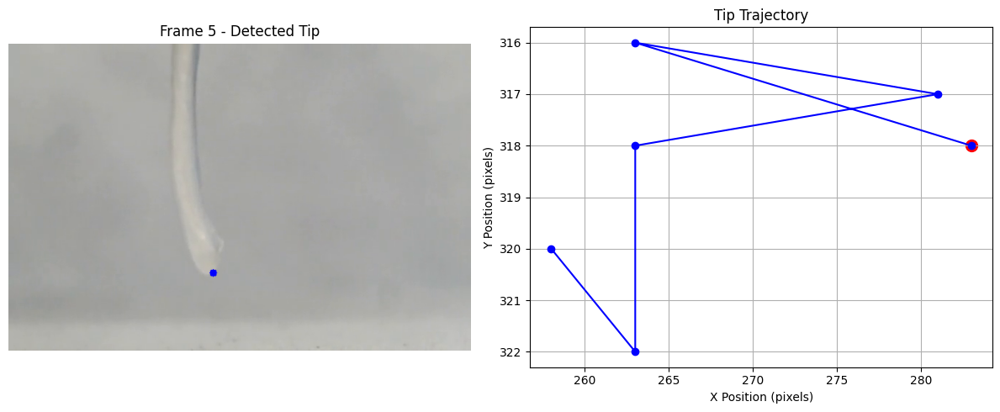


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 330.7ms
Speed: 4.9ms preprocess, 330.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 345.6ms
Speed: 3.1ms preprocess, 345.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 336.0ms
Speed: 3.0ms preprocess, 336.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 335.0ms
Speed: 3.0ms preprocess, 335.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 336.0ms
Speed: 3.0ms preprocess, 336.0

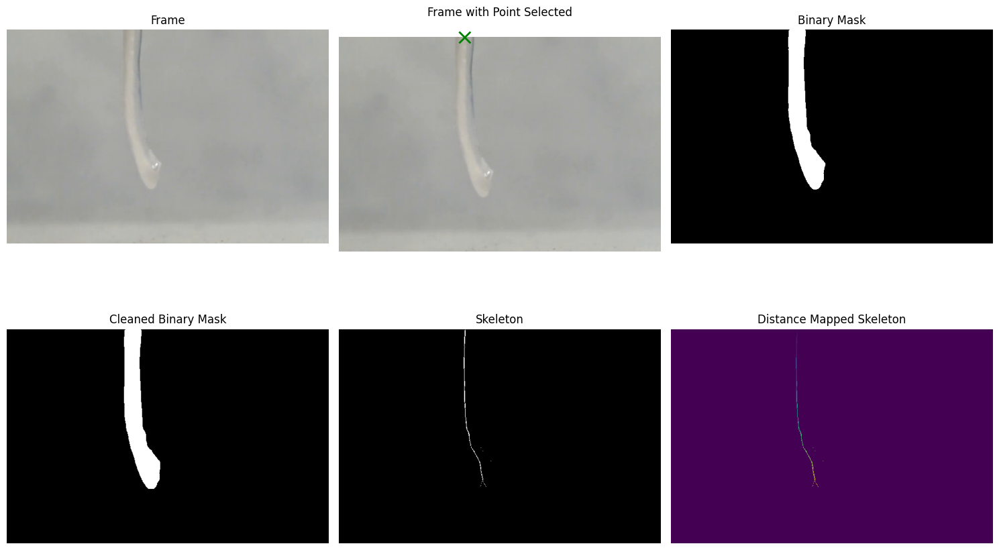

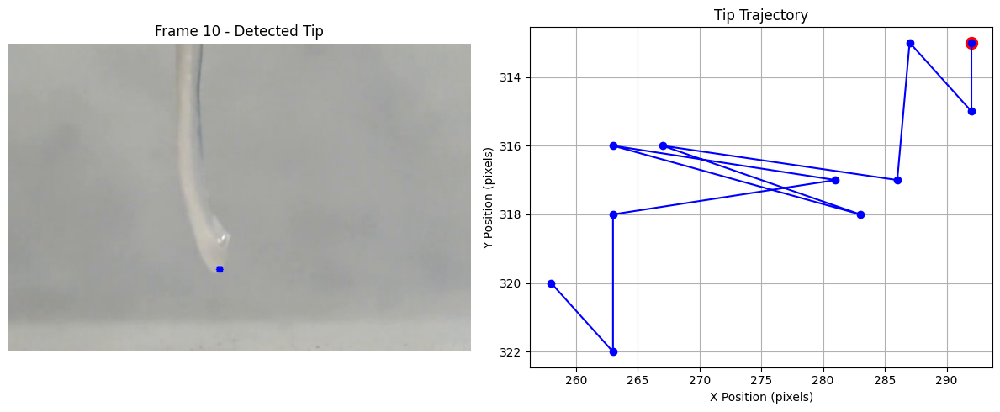


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 342.9ms
Speed: 4.7ms preprocess, 342.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 336.0ms
Speed: 3.0ms preprocess, 336.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 336.7ms
Speed: 3.0ms preprocess, 336.7ms inference, 0.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 336.2ms
Speed: 3.1ms preprocess, 336.2ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 336.2ms
Speed: 3.0ms preprocess, 336.2

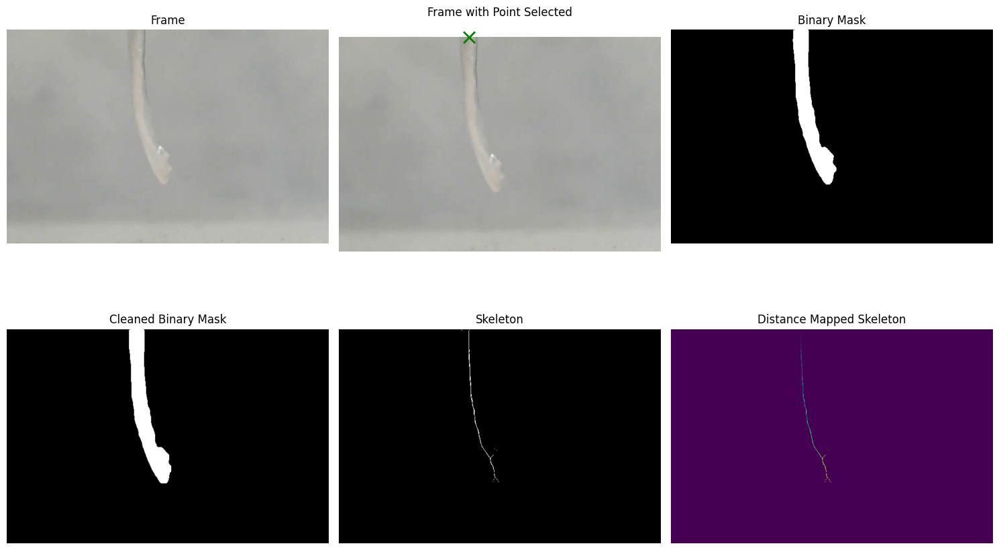

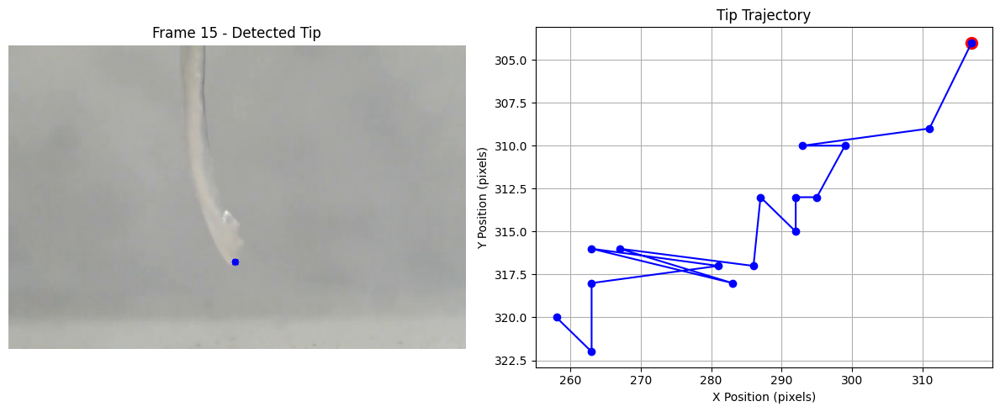


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 342.8ms
Speed: 3.1ms preprocess, 342.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 349.2ms
Speed: 3.1ms preprocess, 349.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 329.4ms
Speed: 3.2ms preprocess, 329.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 330.5ms
Speed: 3.7ms preprocess, 330.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 330.0ms
Speed: 3.6ms preprocess, 330.0

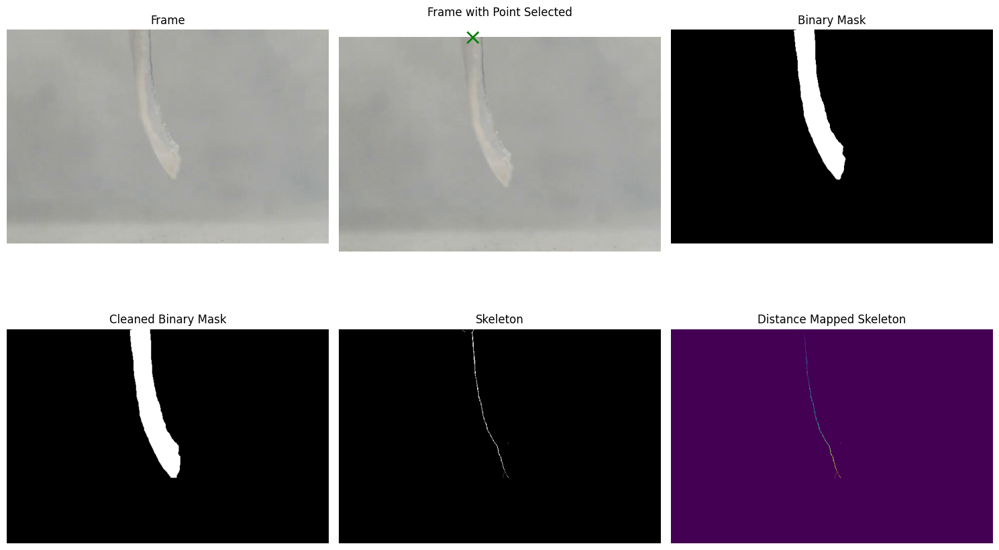

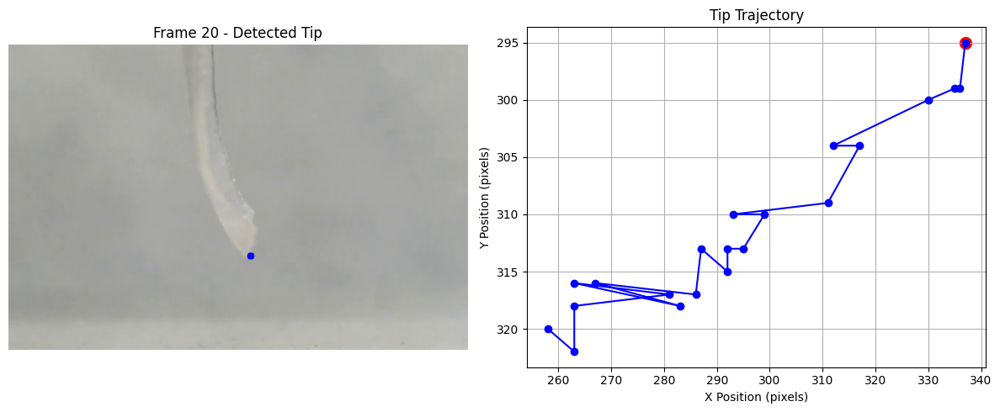


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 335.3ms
Speed: 4.8ms preprocess, 335.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 340.5ms
Speed: 3.1ms preprocess, 340.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 348.7ms
Speed: 3.1ms preprocess, 348.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 334.9ms
Speed: 3.1ms preprocess, 334.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 338.4ms
Speed: 3.1ms preprocess, 338.4

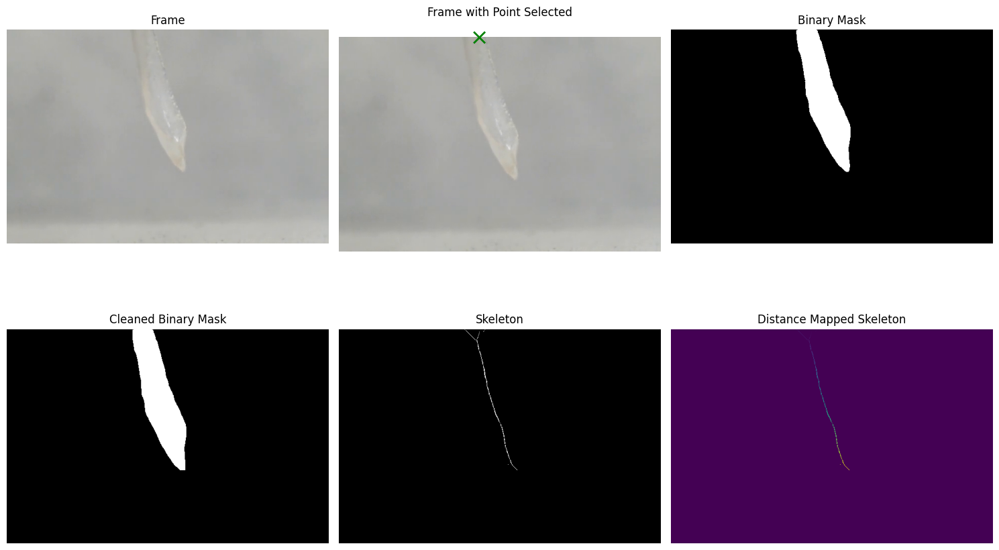

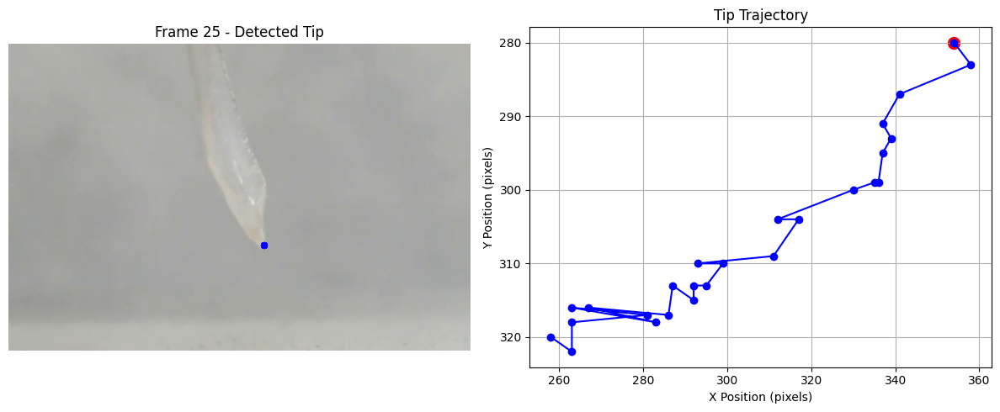


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 335.5ms
Speed: 5.0ms preprocess, 335.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 342.6ms
Speed: 2.9ms preprocess, 342.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 331.9ms
Speed: 2.9ms preprocess, 331.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 334.6ms
Speed: 3.0ms preprocess, 334.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 331.6ms
Speed: 3.0ms preprocess, 331.6

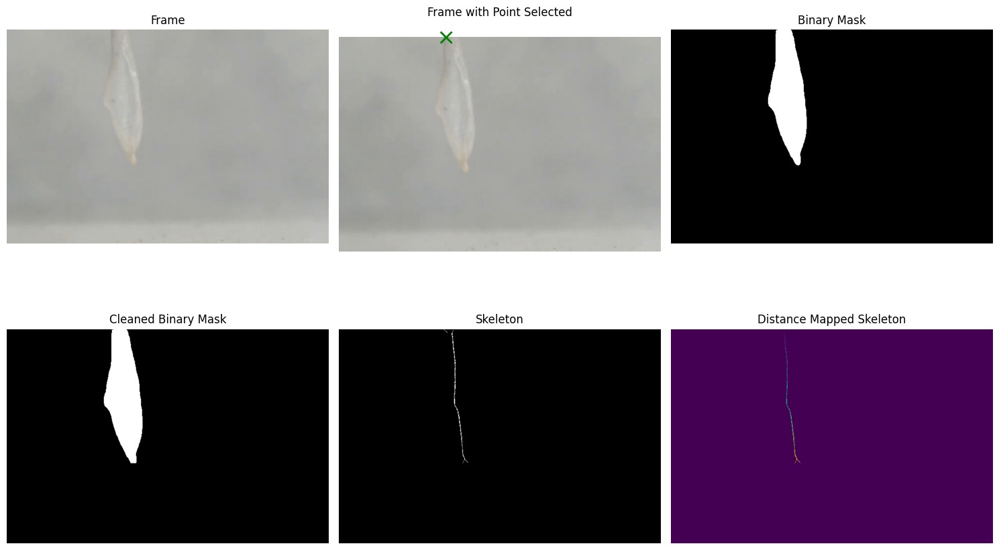

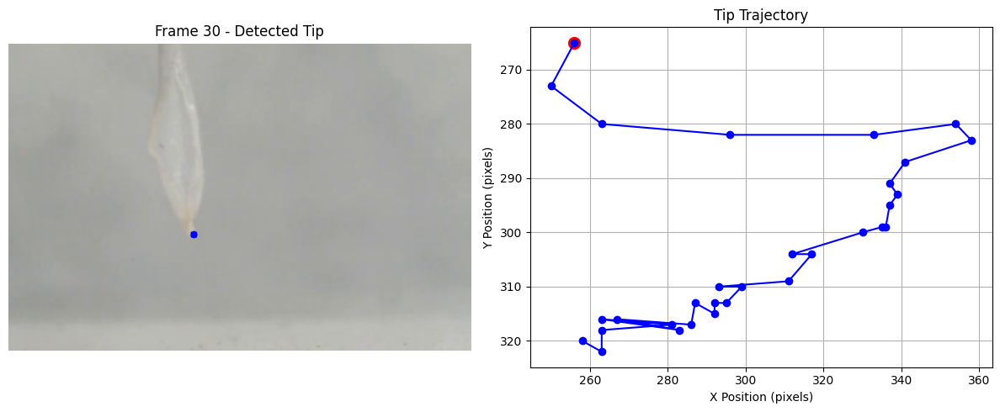


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 339.6ms
Speed: 4.8ms preprocess, 339.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 341.9ms
Speed: 3.4ms preprocess, 341.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 331.5ms
Speed: 3.0ms preprocess, 331.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 333.7ms
Speed: 3.0ms preprocess, 333.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_036.png: 1024x1024 1 0, 332.0ms
Speed: 3.1ms preprocess, 332.0

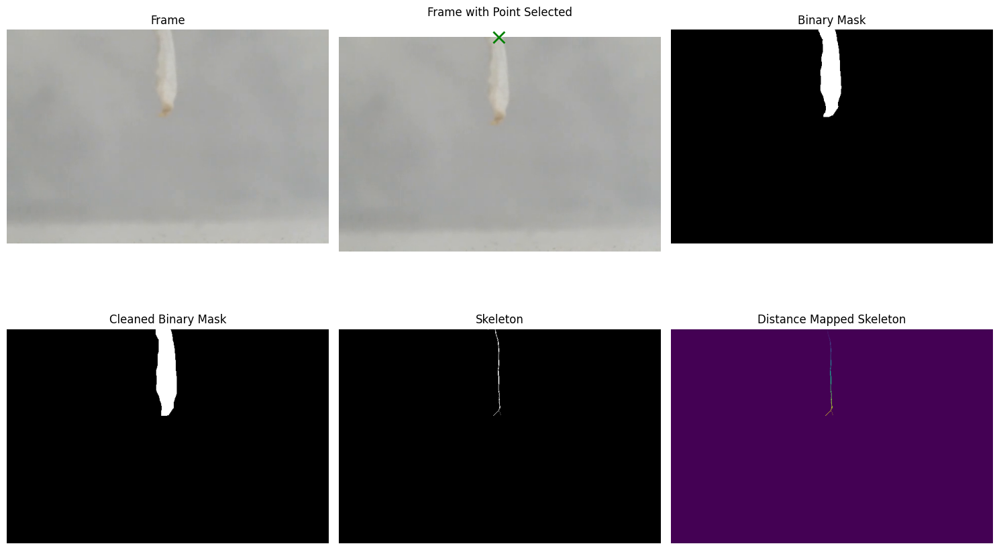

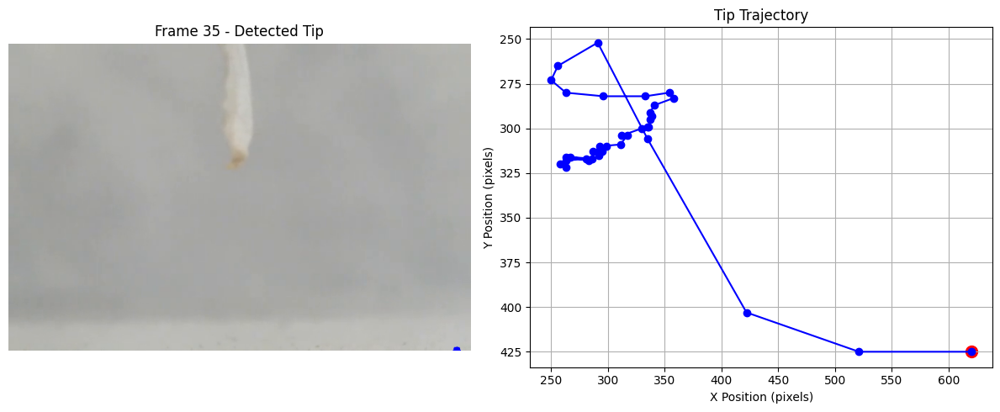


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_037.png: 1024x1024 1 0, 329.6ms
Speed: 4.8ms preprocess, 329.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_038.png: 1024x1024 1 0, 341.8ms
Speed: 3.0ms preprocess, 341.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_039.png: 1024x1024 1 0, 332.4ms
Speed: 3.0ms preprocess, 332.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_040.png: 1024x1024 1 0, 334.5ms
Speed: 3.1ms preprocess, 334.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_041.png: 1024x1024 1 0, 333.5ms
Speed: 3.1ms preprocess, 333.5

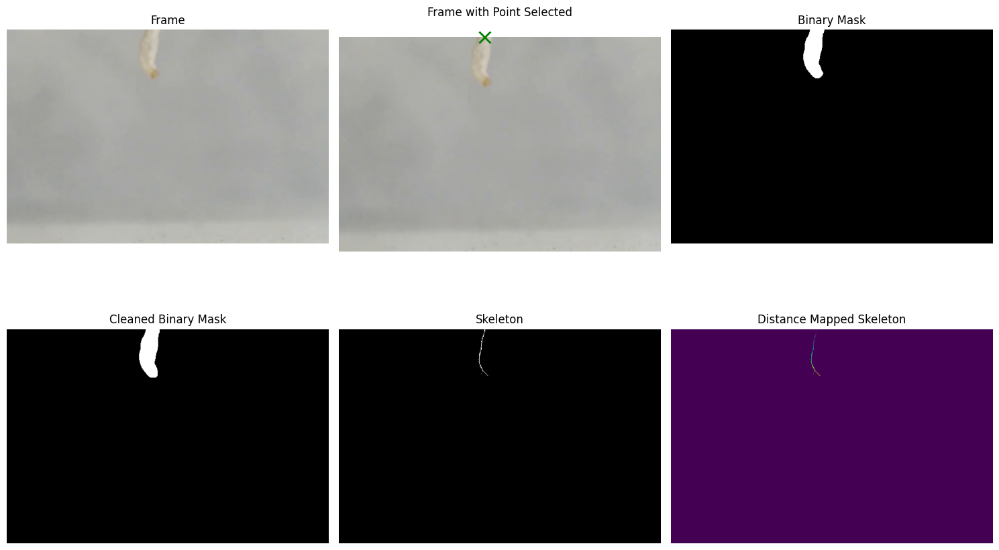

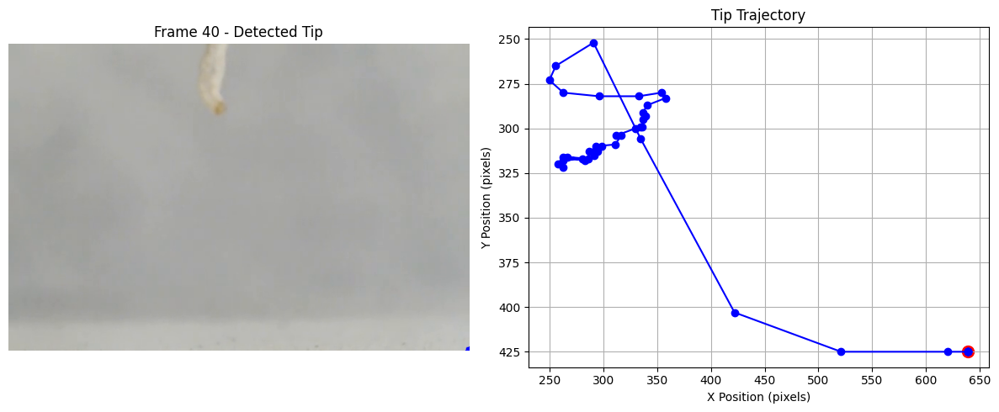


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_042.png: 1024x1024 1 0, 328.9ms
Speed: 4.8ms preprocess, 328.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_043.png: 1024x1024 1 0, 344.7ms
Speed: 3.1ms preprocess, 344.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_044.png: 1024x1024 1 0, 330.1ms
Speed: 3.2ms preprocess, 330.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


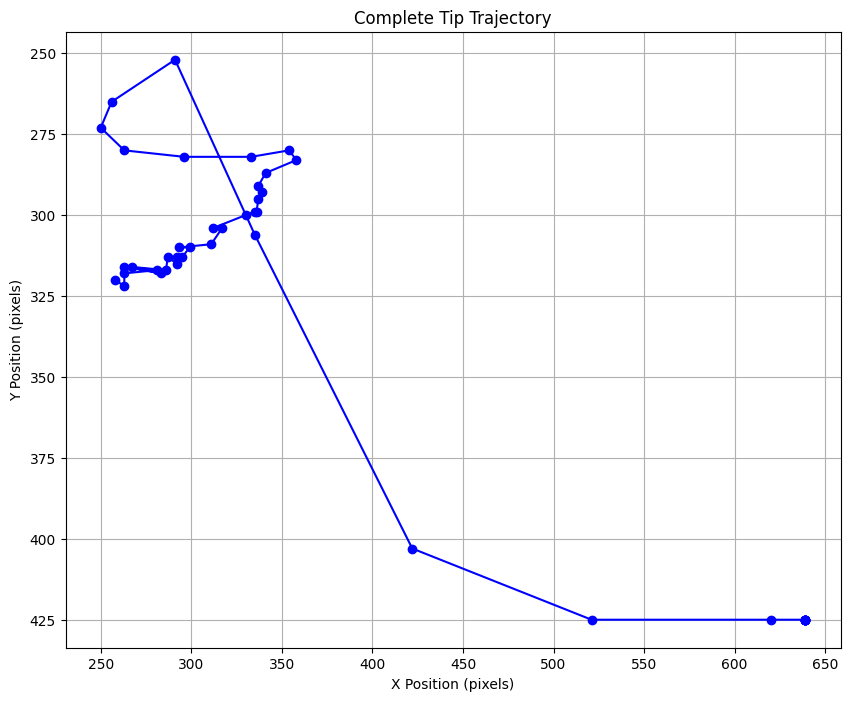

In [43]:
# Set paths
video_name = f"control_idx4_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 0
end_frame = None
frame_interval=0.6
point = (255, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    maximum_tip_travel_between_frames = 200,
    edge_cushion =0,
    tip_margin=40,
    debug=False
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

Analyzing frames 0 to 34
Total frames used: 35



ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_001.png: 1024x1024 1 0, 330.3ms
Speed: 3.3ms preprocess, 330.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

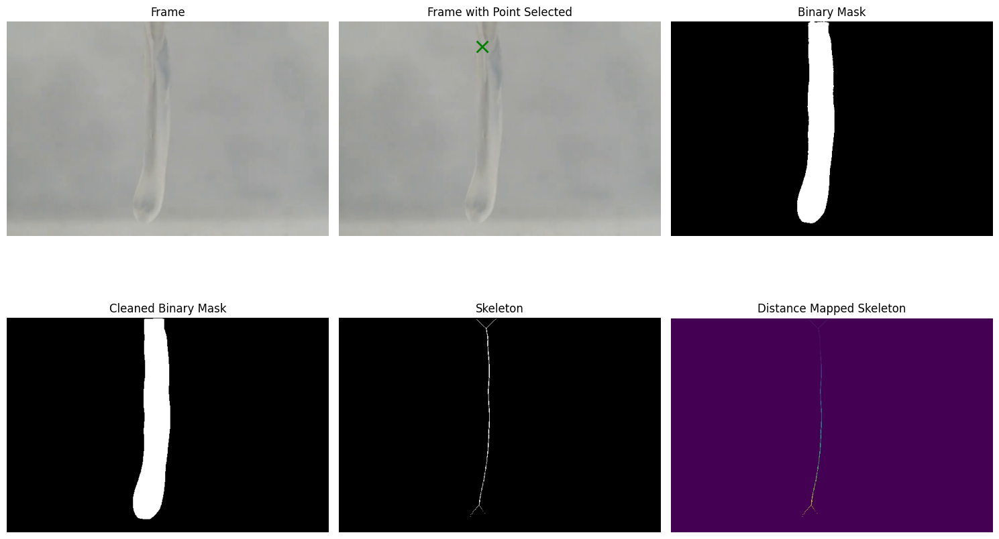

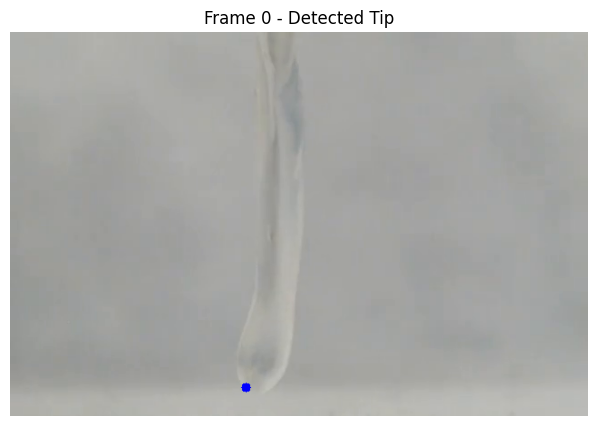


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_002.png: 1024x1024 1 0, 333.1ms
Speed: 5.0ms preprocess, 333.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_003.png: 1024x1024 1 0, 347.0ms
Speed: 3.0ms preprocess, 347.0ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 332.9ms
Speed: 3.0ms preprocess, 332.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 333.0ms
Speed: 3.0ms preprocess, 333.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 332.3ms
Speed: 3.0ms preprocess, 332.3

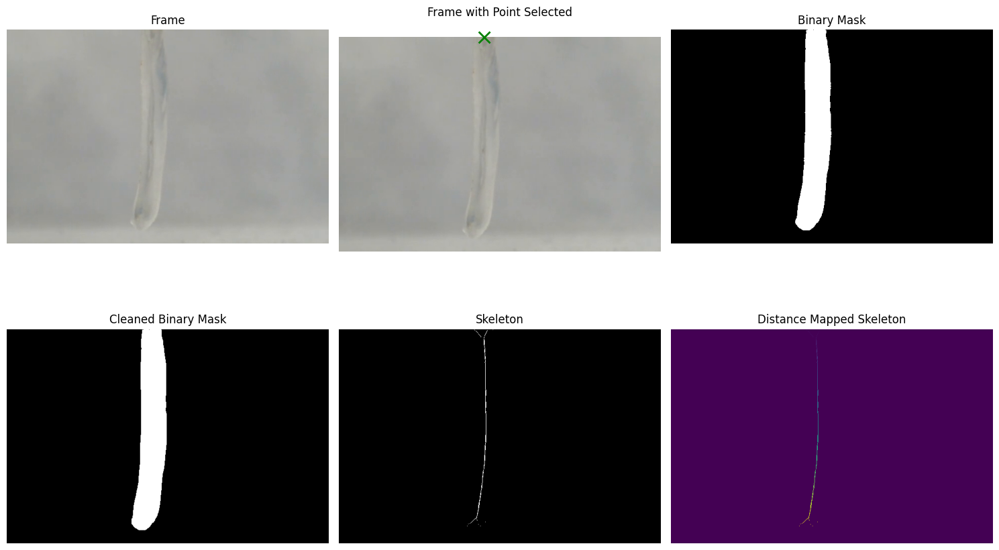

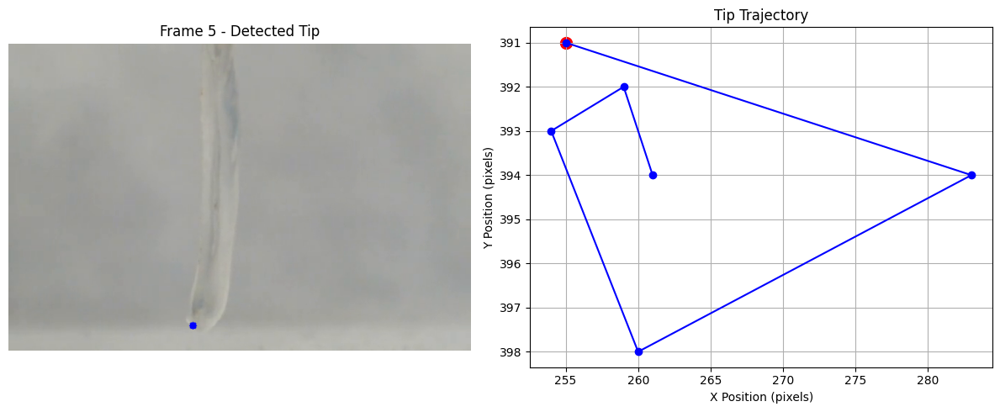


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 328.4ms
Speed: 5.1ms preprocess, 328.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 327.3ms
Speed: 3.1ms preprocess, 327.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 332.3ms
Speed: 3.1ms preprocess, 332.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 334.2ms
Speed: 3.1ms preprocess, 334.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 335.1ms
Speed: 3.0ms preprocess, 335.1

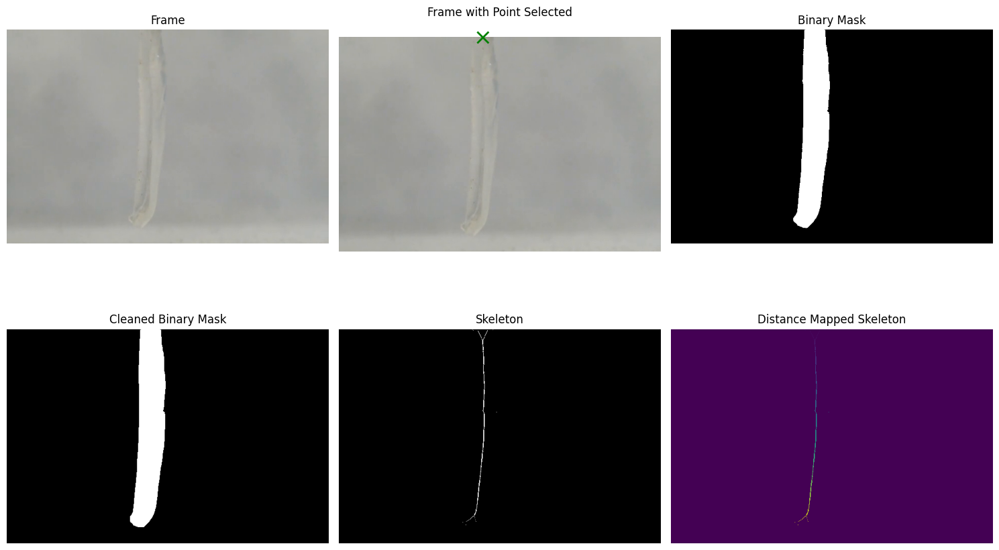

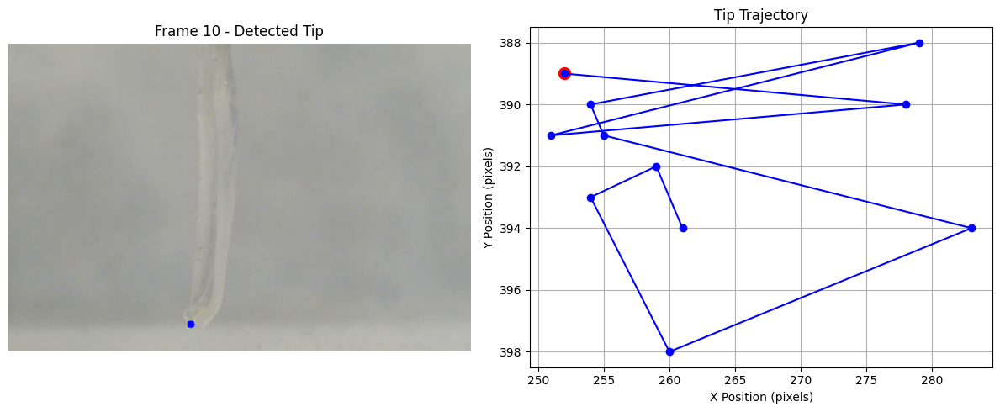


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 331.6ms
Speed: 5.1ms preprocess, 331.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 331.3ms
Speed: 3.1ms preprocess, 331.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 340.5ms
Speed: 3.1ms preprocess, 340.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 338.1ms
Speed: 3.0ms preprocess, 338.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 332.6ms
Speed: 3.1ms preprocess, 332.6

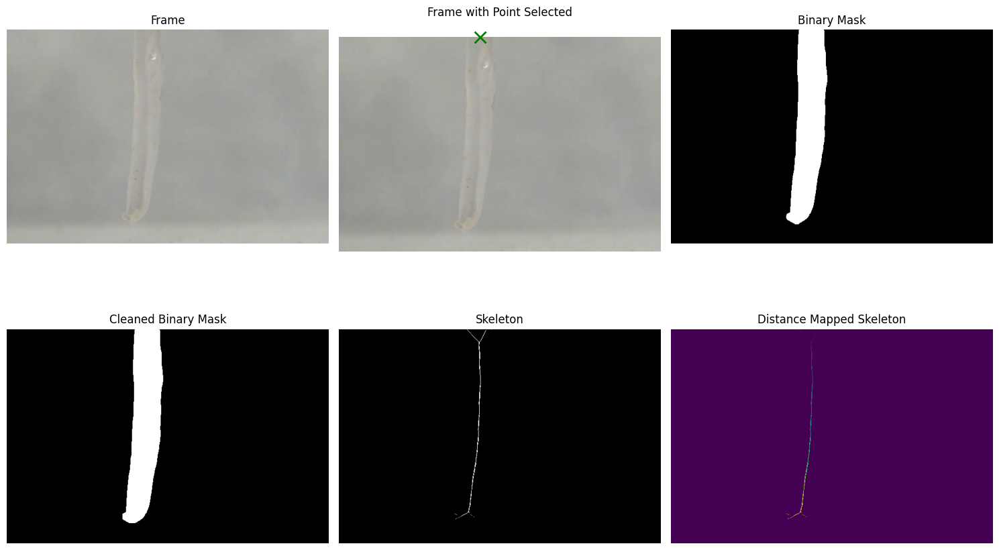

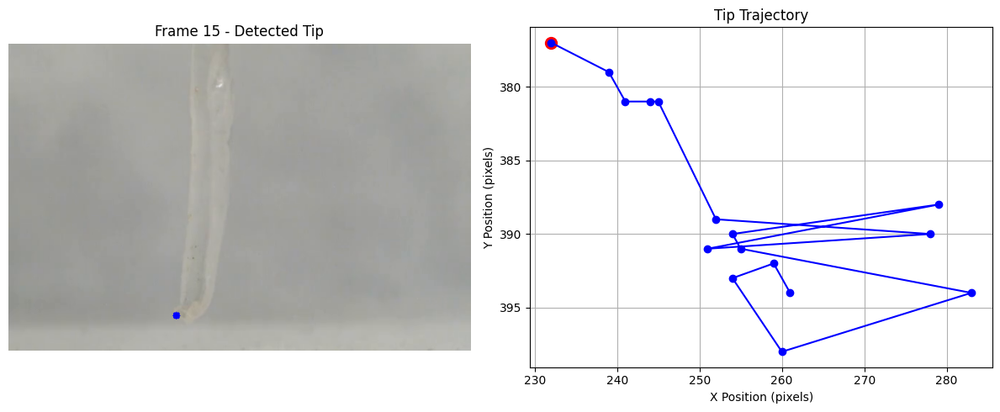


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 331.7ms
Speed: 4.8ms preprocess, 331.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 332.2ms
Speed: 3.8ms preprocess, 332.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 333.1ms
Speed: 3.2ms preprocess, 333.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 331.9ms
Speed: 3.1ms preprocess, 331.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 334.8ms
Speed: 3.1ms preprocess, 334.8

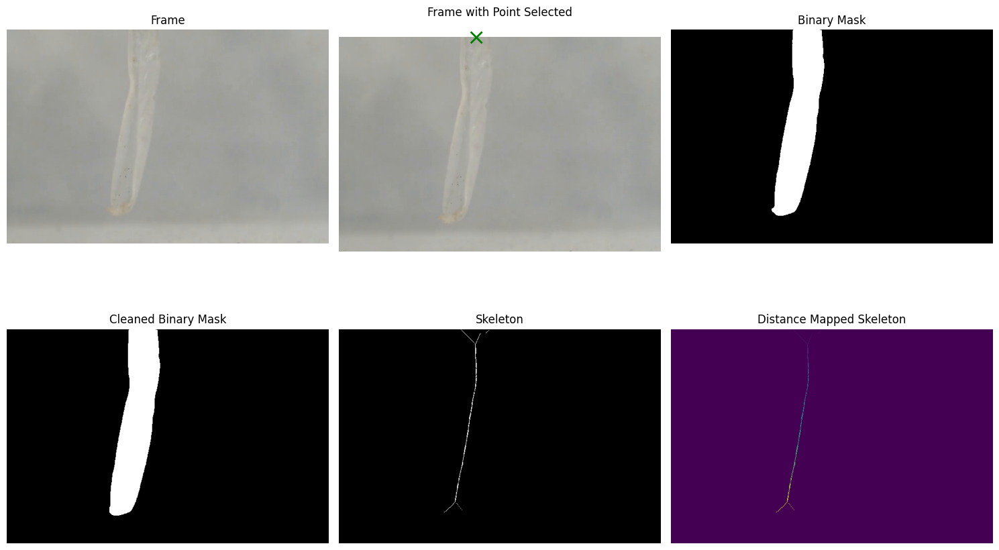

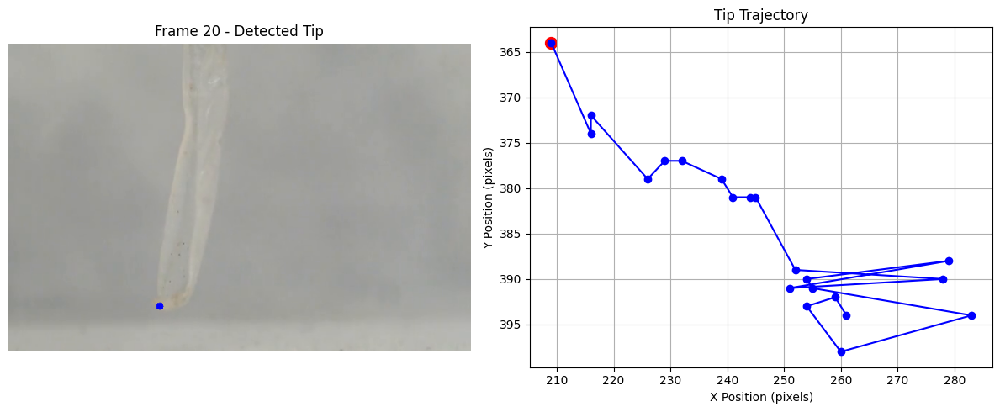


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 331.7ms
Speed: 4.9ms preprocess, 331.7ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 337.5ms
Speed: 3.1ms preprocess, 337.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 331.3ms
Speed: 3.1ms preprocess, 331.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 332.4ms
Speed: 3.1ms preprocess, 332.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 331.4ms
Speed: 3.1ms preprocess, 331.4

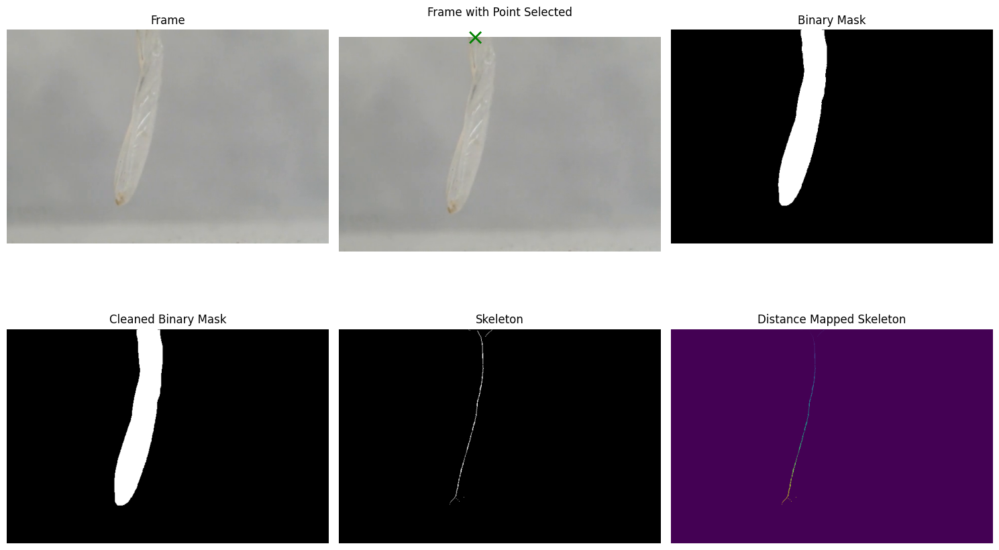

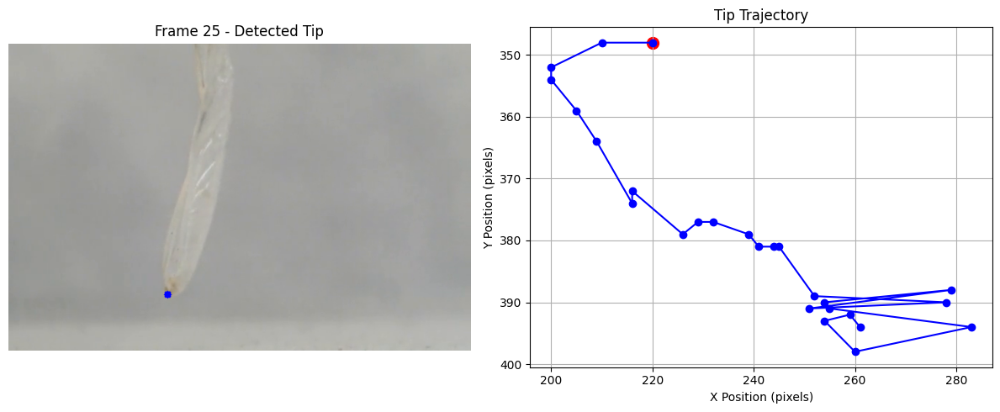


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 333.6ms
Speed: 4.9ms preprocess, 333.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 340.5ms
Speed: 3.1ms preprocess, 340.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 333.9ms
Speed: 3.1ms preprocess, 333.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 331.2ms
Speed: 3.1ms preprocess, 331.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 333.9ms
Speed: 3.0ms preprocess, 333.9

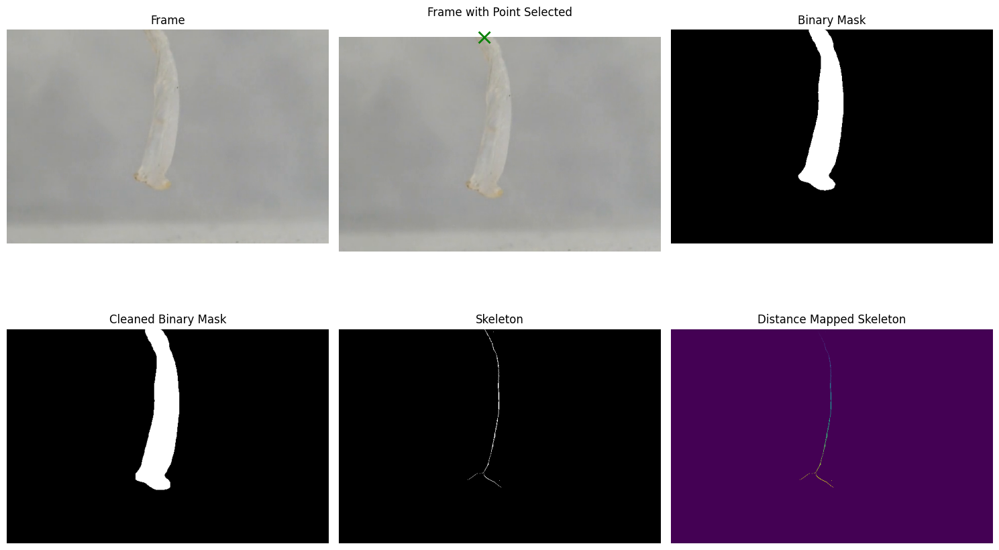

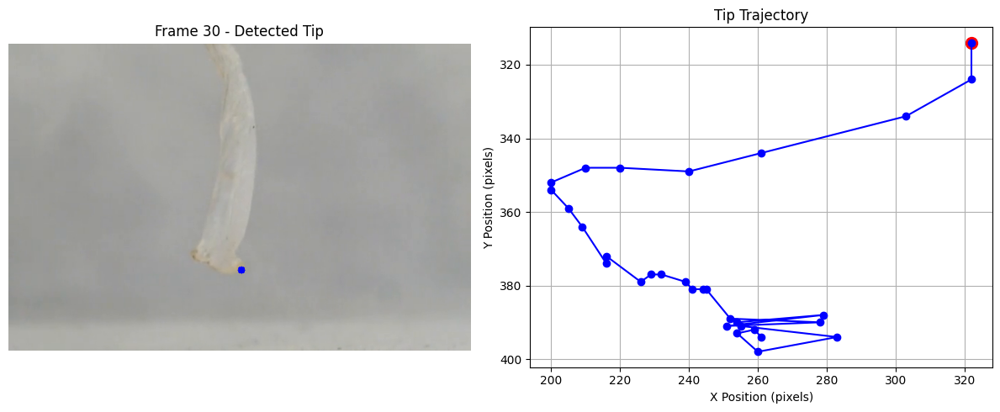


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 334.5ms
Speed: 4.9ms preprocess, 334.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 331.6ms
Speed: 3.1ms preprocess, 331.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 332.6ms
Speed: 3.0ms preprocess, 332.6ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 332.8ms
Speed: 3.1ms preprocess, 332.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


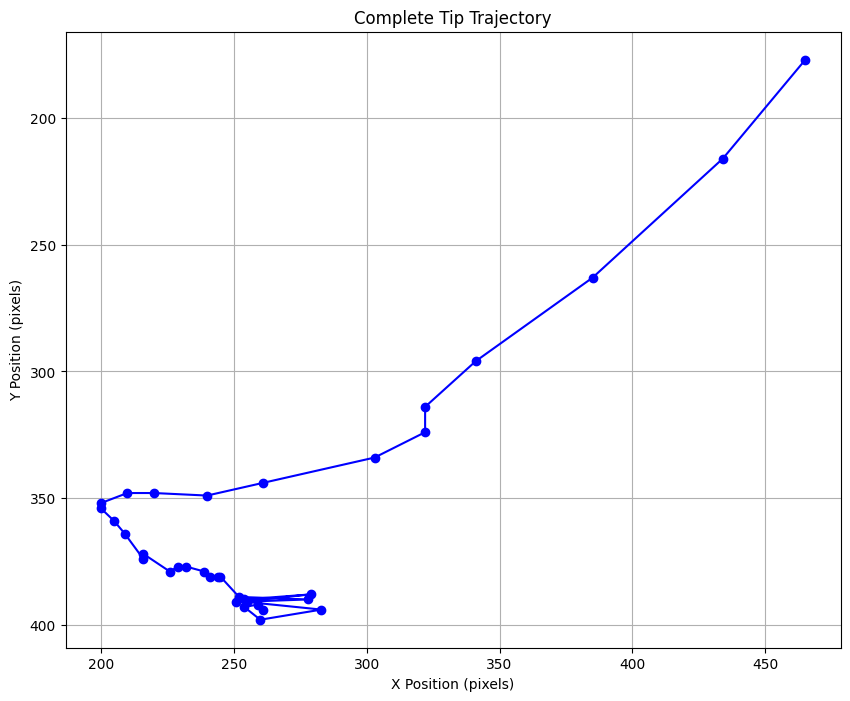

In [44]:
# Set paths
video_name = f"control_idx5_100x" # without the .mp4
video_path = f"bimorph_videos/{video_name}.mp4"
temp_folder = "tracking_frames/"
start_frame = 0
#end_frame = 31
frame_interval=0.6
point = (285, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    maximum_tip_travel_between_frames = 140,
    edge_cushion =0,
    tip_margin=40
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

Analyzing frames 22 to 74
Total frames used: 53



[out#0/image2 @ 0x56da5a624580] video:6818kB audio:0kB subtitle:0kB other streams:0kB global headers:0kB muxing overhead: unknown
frame=   75 fps=0.0 q=-0.0 Lsize=N/A time=00:00:44.40 bitrate=N/A speed= 223x    


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 353.1ms
Speed: 3.0ms preprocess, 353.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

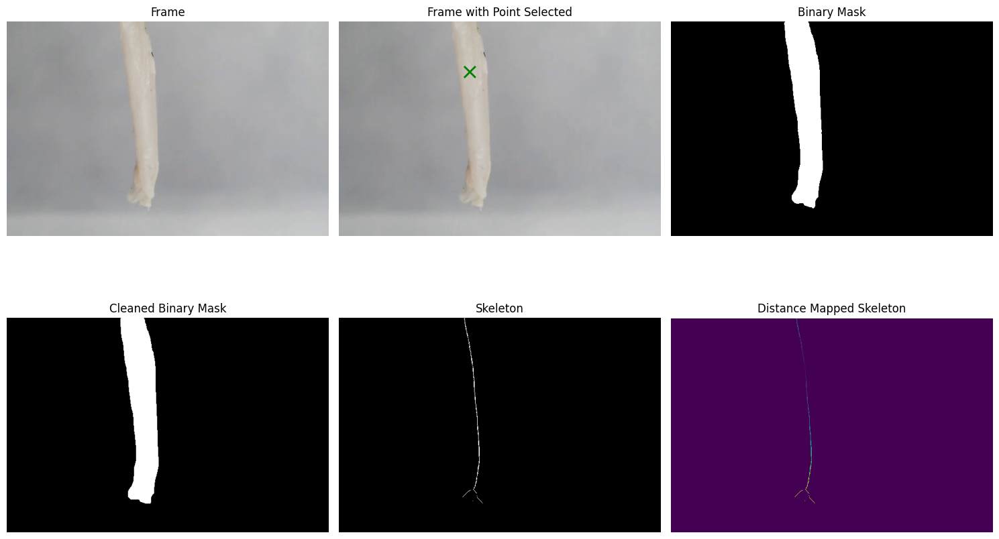

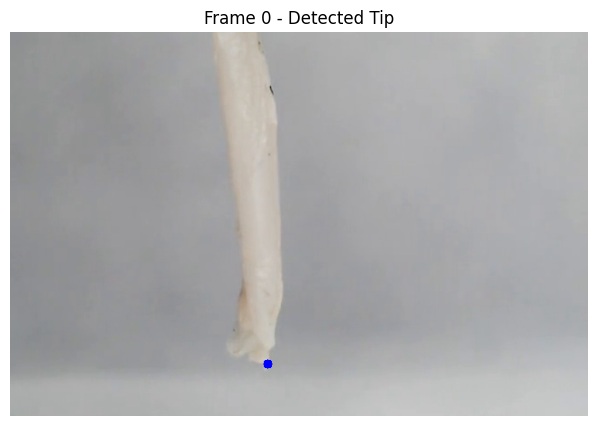


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 329.8ms
Speed: 4.9ms preprocess, 329.8ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 337.2ms
Speed: 3.7ms preprocess, 337.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 331.9ms
Speed: 3.1ms preprocess, 331.9ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 333.4ms
Speed: 3.0ms preprocess, 333.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 333.4ms
Speed: 3.0ms preprocess, 333.4

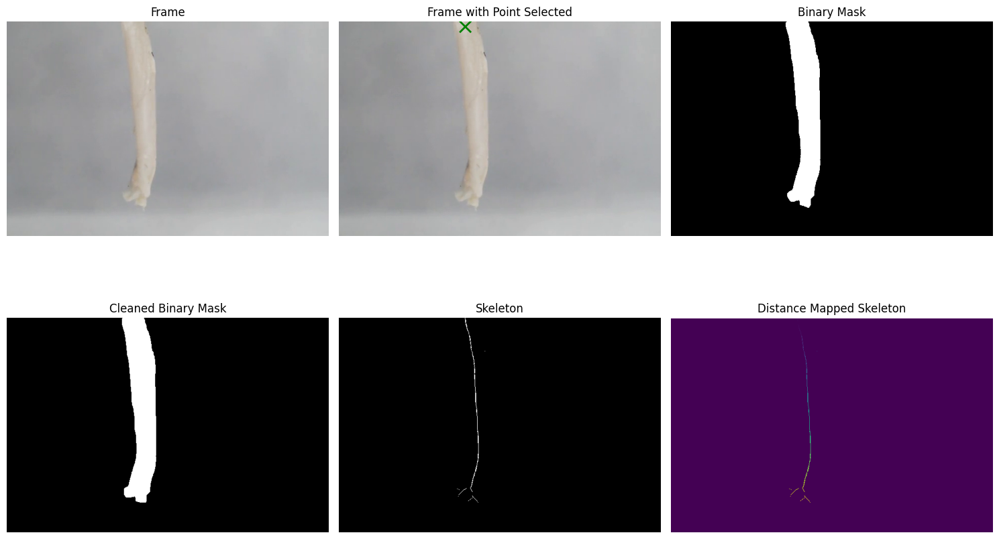

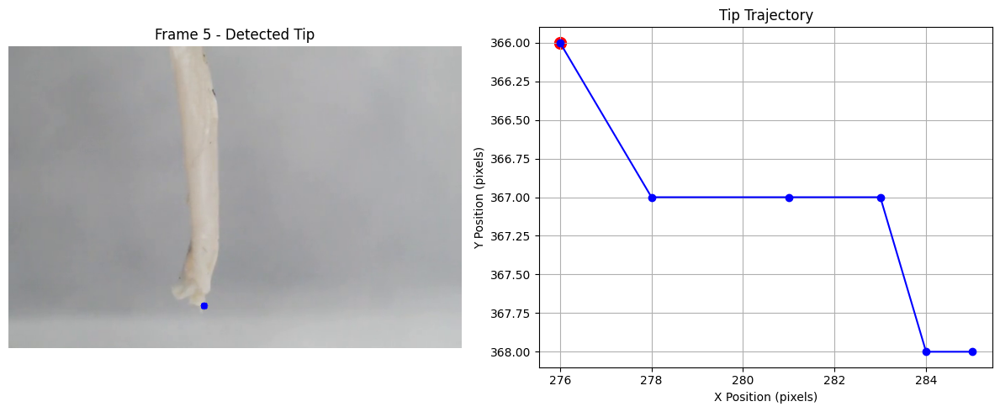


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 331.6ms
Speed: 4.8ms preprocess, 331.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 342.3ms
Speed: 2.9ms preprocess, 342.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 329.6ms
Speed: 2.9ms preprocess, 329.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 332.2ms
Speed: 3.0ms preprocess, 332.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 331.3ms
Speed: 3.1ms preprocess, 331.3

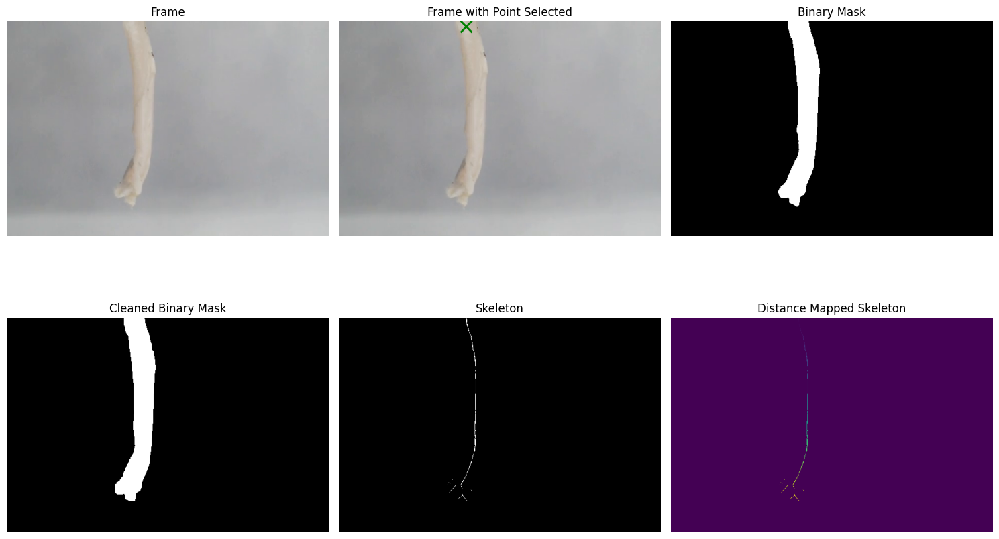

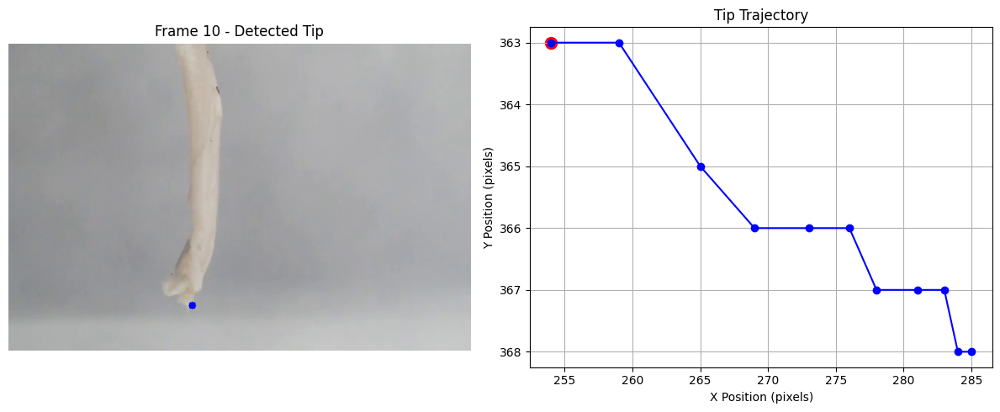


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 330.6ms
Speed: 4.9ms preprocess, 330.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 329.9ms
Speed: 3.0ms preprocess, 329.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_036.png: 1024x1024 1 0, 331.1ms
Speed: 3.1ms preprocess, 331.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_037.png: 1024x1024 1 0, 332.9ms
Speed: 3.1ms preprocess, 332.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_038.png: 1024x1024 1 0, 329.9ms
Speed: 3.9ms preprocess, 329.9

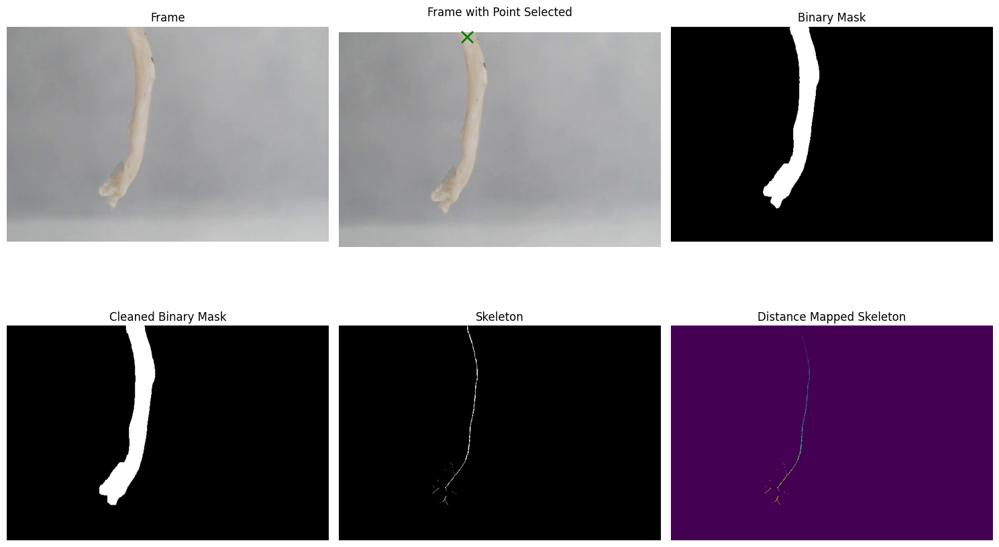

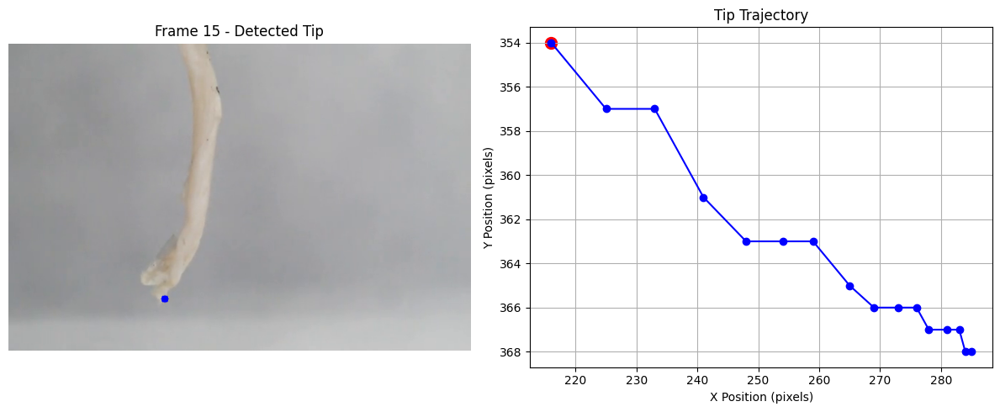


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_039.png: 1024x1024 1 0, 336.1ms
Speed: 4.8ms preprocess, 336.1ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_040.png: 1024x1024 1 0, 335.0ms
Speed: 3.1ms preprocess, 335.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_041.png: 1024x1024 1 0, 334.7ms
Speed: 3.1ms preprocess, 334.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_042.png: 1024x1024 1 0, 332.6ms
Speed: 3.1ms preprocess, 332.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_043.png: 1024x1024 1 0, 332.7ms
Speed: 3.1ms preprocess, 332.7

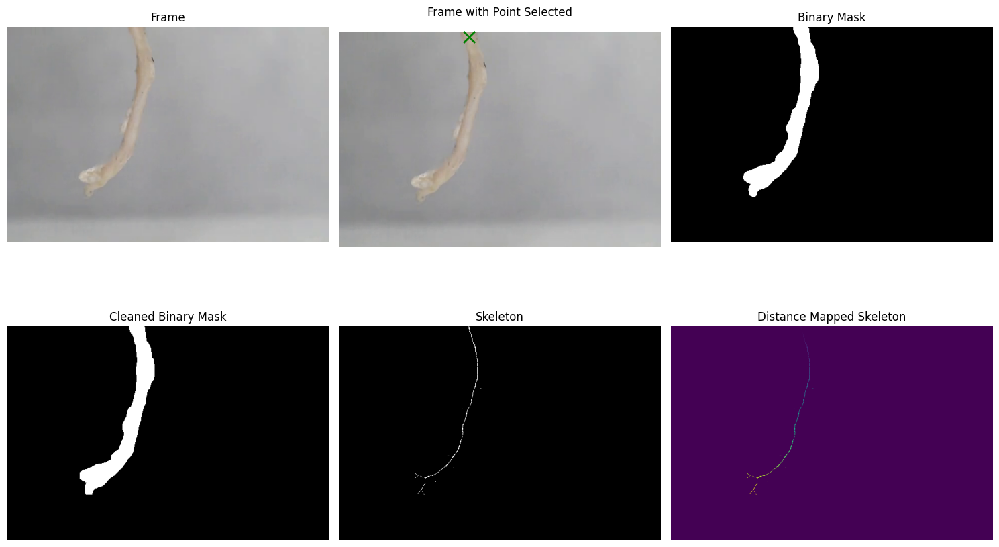

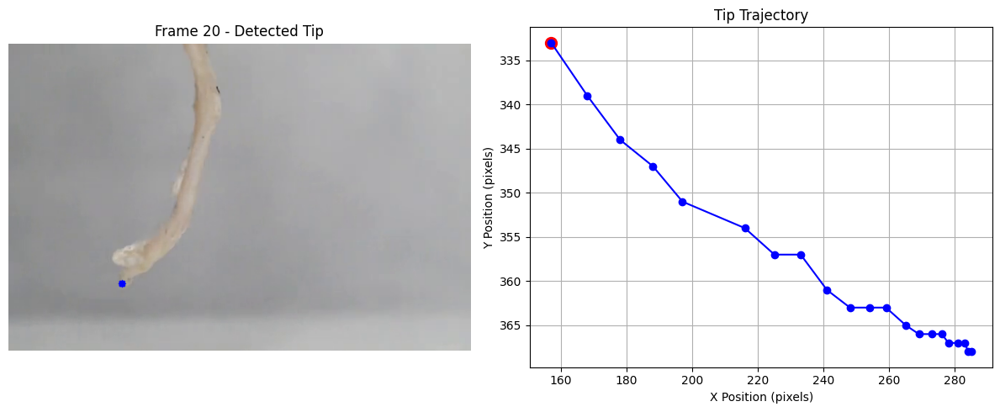


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_044.png: 1024x1024 1 0, 334.3ms
Speed: 4.8ms preprocess, 334.3ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_045.png: 1024x1024 1 0, 331.0ms
Speed: 3.2ms preprocess, 331.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_046.png: 1024x1024 1 0, 330.4ms
Speed: 10.0ms preprocess, 330.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_047.png: 1024x1024 1 0, 330.3ms
Speed: 3.2ms preprocess, 330.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_048.png: 1024x1024 1 0, 332.0ms
Speed: 3.1ms preprocess, 332.

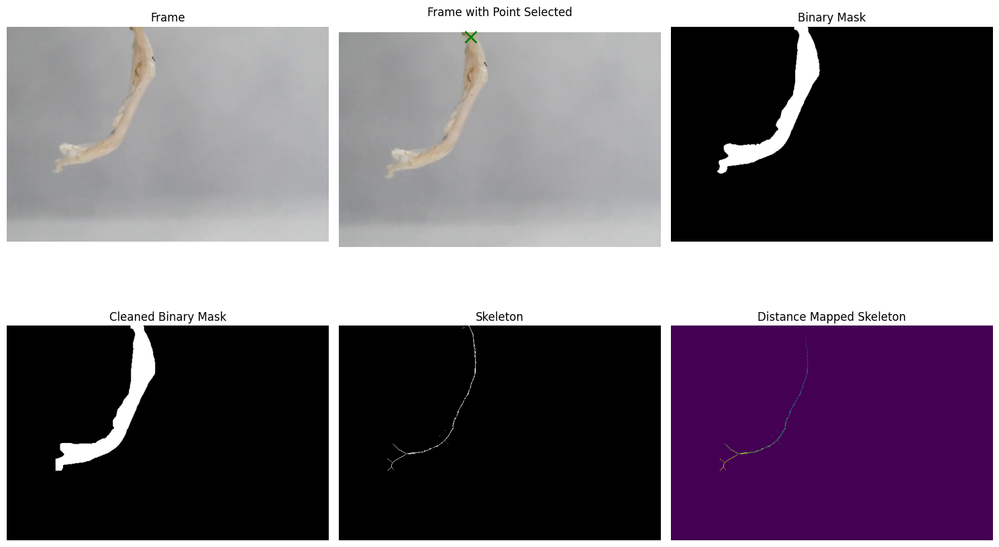

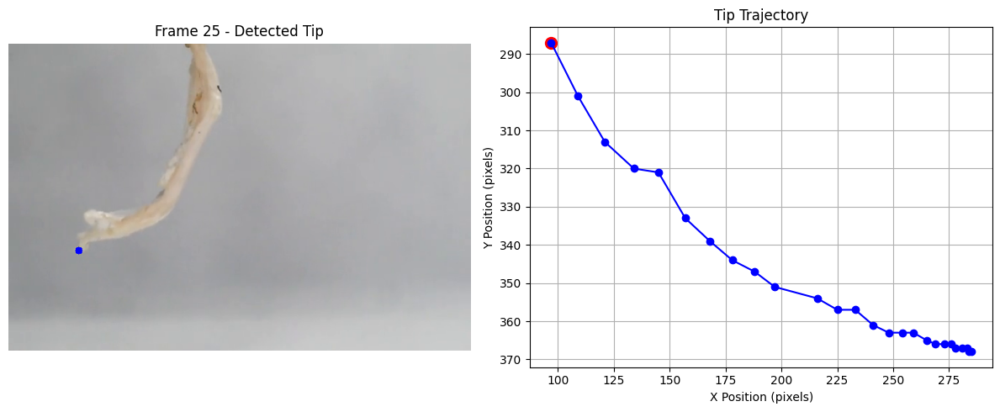


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_049.png: 1024x1024 1 0, 329.4ms
Speed: 4.0ms preprocess, 329.4ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_050.png: 1024x1024 1 0, 334.8ms
Speed: 3.1ms preprocess, 334.8ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_051.png: 1024x1024 1 0, 347.1ms
Speed: 3.4ms preprocess, 347.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_052.png: 1024x1024 1 0, 334.0ms
Speed: 3.1ms preprocess, 334.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_053.png: 1024x1024 1 0, 333.6ms
Speed: 3.1ms preprocess, 333.6

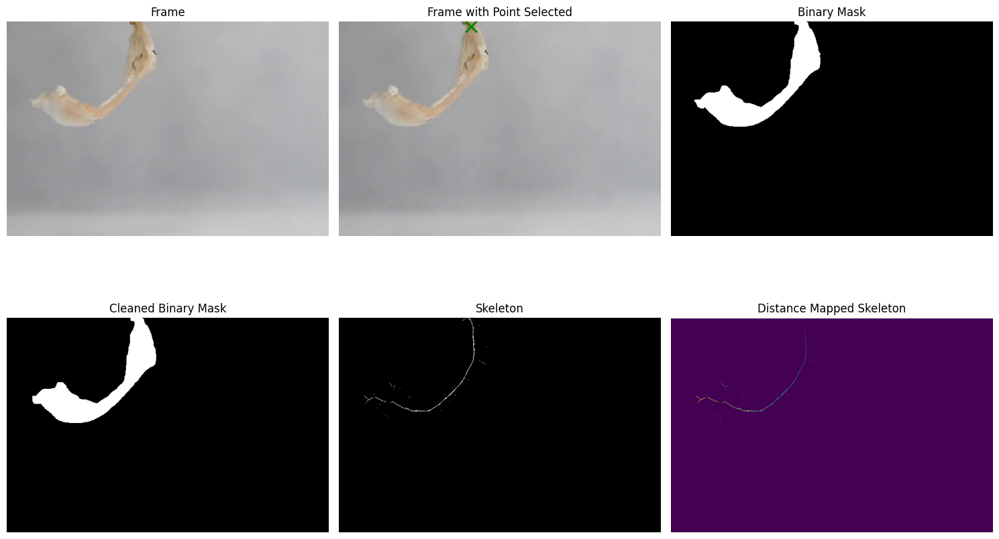

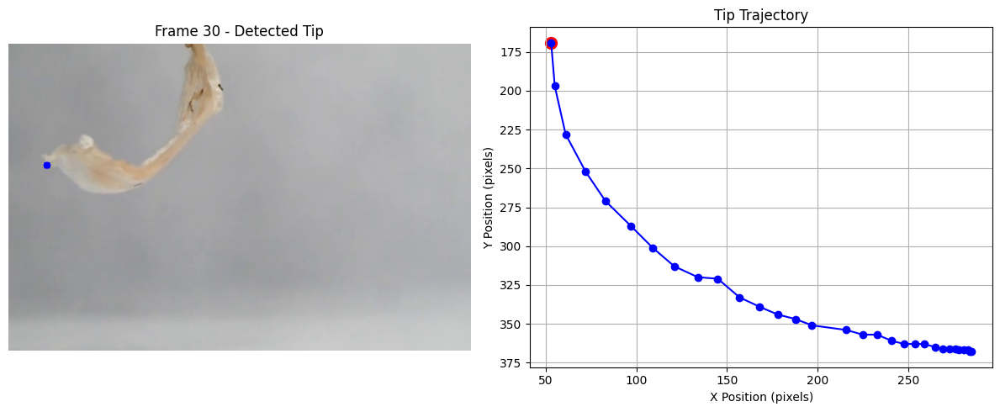


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_054.png: 1024x1024 1 0, 327.0ms
Speed: 4.8ms preprocess, 327.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_055.png: 1024x1024 1 0, 337.7ms
Speed: 3.1ms preprocess, 337.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_056.png: 1024x1024 1 0, 335.0ms
Speed: 3.1ms preprocess, 335.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_057.png: 1024x1024 1 0, 336.1ms
Speed: 3.1ms preprocess, 336.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_058.png: 1024x1024 1 0, 337.2ms
Speed: 3.1ms preprocess, 337.2

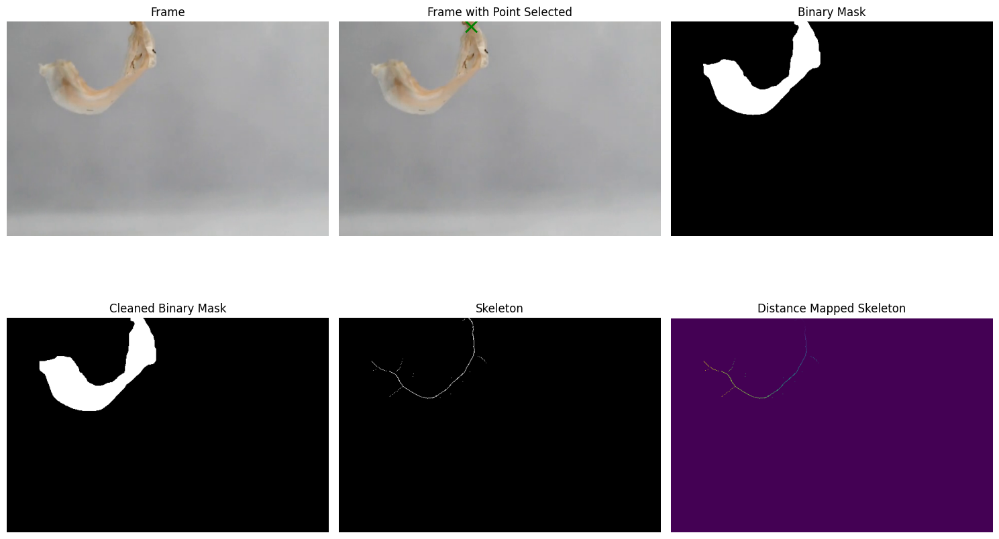

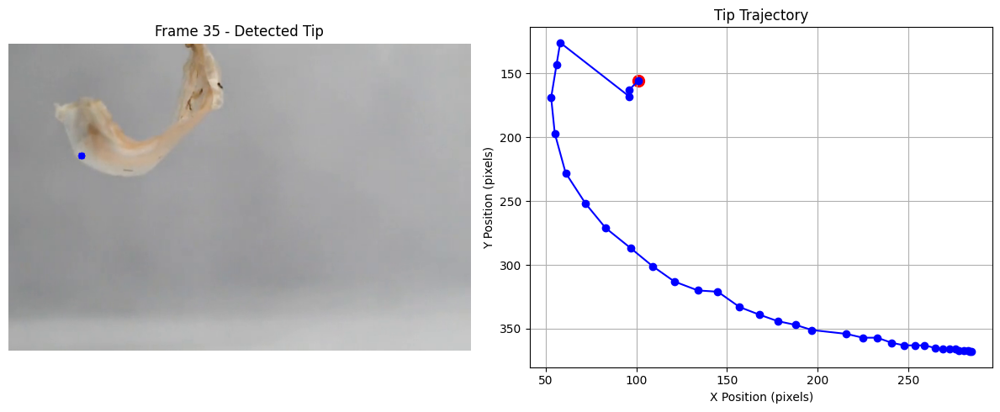


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_059.png: 1024x1024 1 0, 332.3ms
Speed: 4.0ms preprocess, 332.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_060.png: 1024x1024 1 0, 336.0ms
Speed: 3.0ms preprocess, 336.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_061.png: 1024x1024 1 0, 335.4ms
Speed: 3.0ms preprocess, 335.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_062.png: 1024x1024 1 0, 334.9ms
Speed: 3.0ms preprocess, 334.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_063.png: 1024x1024 1 0, 334.9ms
Speed: 3.6ms preprocess, 334.9

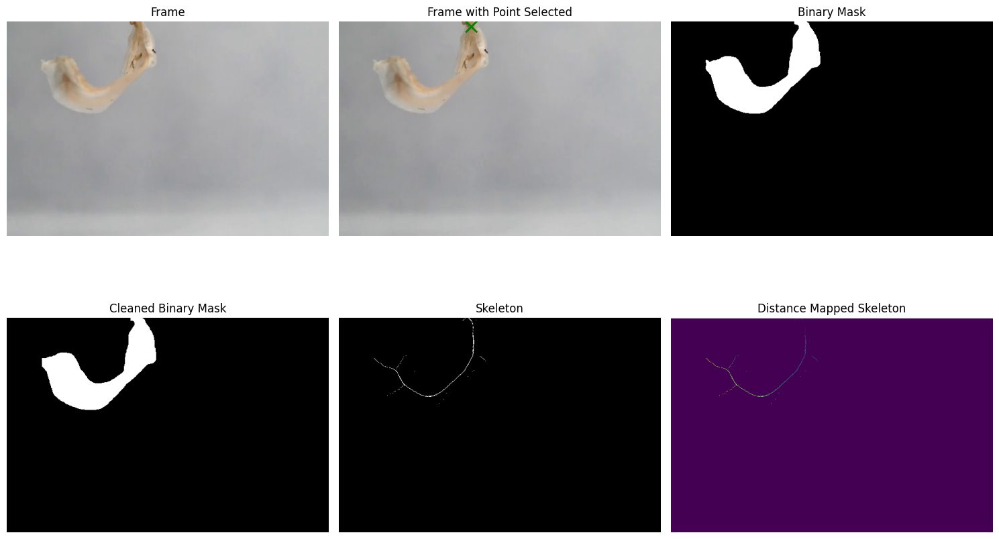

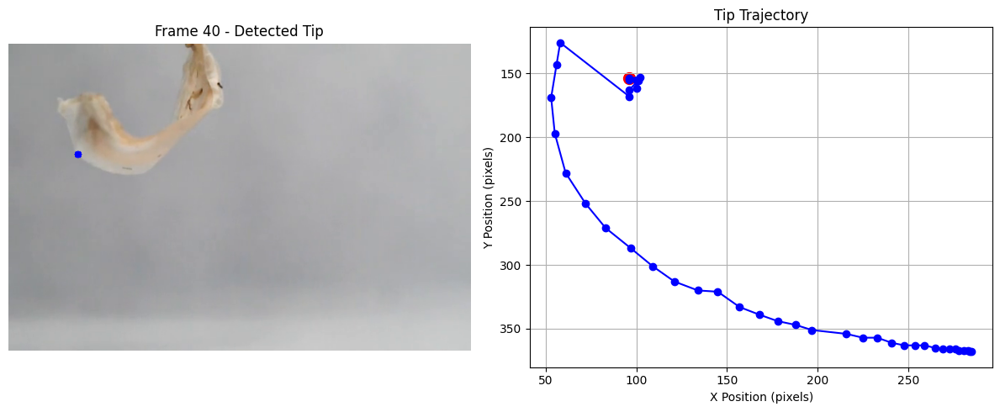


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_064.png: 1024x1024 1 0, 334.0ms
Speed: 4.8ms preprocess, 334.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_065.png: 1024x1024 1 0, 345.7ms
Speed: 2.9ms preprocess, 345.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_066.png: 1024x1024 1 0, 341.2ms
Speed: 2.9ms preprocess, 341.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_067.png: 1024x1024 1 0, 339.3ms
Speed: 3.1ms preprocess, 339.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_068.png: 1024x1024 1 0, 339.6ms
Speed: 3.1ms preprocess, 339.6

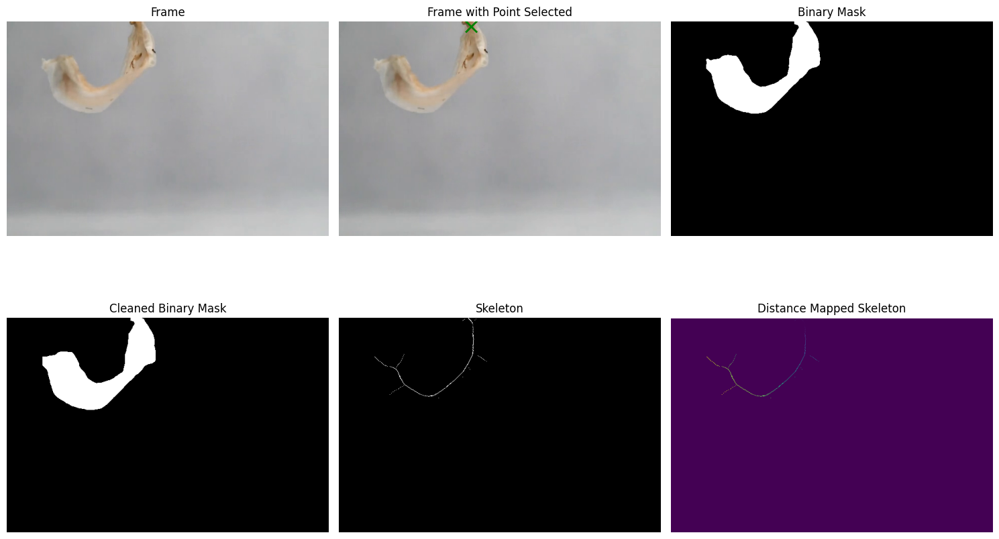

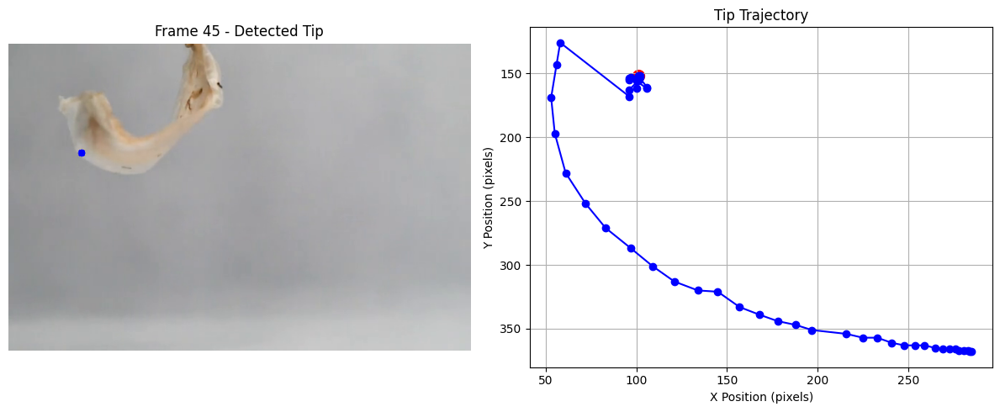


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_069.png: 1024x1024 1 0, 334.4ms
Speed: 3.1ms preprocess, 334.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_070.png: 1024x1024 1 0, 358.1ms
Speed: 3.1ms preprocess, 358.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_071.png: 1024x1024 1 0, 331.9ms
Speed: 3.0ms preprocess, 331.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_072.png: 1024x1024 1 0, 331.6ms
Speed: 3.1ms preprocess, 331.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_073.png: 1024x1024 1 0, 330.2ms
Speed: 3.1ms preprocess, 330.2

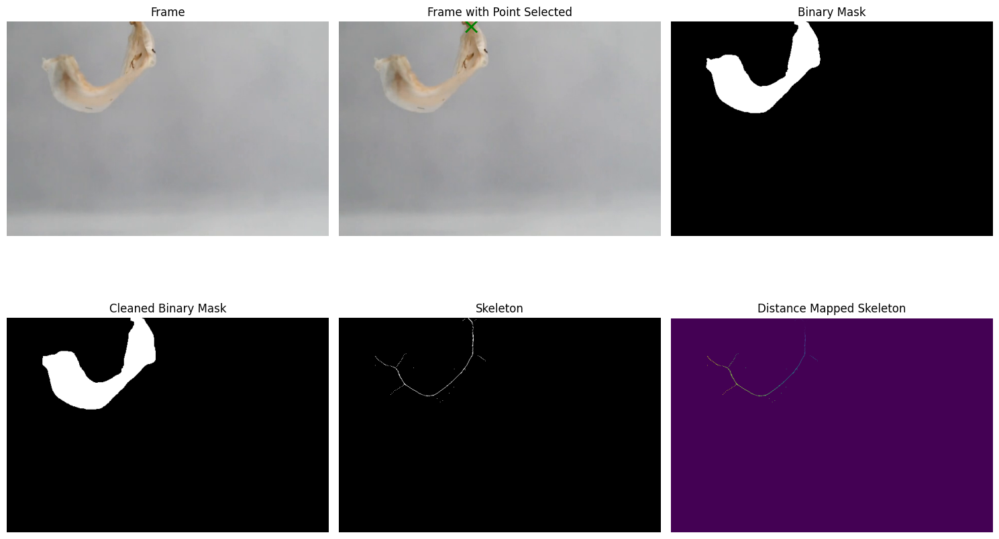

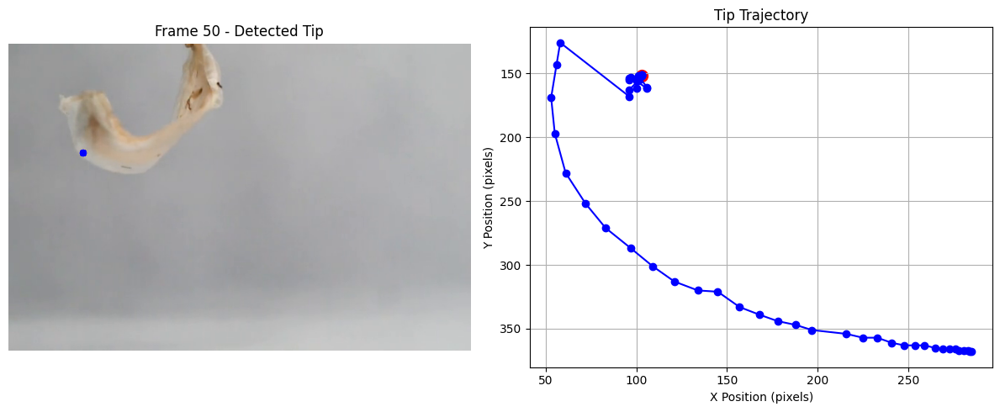


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_074.png: 1024x1024 1 0, 331.2ms
Speed: 4.8ms preprocess, 331.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_075.png: 1024x1024 1 0, 331.0ms
Speed: 8.1ms preprocess, 331.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


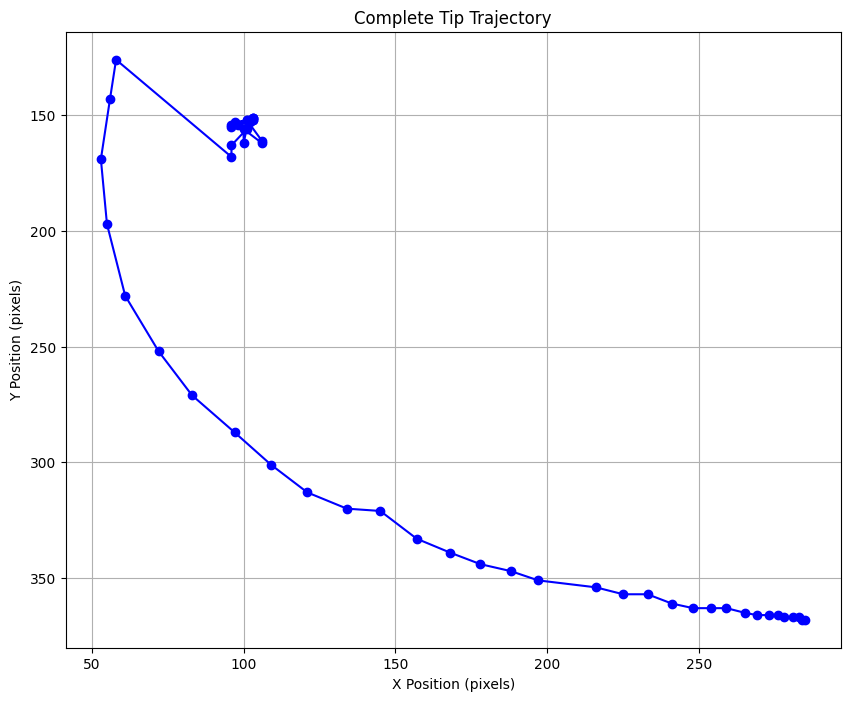

In [45]:
# Set paths
video_name = f"bimorph_idx0_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 22
end_frame = None
frame_interval=0.6
point = (260, 100)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    prune_branches=True
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

Analyzing frames 0 to 39
Total frames used: 40

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_001.png: 1024x1024 1 0, 348.6ms
Speed: 3.1ms preprocess, 348.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

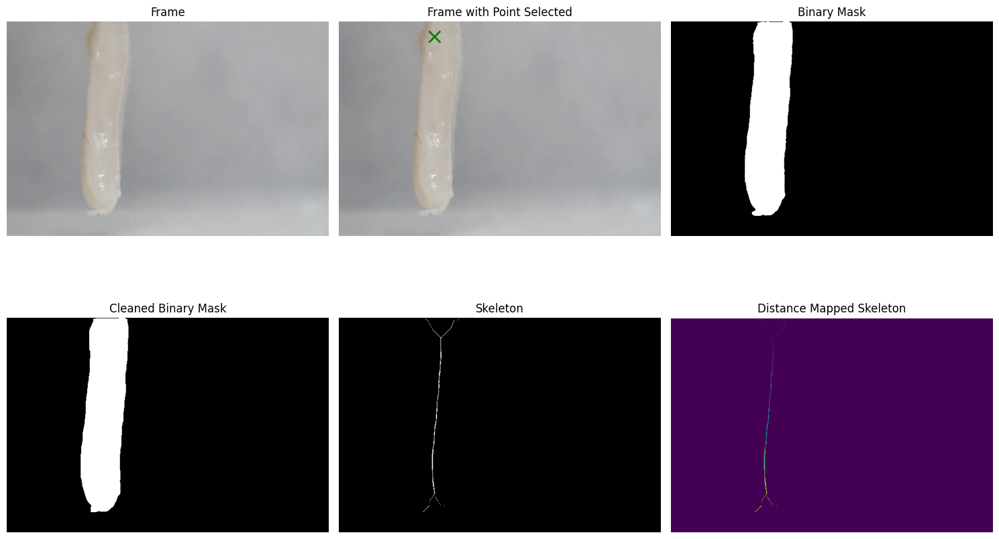

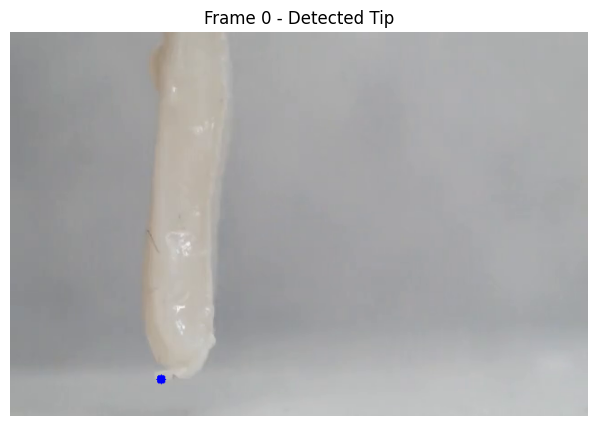


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_002.png: 1024x1024 1 0, 334.8ms
Speed: 4.8ms preprocess, 334.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_003.png: 1024x1024 1 0, 333.1ms
Speed: 3.1ms preprocess, 333.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 347.0ms
Speed: 3.1ms preprocess, 347.0ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 333.4ms
Speed: 3.1ms preprocess, 333.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 331.9ms
Speed: 3.1ms preprocess, 331.9

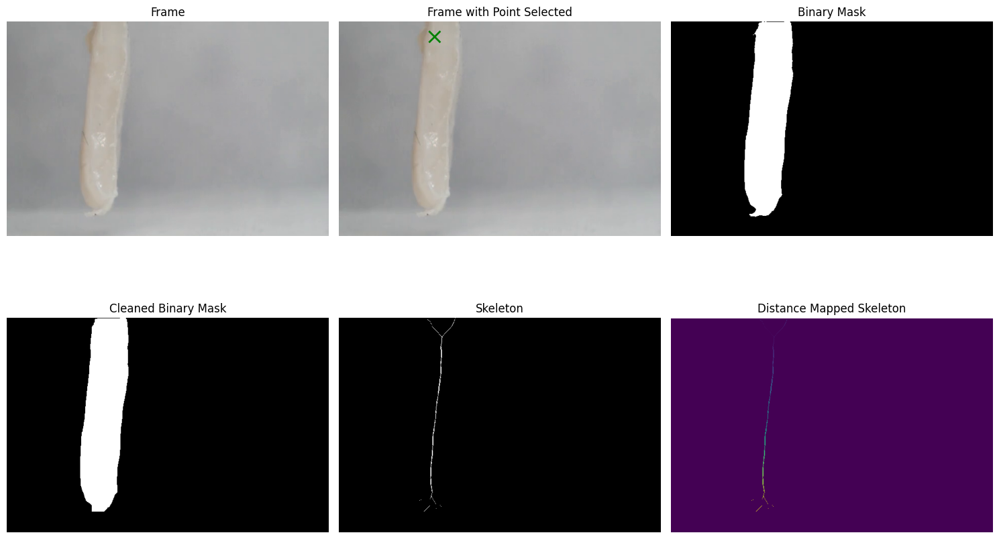

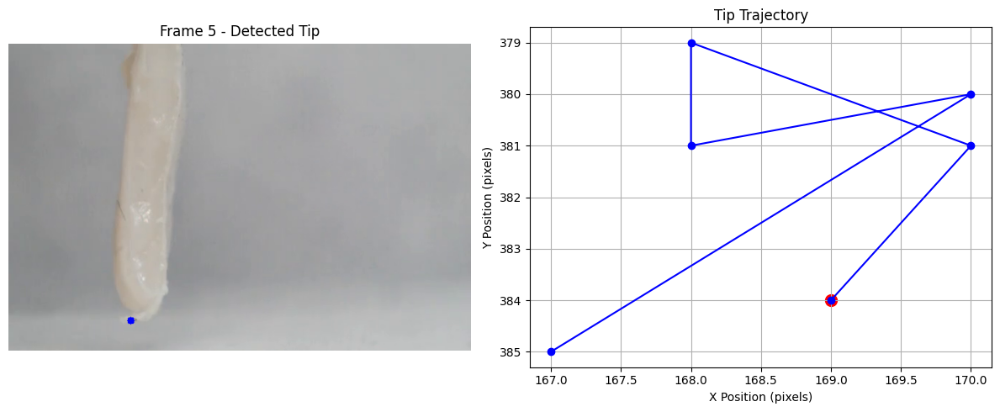


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 332.1ms
Speed: 4.9ms preprocess, 332.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 343.3ms
Speed: 3.0ms preprocess, 343.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 331.0ms
Speed: 3.1ms preprocess, 331.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 332.5ms
Speed: 3.1ms preprocess, 332.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 333.4ms
Speed: 3.4ms preprocess, 333.4

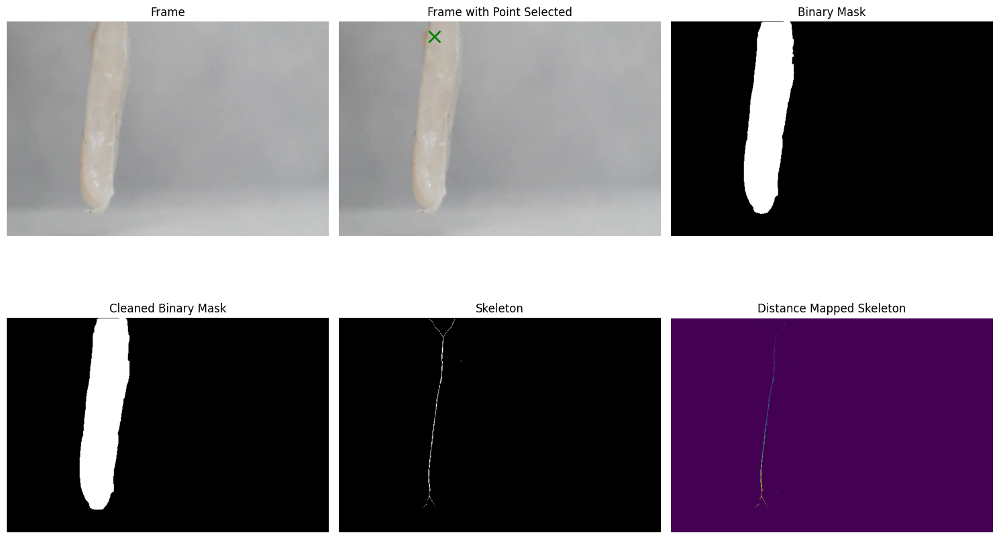

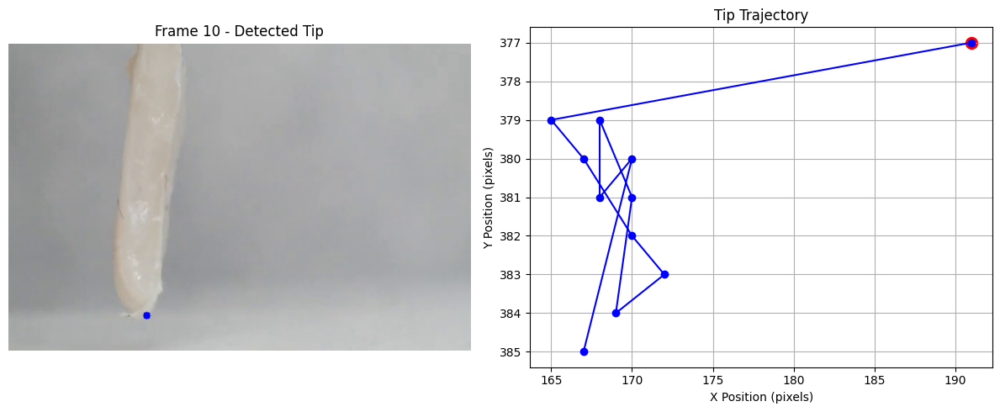


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 331.4ms
Speed: 4.9ms preprocess, 331.4ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 336.1ms
Speed: 3.0ms preprocess, 336.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 332.6ms
Speed: 3.0ms preprocess, 332.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 331.2ms
Speed: 3.2ms preprocess, 331.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 334.2ms
Speed: 3.0ms preprocess, 334.2

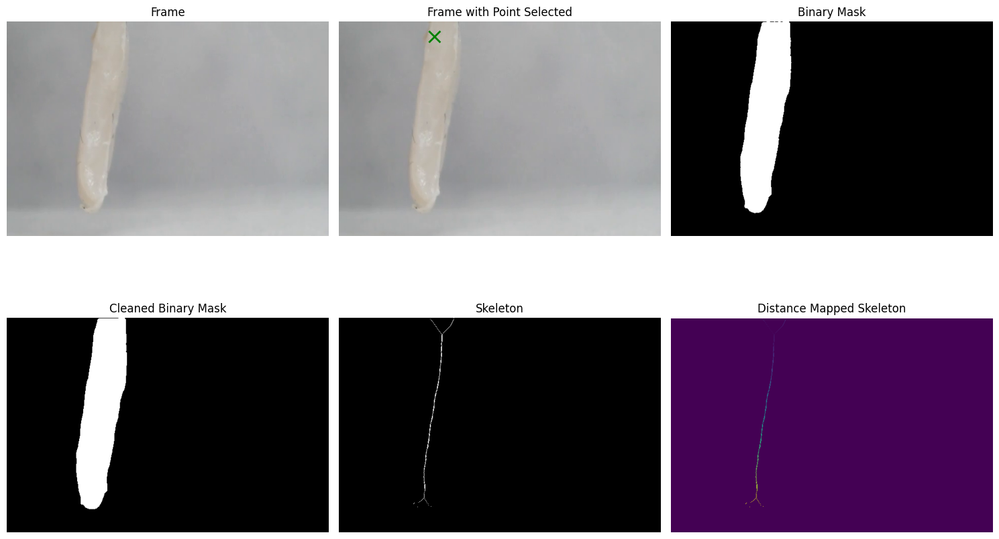

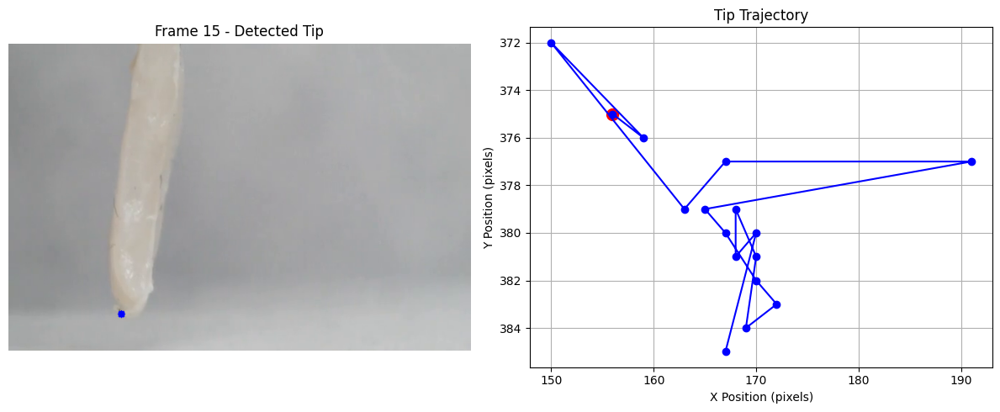


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 331.9ms
Speed: 4.8ms preprocess, 331.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 344.5ms
Speed: 3.0ms preprocess, 344.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 328.5ms
Speed: 2.9ms preprocess, 328.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 327.9ms
Speed: 2.9ms preprocess, 327.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 331.1ms
Speed: 2.9ms preprocess, 331.1

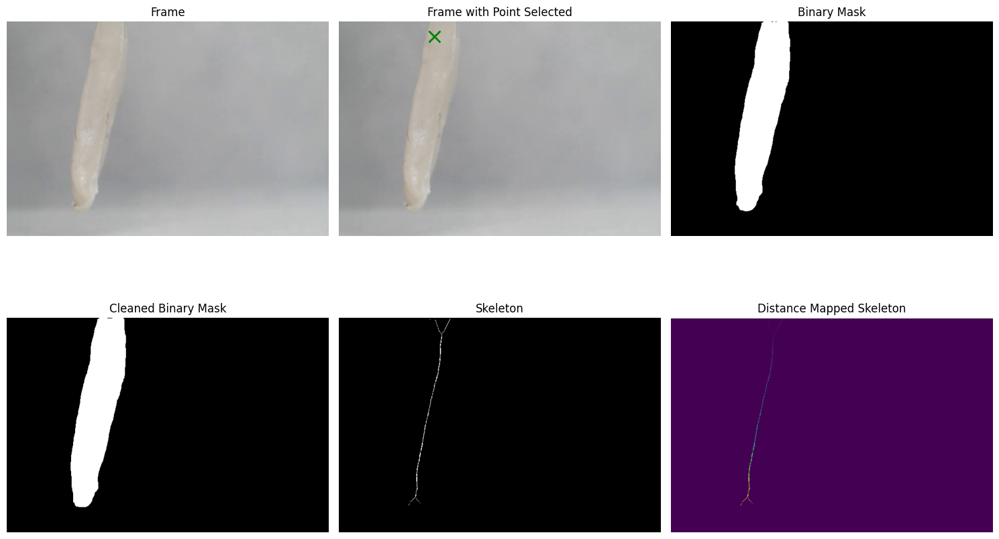

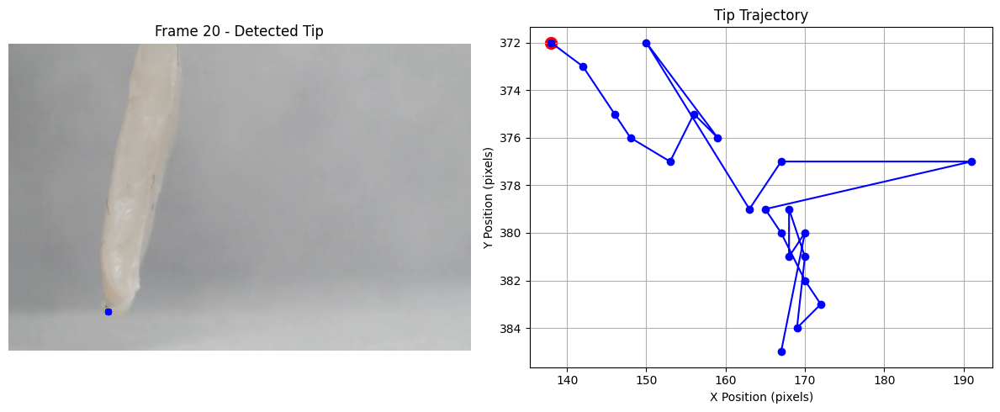


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 334.6ms
Speed: 5.0ms preprocess, 334.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 343.6ms
Speed: 3.1ms preprocess, 343.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 338.3ms
Speed: 3.1ms preprocess, 338.3ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 336.6ms
Speed: 3.1ms preprocess, 336.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 337.2ms
Speed: 3.2ms preprocess, 337.2

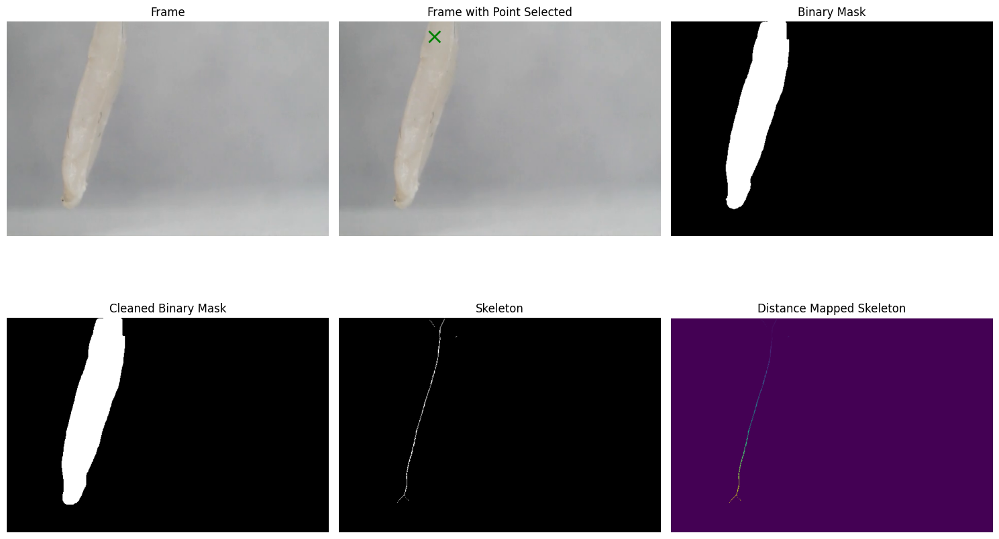

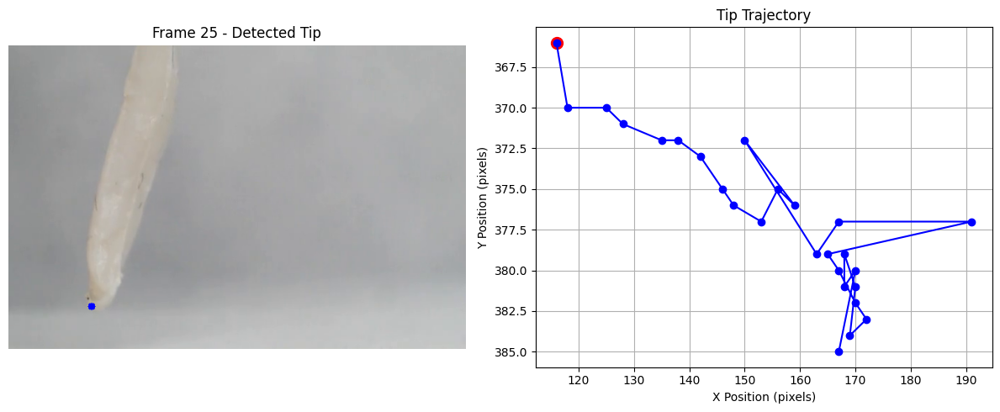


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 342.6ms
Speed: 4.9ms preprocess, 342.6ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 335.6ms
Speed: 3.1ms preprocess, 335.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 334.1ms
Speed: 3.1ms preprocess, 334.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 335.1ms
Speed: 3.1ms preprocess, 335.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 334.2ms
Speed: 3.1ms preprocess, 334.2

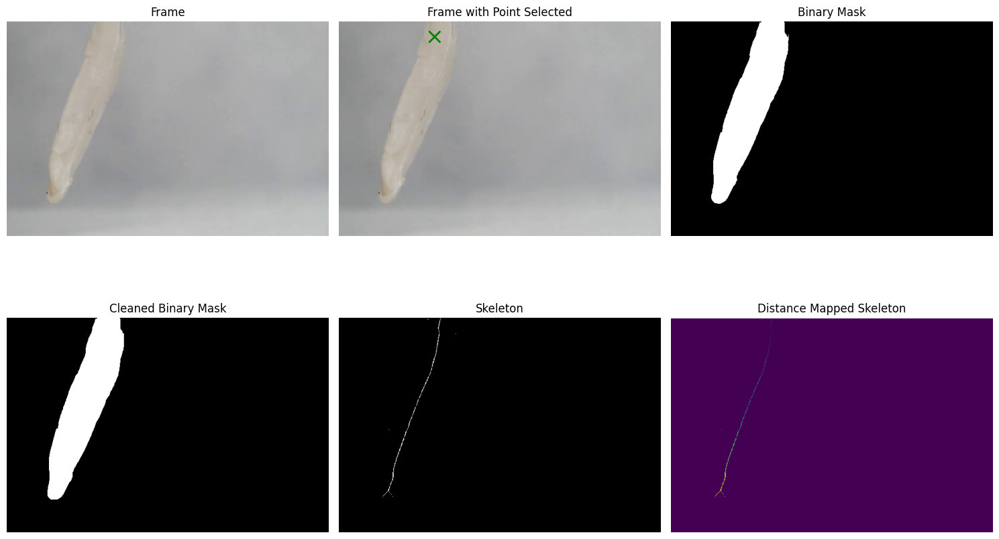

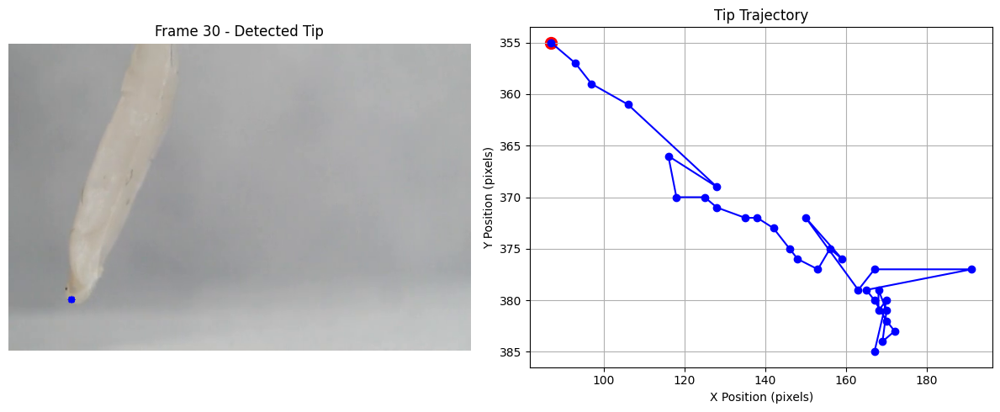


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 335.9ms
Speed: 4.8ms preprocess, 335.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 347.7ms
Speed: 3.1ms preprocess, 347.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 335.2ms
Speed: 3.5ms preprocess, 335.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 337.4ms
Speed: 3.0ms preprocess, 337.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_036.png: 1024x1024 1 0, 336.0ms
Speed: 3.1ms preprocess, 336.0

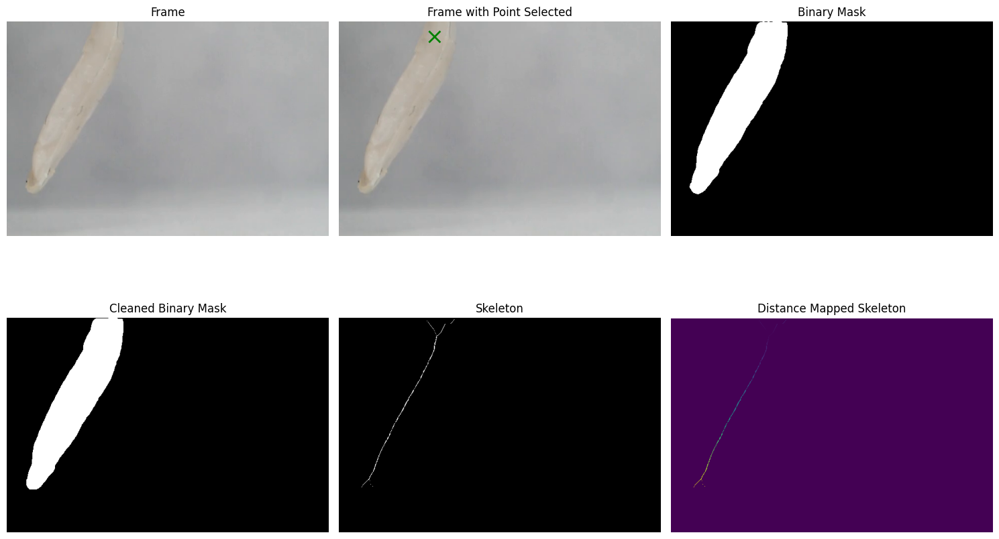

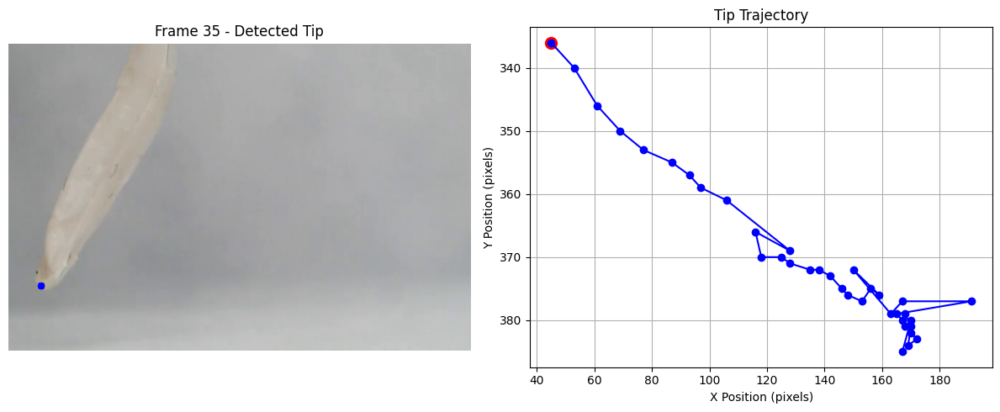


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_037.png: 1024x1024 1 0, 335.1ms
Speed: 5.1ms preprocess, 335.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_038.png: 1024x1024 1 0, 351.1ms
Speed: 3.1ms preprocess, 351.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_039.png: 1024x1024 1 0, 354.8ms
Speed: 3.0ms preprocess, 354.8ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_040.png: 1024x1024 1 0, 340.1ms
Speed: 3.1ms preprocess, 340.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


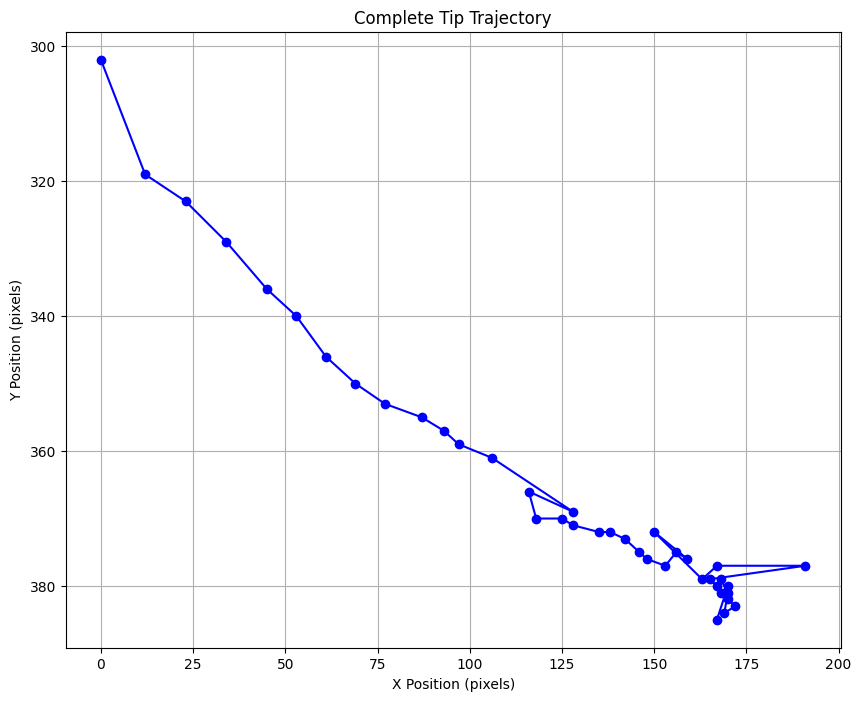

In [46]:
# Set paths
video_name = f"bimorph_idx1_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 0
end_frame = 40
frame_interval=0.6
point = (190, 30)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    edge_cushion =0,
    no_wandering_anchor=True,
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

Analyzing frames 25 to 61
Total frames used: 37

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 348.7ms
Speed: 3.1ms preprocess, 348.7ms inference, 4.2ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

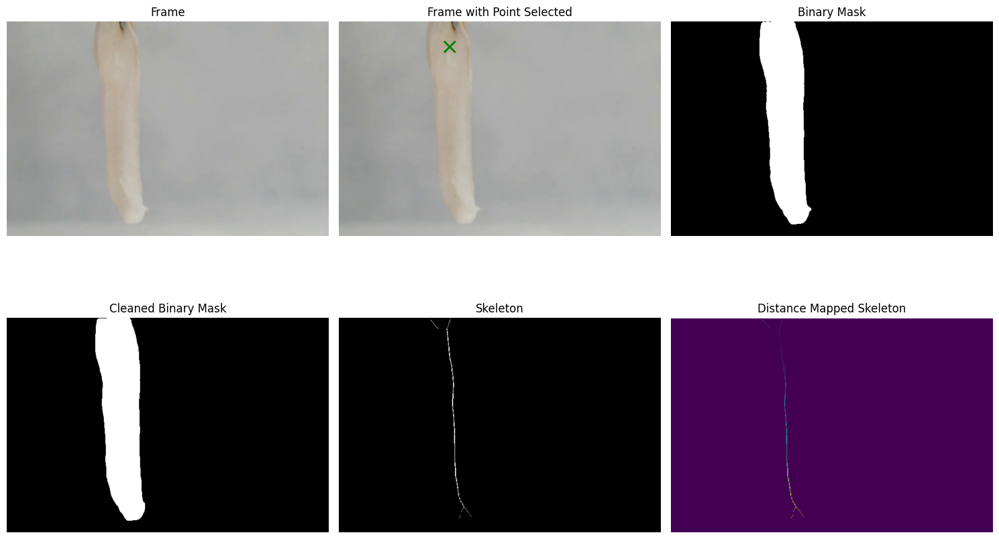

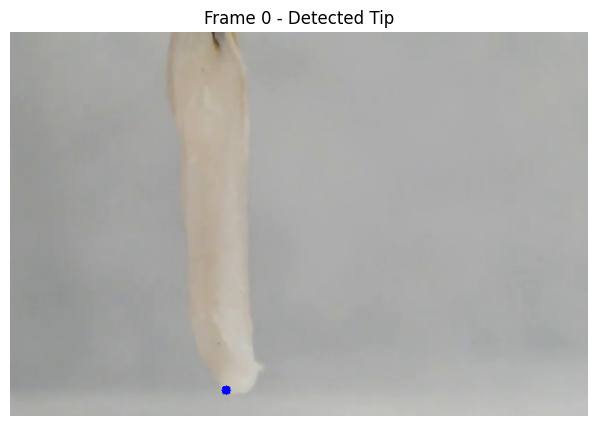


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 336.2ms
Speed: 4.9ms preprocess, 336.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 353.4ms
Speed: 3.0ms preprocess, 353.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 336.3ms
Speed: 3.0ms preprocess, 336.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 336.7ms
Speed: 3.1ms preprocess, 336.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 338.1ms
Speed: 3.0ms preprocess, 338.1

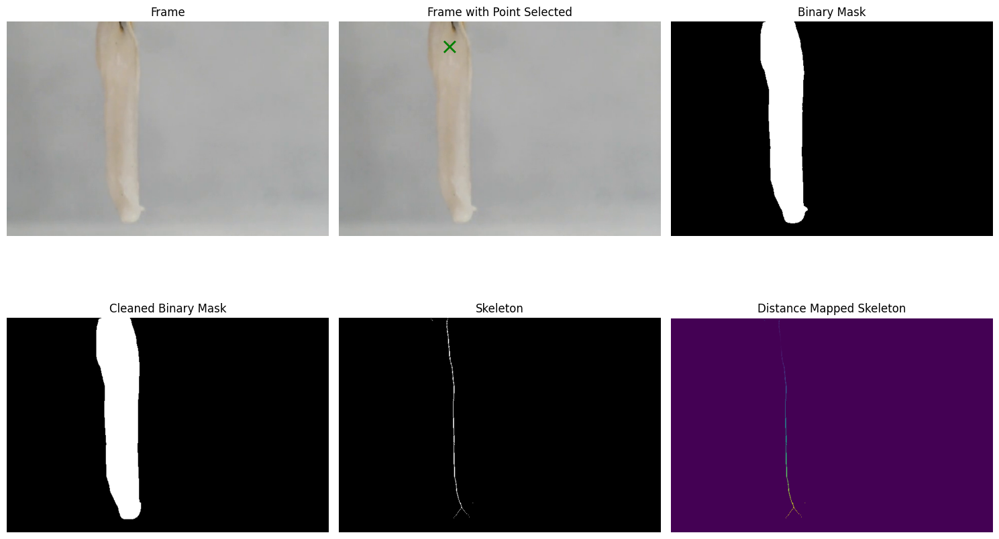

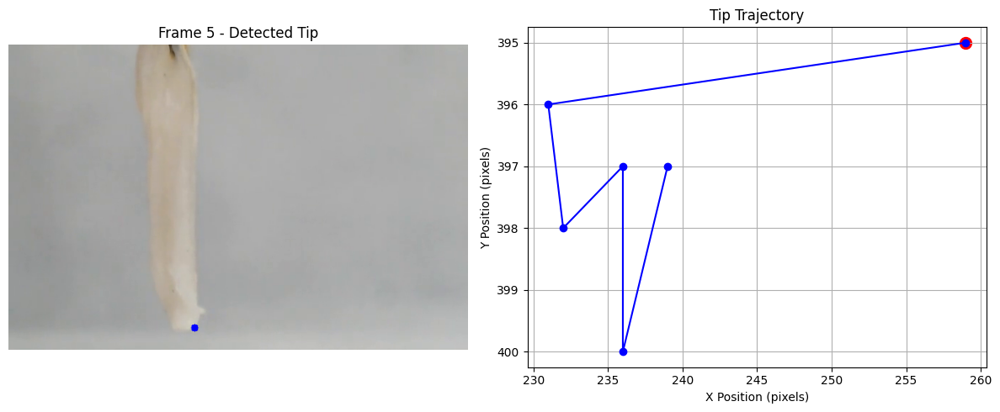


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 332.5ms
Speed: 5.0ms preprocess, 332.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 338.3ms
Speed: 3.0ms preprocess, 338.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 332.5ms
Speed: 3.0ms preprocess, 332.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 334.0ms
Speed: 3.3ms preprocess, 334.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_036.png: 1024x1024 1 0, 336.3ms
Speed: 3.0ms preprocess, 336.3

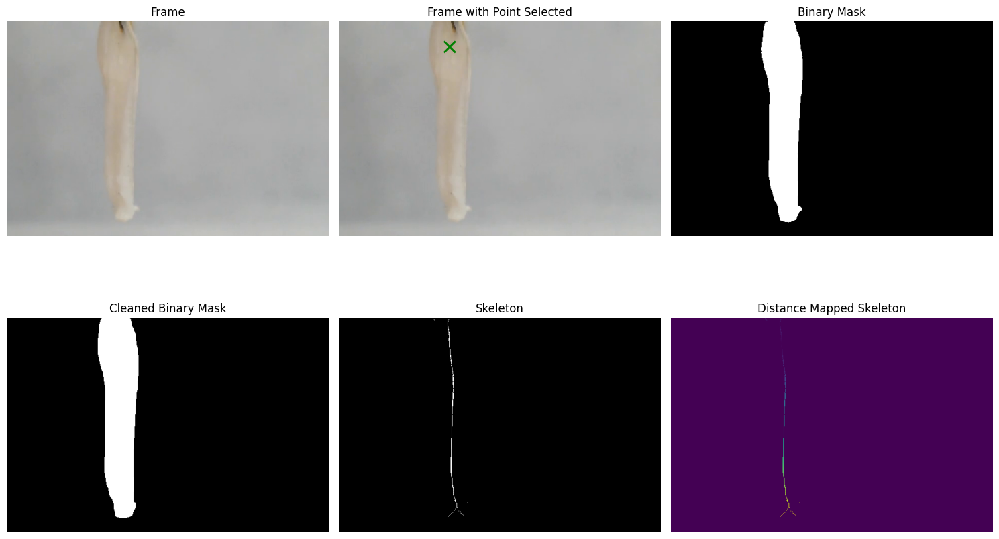

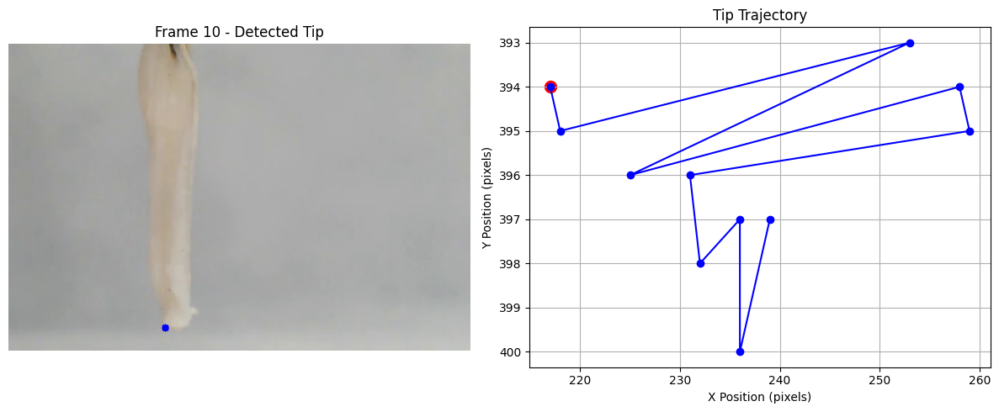


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_037.png: 1024x1024 1 0, 335.4ms
Speed: 4.7ms preprocess, 335.4ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_038.png: 1024x1024 1 0, 333.7ms
Speed: 2.9ms preprocess, 333.7ms inference, 0.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_039.png: 1024x1024 1 0, 333.8ms
Speed: 3.0ms preprocess, 333.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_040.png: 1024x1024 1 0, 331.8ms
Speed: 3.0ms preprocess, 331.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_041.png: 1024x1024 1 0, 332.5ms
Speed: 2.9ms preprocess, 332.5

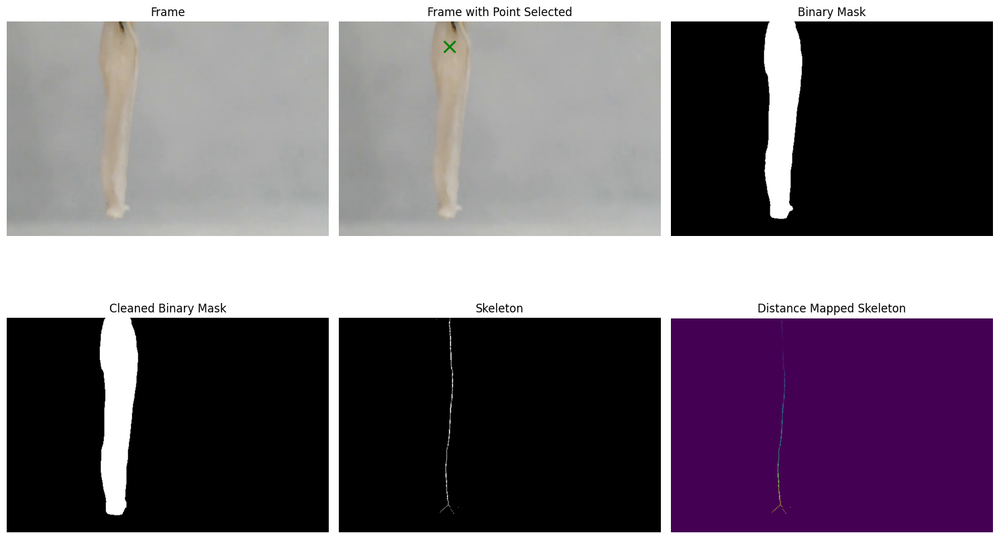

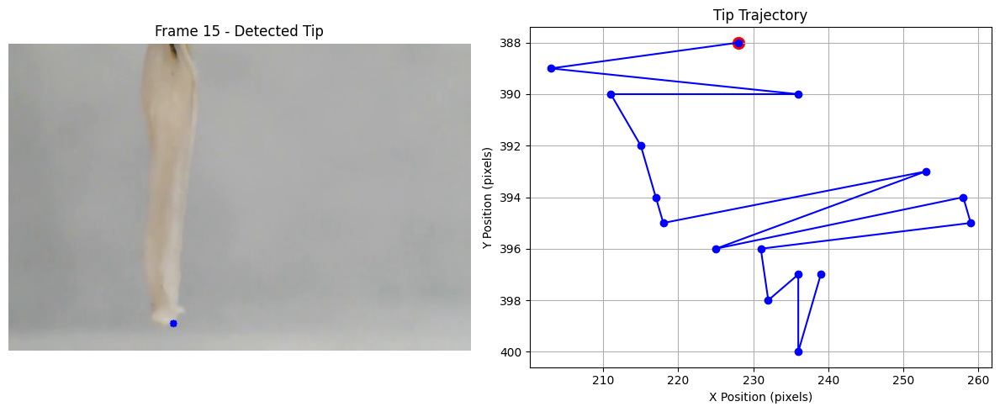


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_042.png: 1024x1024 1 0, 341.9ms
Speed: 5.2ms preprocess, 341.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_043.png: 1024x1024 1 0, 326.7ms
Speed: 3.0ms preprocess, 326.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_044.png: 1024x1024 1 0, 328.8ms
Speed: 2.9ms preprocess, 328.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_045.png: 1024x1024 1 0, 327.8ms
Speed: 3.0ms preprocess, 327.8ms inference, 0.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_046.png: 1024x1024 1 0, 328.7ms
Speed: 3.0ms preprocess, 328.7

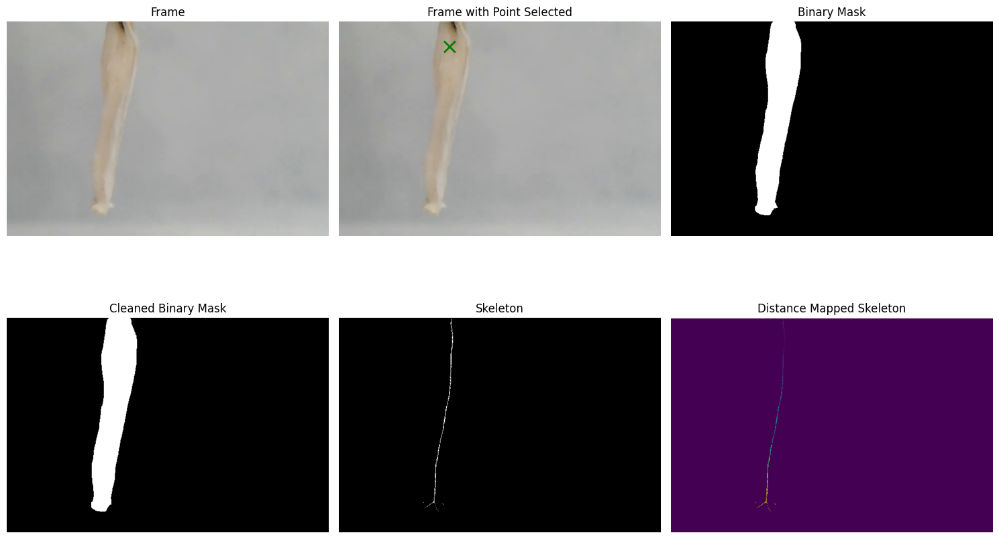

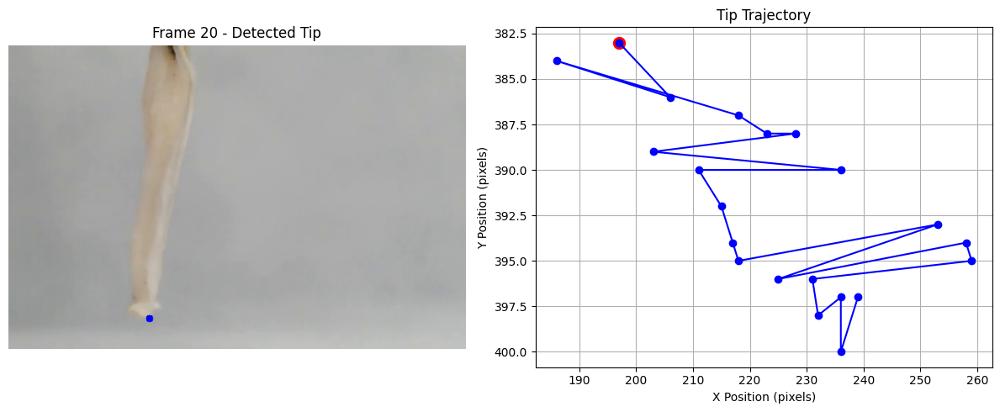


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_047.png: 1024x1024 1 0, 339.6ms
Speed: 5.0ms preprocess, 339.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_048.png: 1024x1024 1 0, 336.0ms
Speed: 3.1ms preprocess, 336.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_049.png: 1024x1024 1 0, 335.1ms
Speed: 3.1ms preprocess, 335.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_050.png: 1024x1024 1 0, 336.8ms
Speed: 3.0ms preprocess, 336.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_051.png: 1024x1024 1 0, 337.7ms
Speed: 3.1ms preprocess, 337.7

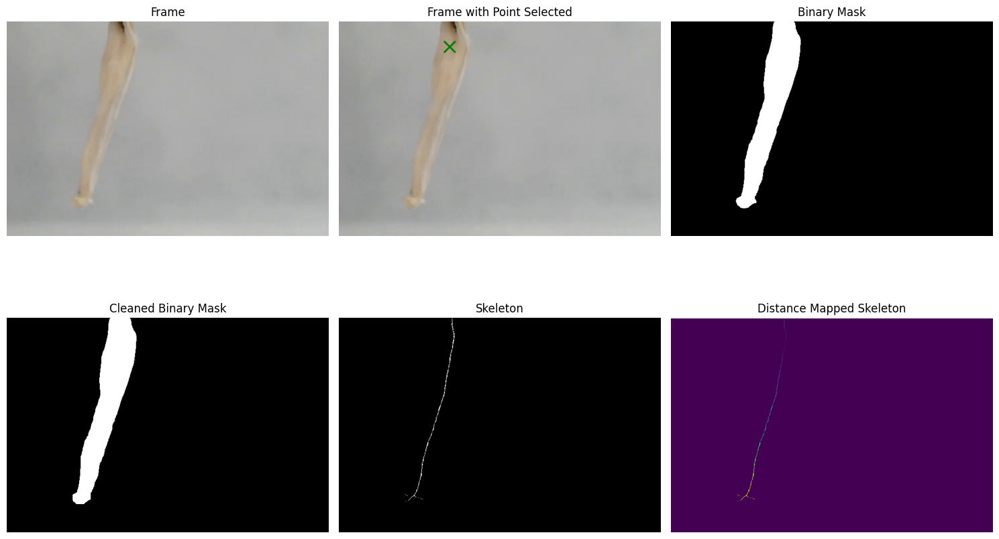

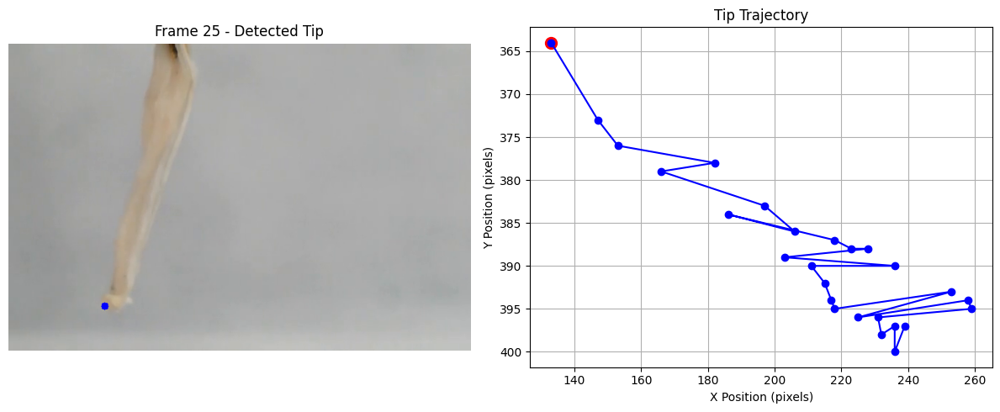


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_052.png: 1024x1024 1 0, 334.7ms
Speed: 4.9ms preprocess, 334.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_053.png: 1024x1024 1 0, 347.2ms
Speed: 3.0ms preprocess, 347.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_054.png: 1024x1024 1 0, 328.0ms
Speed: 3.1ms preprocess, 328.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_055.png: 1024x1024 1 0, 329.3ms
Speed: 3.1ms preprocess, 329.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_056.png: 1024x1024 1 0, 329.1ms
Speed: 3.0ms preprocess, 329.1

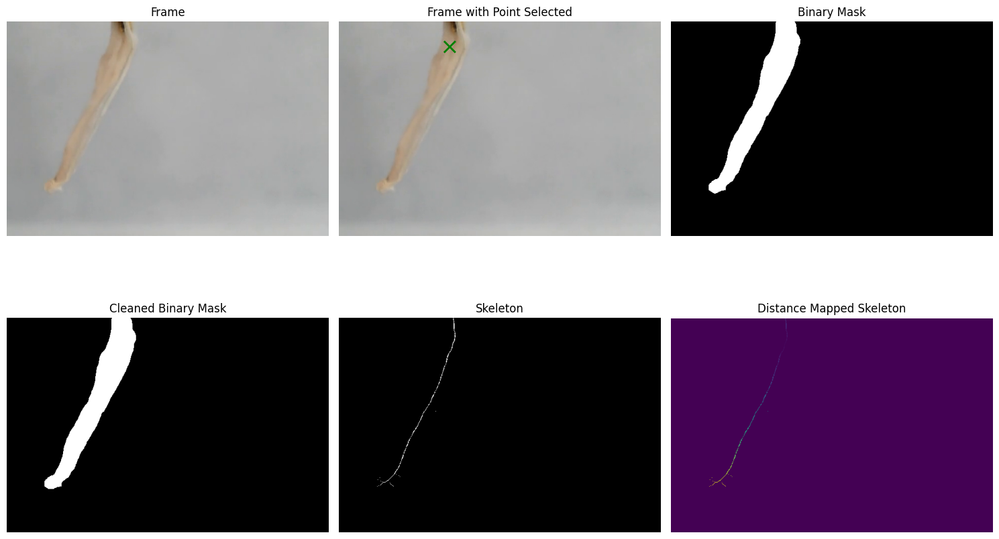

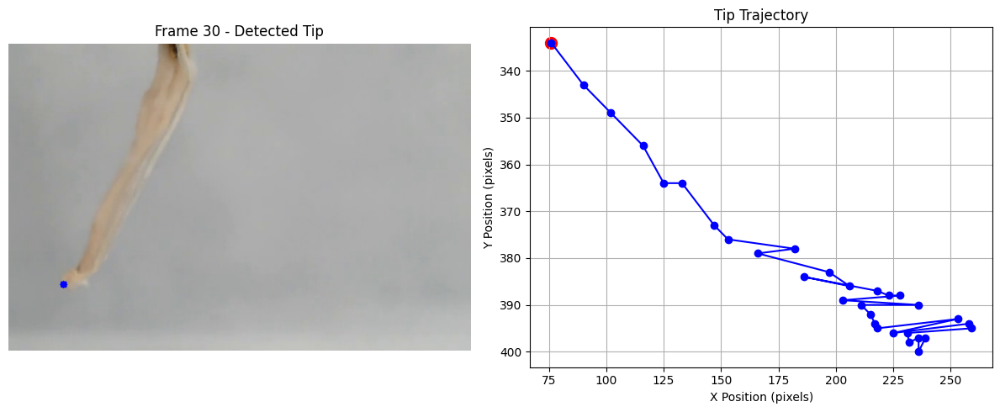


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_057.png: 1024x1024 1 0, 336.0ms
Speed: 4.9ms preprocess, 336.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_058.png: 1024x1024 1 0, 337.2ms
Speed: 3.1ms preprocess, 337.2ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_059.png: 1024x1024 1 0, 352.9ms
Speed: 3.5ms preprocess, 352.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_060.png: 1024x1024 1 0, 334.2ms
Speed: 3.1ms preprocess, 334.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_061.png: 1024x1024 1 0, 337.7ms
Speed: 3.0ms preprocess, 337.7

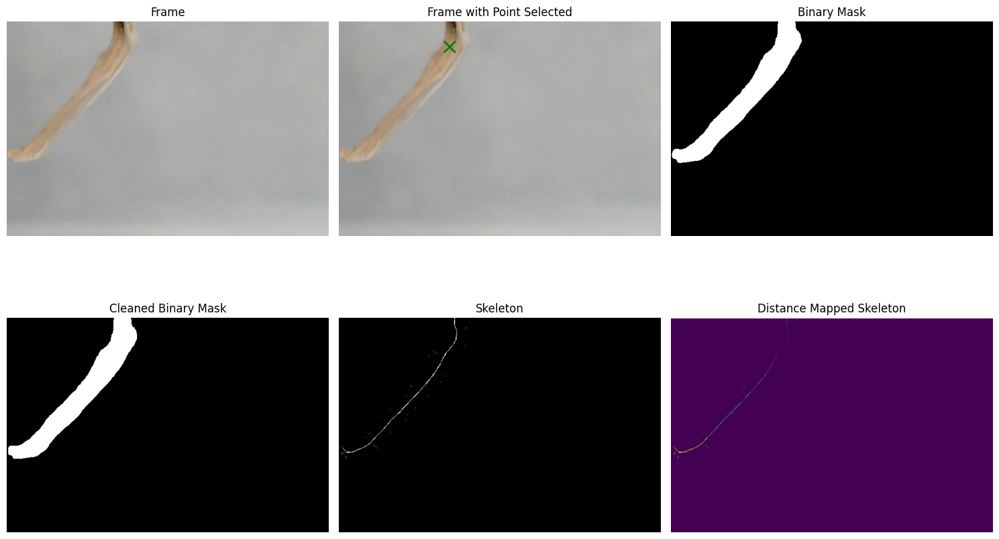

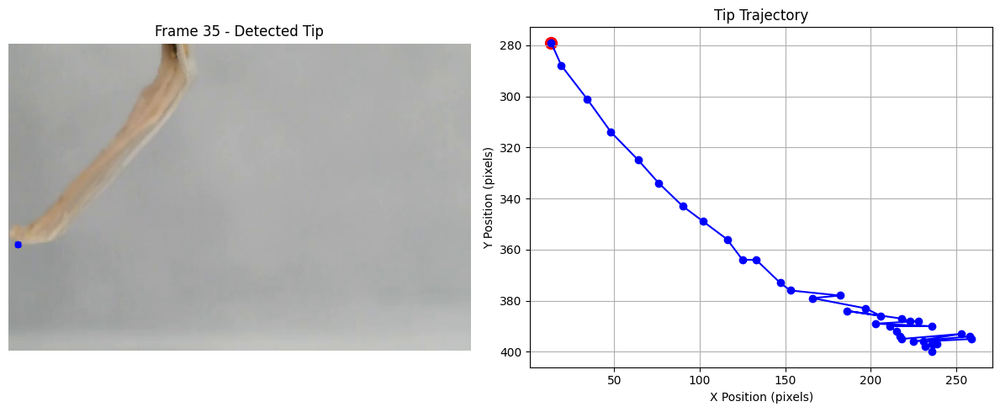


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_062.png: 1024x1024 1 0, 334.3ms
Speed: 4.9ms preprocess, 334.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


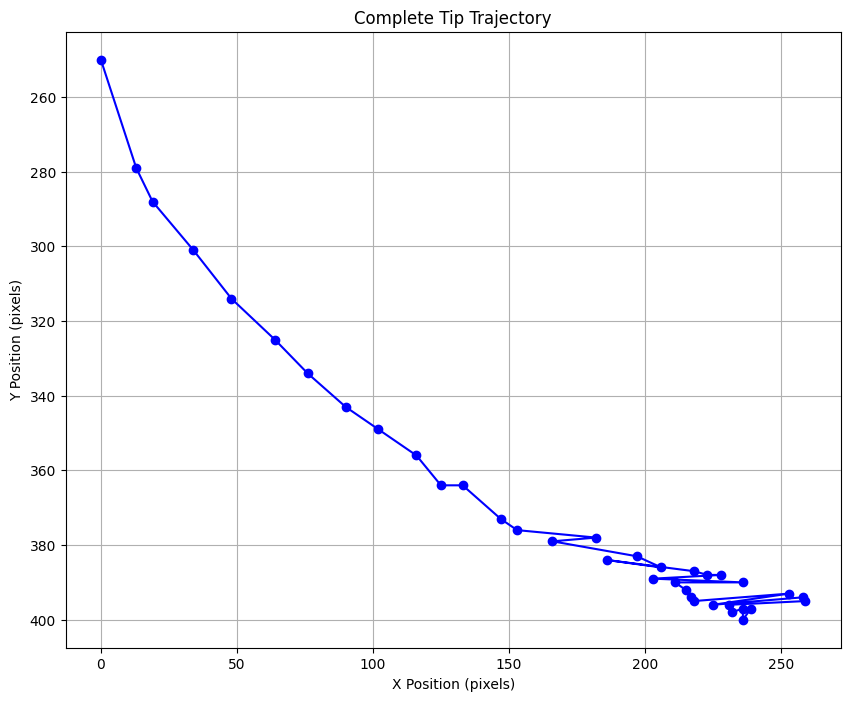

In [47]:
# Set paths
video_name = f"bimorph_idx2_100x" # without the .mov
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 25
end_frame = 100
frame_interval=0.6
point = (220, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    edge_cushion =0,
    tip_margin=20, # boosting the tip margin since there are a few points with similar distance in the skeleton
    no_wandering_anchor=True,
)


for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

Analyzing frames 0 to 34
Total frames used: 35



ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_001.png: 1024x1024 1 0, 356.8ms
Speed: 3.1ms preprocess, 356.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

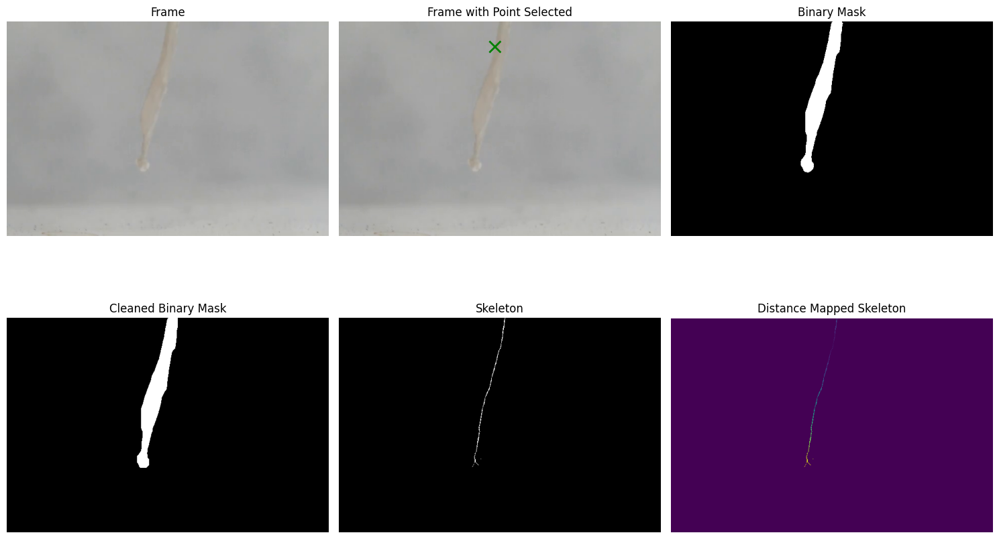

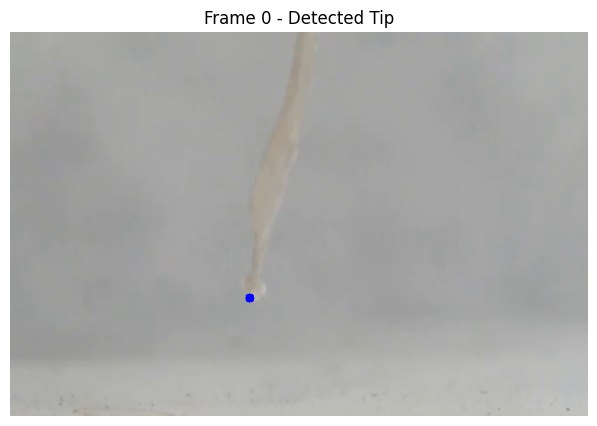


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_002.png: 1024x1024 1 0, 349.2ms
Speed: 5.4ms preprocess, 349.2ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_003.png: 1024x1024 1 0, 334.7ms
Speed: 3.1ms preprocess, 334.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 334.7ms
Speed: 3.1ms preprocess, 334.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 336.2ms
Speed: 3.1ms preprocess, 336.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 338.4ms
Speed: 3.1ms preprocess, 338.4

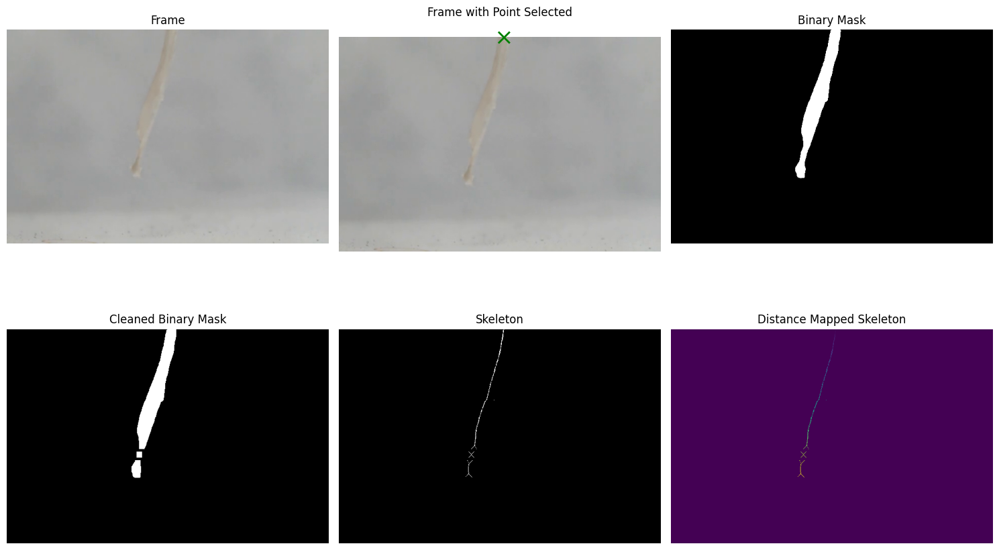

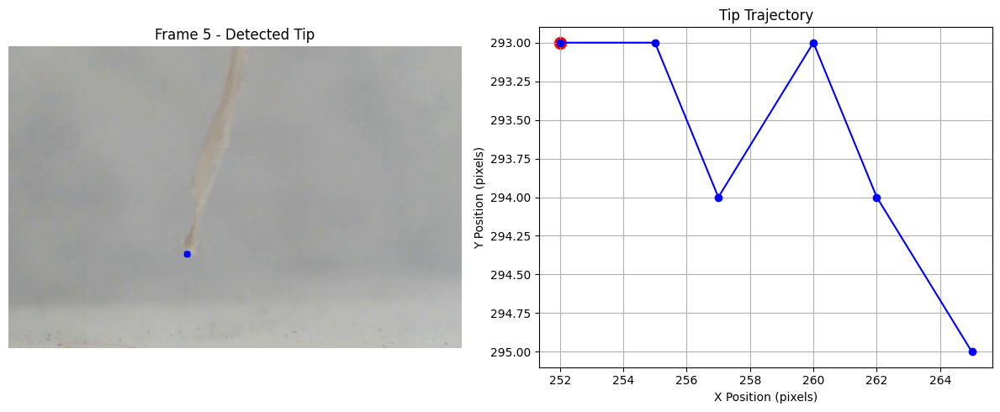


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 335.6ms
Speed: 4.8ms preprocess, 335.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 348.9ms
Speed: 3.1ms preprocess, 348.9ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 336.1ms
Speed: 3.2ms preprocess, 336.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 336.9ms
Speed: 3.1ms preprocess, 336.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 337.7ms
Speed: 3.2ms preprocess, 337.7

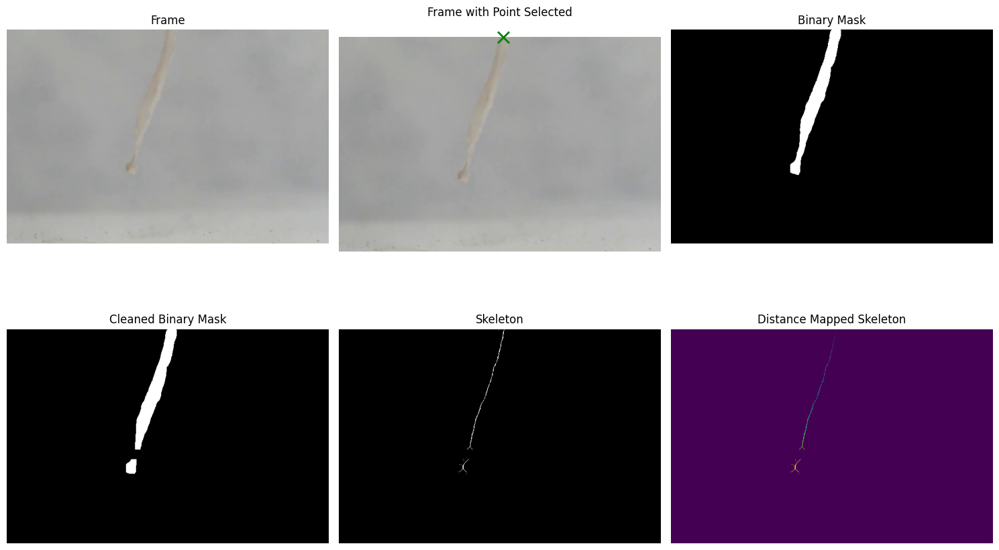

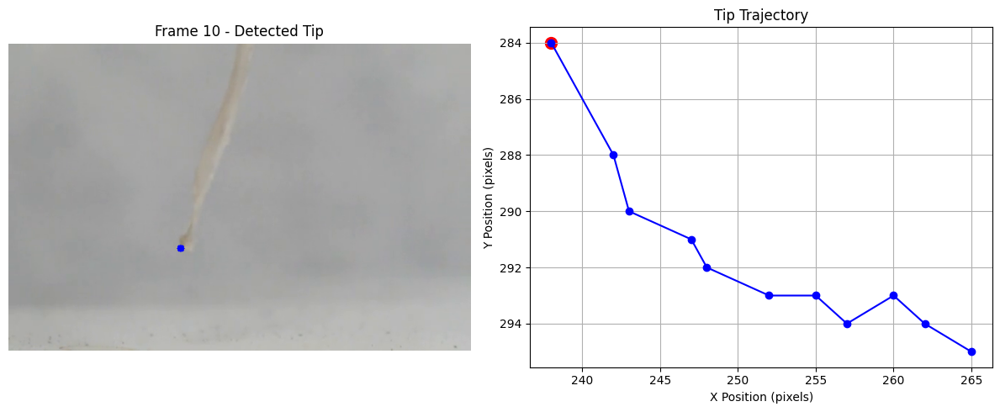


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 335.1ms
Speed: 4.8ms preprocess, 335.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 350.0ms
Speed: 3.2ms preprocess, 350.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 337.5ms
Speed: 3.0ms preprocess, 337.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 337.9ms
Speed: 3.0ms preprocess, 337.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 337.6ms
Speed: 3.0ms preprocess, 337.6

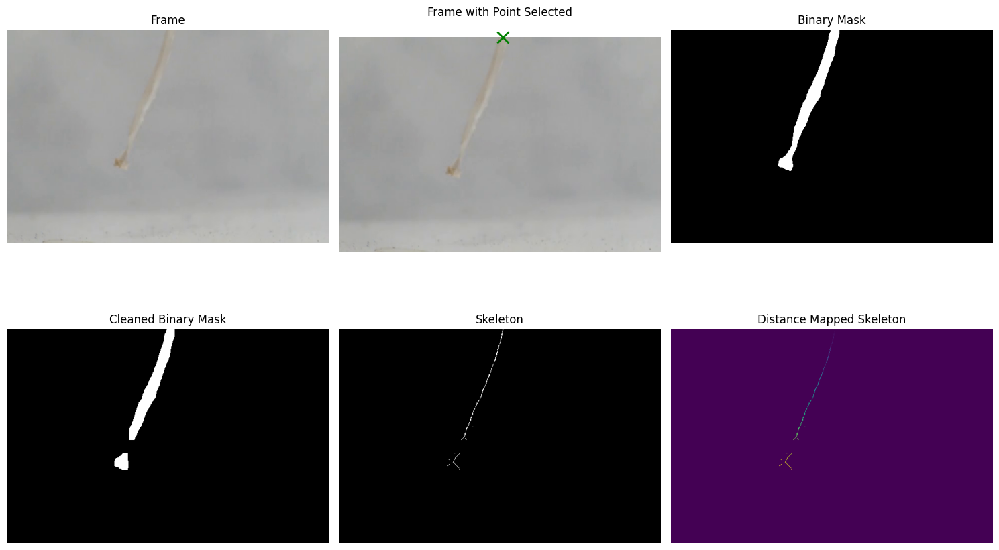

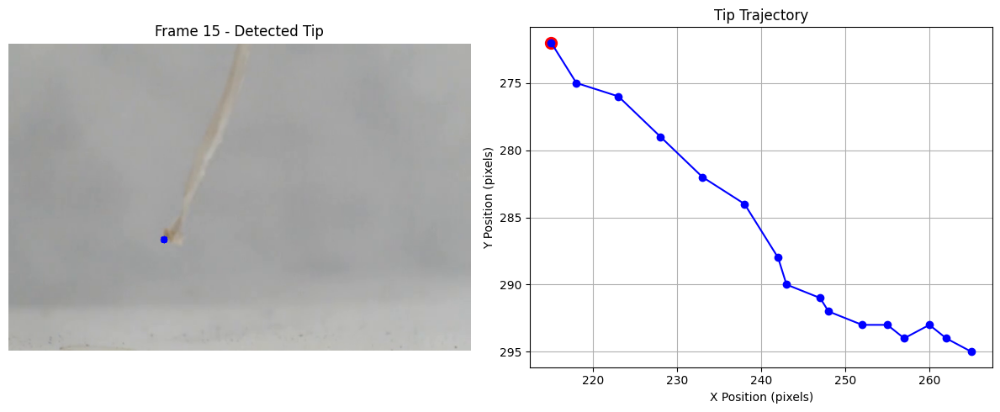


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 338.4ms
Speed: 5.0ms preprocess, 338.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 349.8ms
Speed: 3.2ms preprocess, 349.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 337.8ms
Speed: 3.1ms preprocess, 337.8ms inference, 0.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 335.8ms
Speed: 3.1ms preprocess, 335.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 334.8ms
Speed: 3.0ms preprocess, 334.8

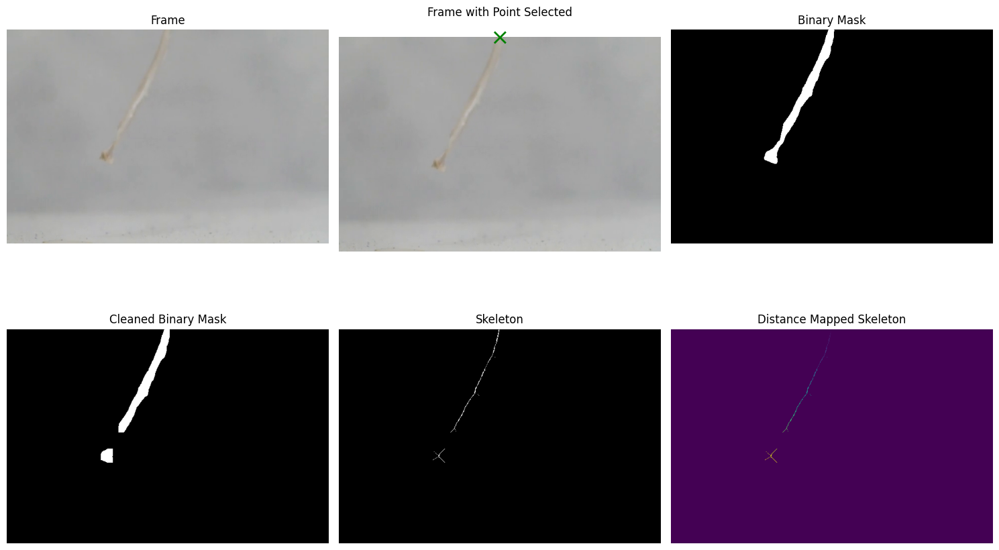

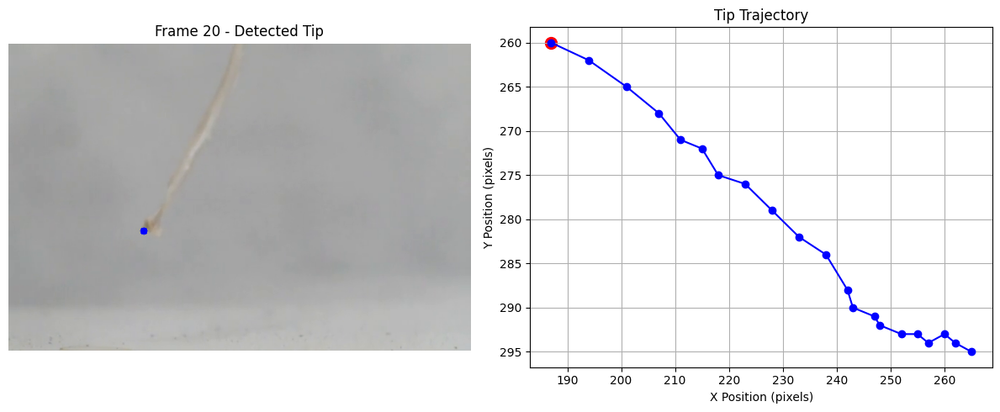


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 328.9ms
Speed: 5.0ms preprocess, 328.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 331.5ms
Speed: 3.1ms preprocess, 331.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 344.1ms
Speed: 3.1ms preprocess, 344.1ms inference, 0.5ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 337.0ms
Speed: 3.1ms preprocess, 337.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 338.2ms
Speed: 3.1ms preprocess, 338.2

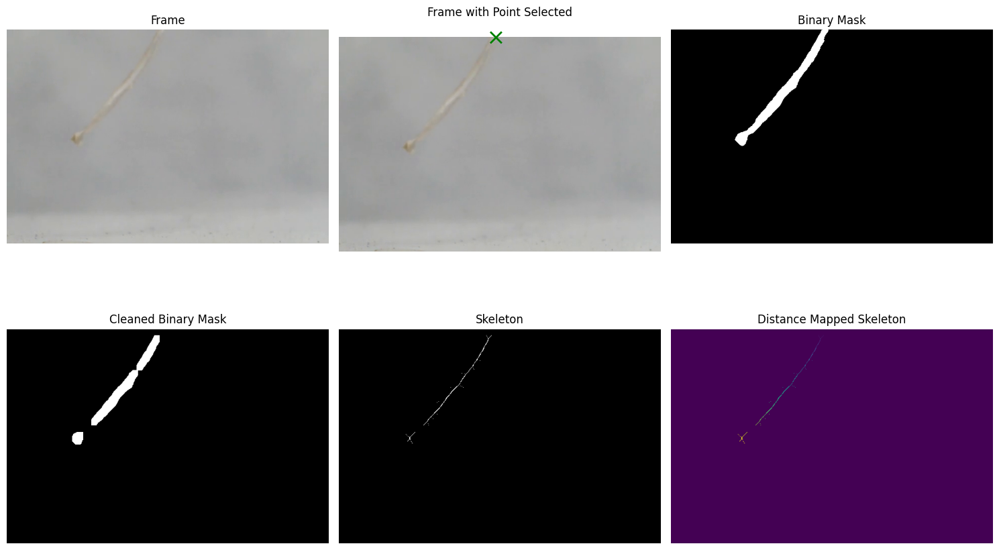

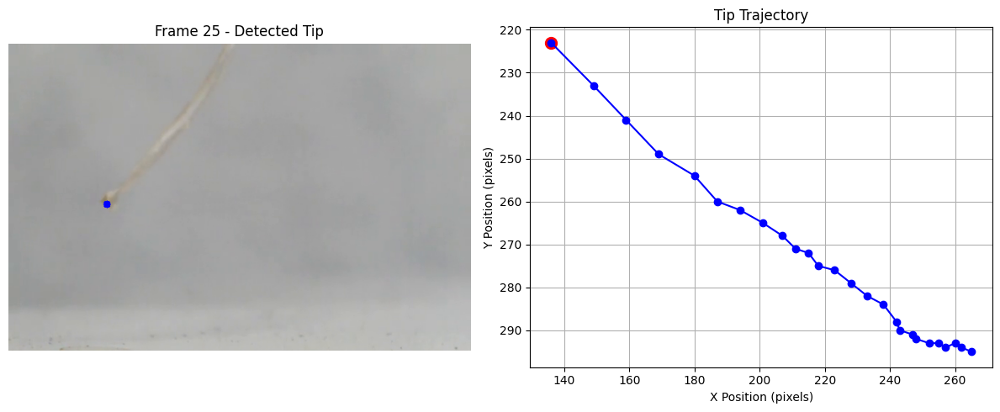


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 340.6ms
Speed: 4.9ms preprocess, 340.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 337.6ms
Speed: 3.1ms preprocess, 337.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 335.7ms
Speed: 3.1ms preprocess, 335.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 336.2ms
Speed: 3.1ms preprocess, 336.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 334.9ms
Speed: 3.1ms preprocess, 334.9

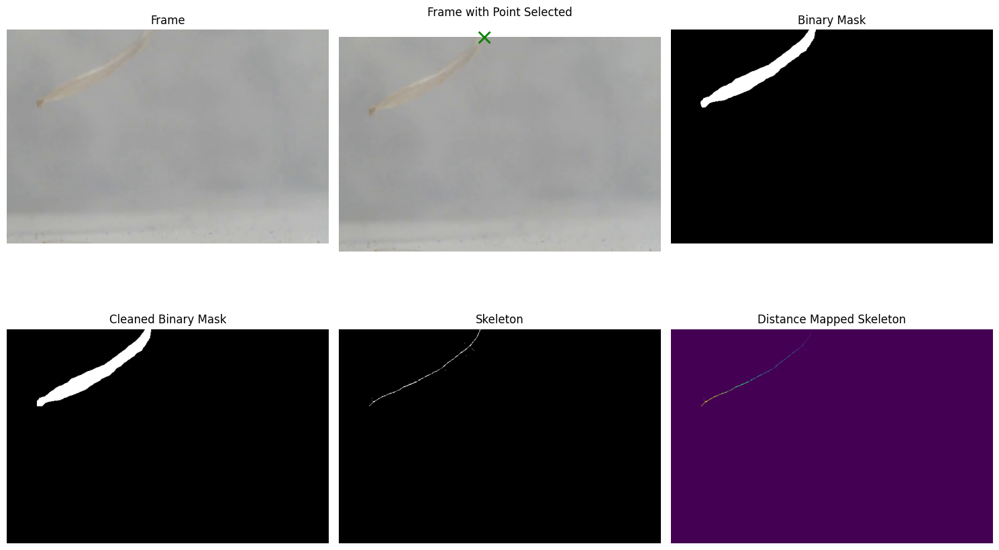

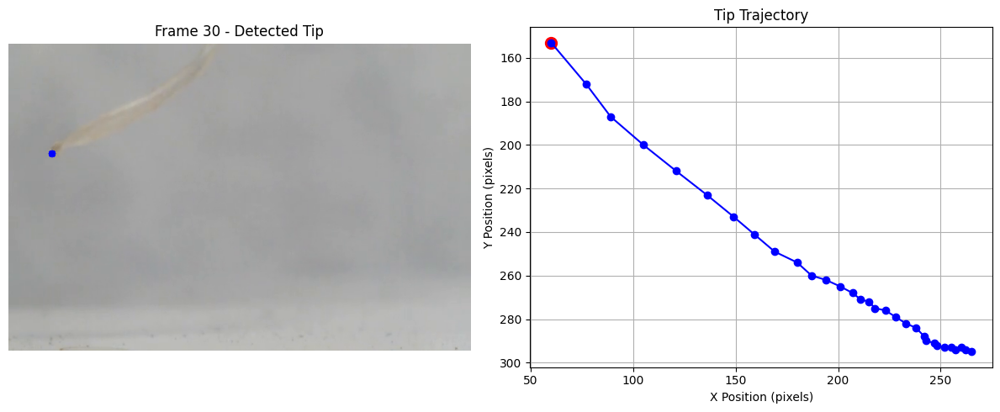


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 343.6ms
Speed: 4.9ms preprocess, 343.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 347.0ms
Speed: 3.1ms preprocess, 347.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 337.5ms
Speed: 3.1ms preprocess, 337.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_035.png: 1024x1024 1 0, 336.5ms
Speed: 3.0ms preprocess, 336.5ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)


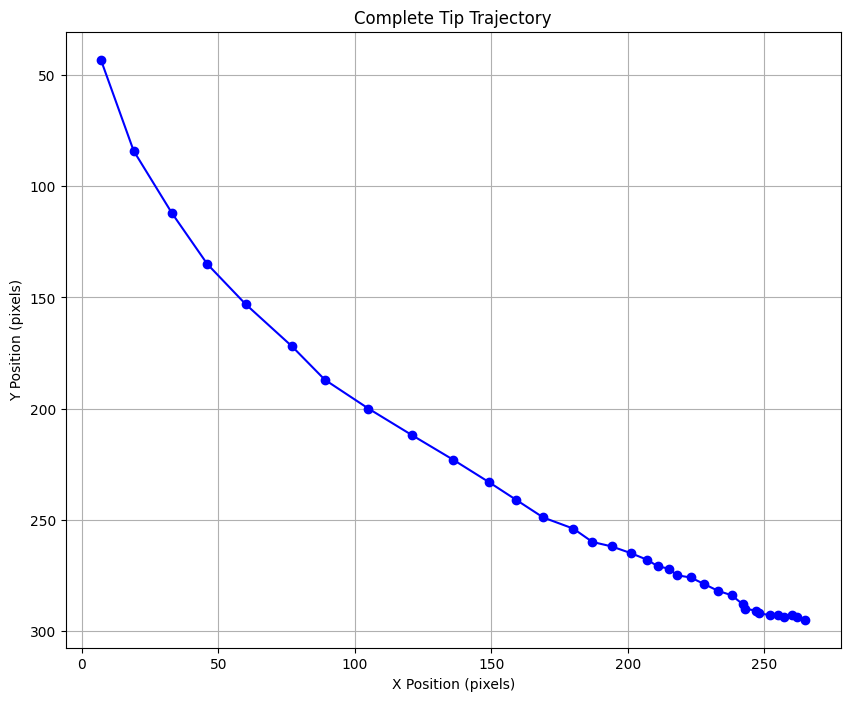

In [48]:
# Set paths
video_name = f"bimorph_idx3_100x" 
video_path = f"bimorph_videos/{video_name}.mov"
temp_folder = "tracking_frames/"
start_frame = 0
end_frame = 35
frame_interval=0.6
point = (310, 50)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    edge_cushion =0,
    opening_kernel=(3,3)
)

for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)

Analyzing frames 0 to 33
Total frames used: 34



ffmpeg version 6.1.1-3ubuntu5 Copyright (c) 2000-2023 the FFmpeg developers
  built with gcc 13 (Ubuntu 13.2.0-23ubuntu3)
  configuration: --prefix=/usr --extra-version=3ubuntu5 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --disable-omx --enable-gnutls --enable-libaom --enable-libass --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libglslang --enable-libgme --enable-libgsm --enable-libharfbuzz --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx265 --enable-libxml2 --enable-libxvid --enable-libzimg --ena

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_001.png: 1024x1024 1 0, 362.2ms
Speed: 3.1ms preprocess, 362.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


<Figure size 1200x1000 with 0 Axes>

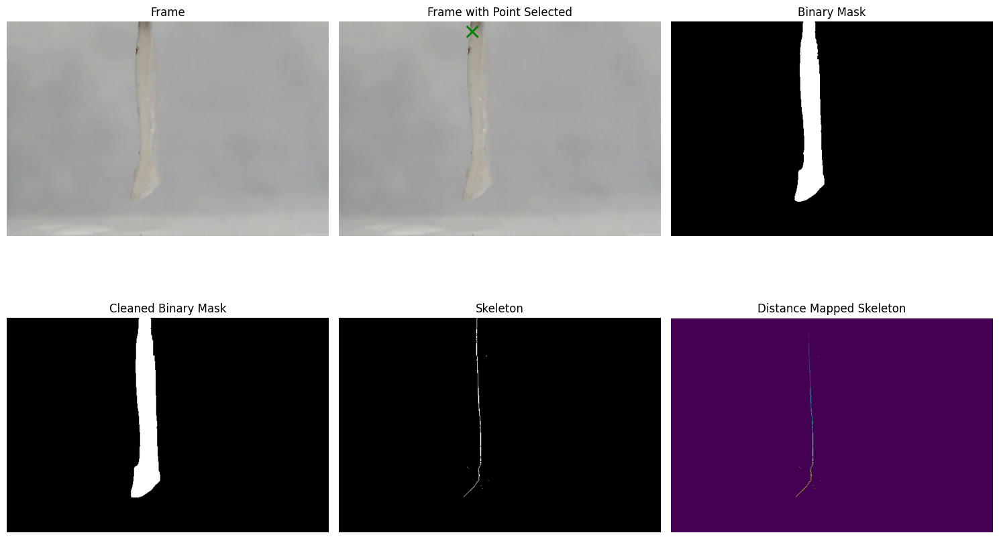

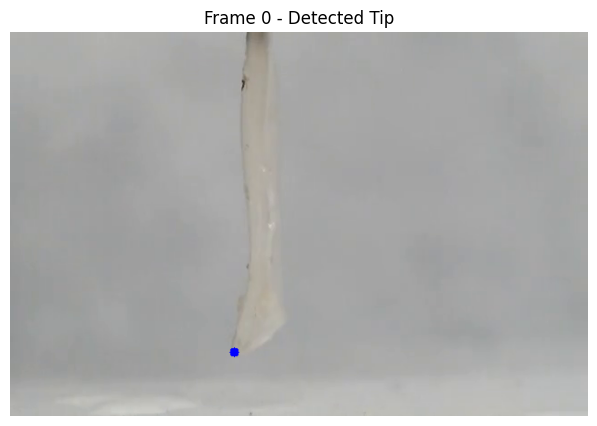


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_002.png: 1024x1024 1 0, 329.9ms
Speed: 4.9ms preprocess, 329.9ms inference, 0.7ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_003.png: 1024x1024 1 0, 334.1ms
Speed: 12.7ms preprocess, 334.1ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_004.png: 1024x1024 1 0, 332.7ms
Speed: 3.1ms preprocess, 332.7ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_005.png: 1024x1024 1 0, 332.5ms
Speed: 3.1ms preprocess, 332.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_006.png: 1024x1024 1 0, 332.8ms
Speed: 3.1ms preprocess, 332.

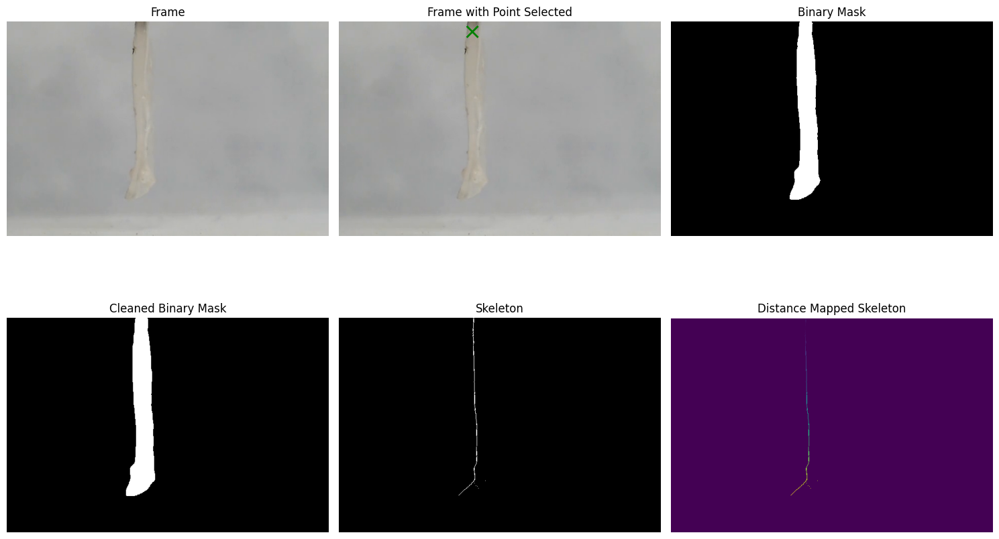

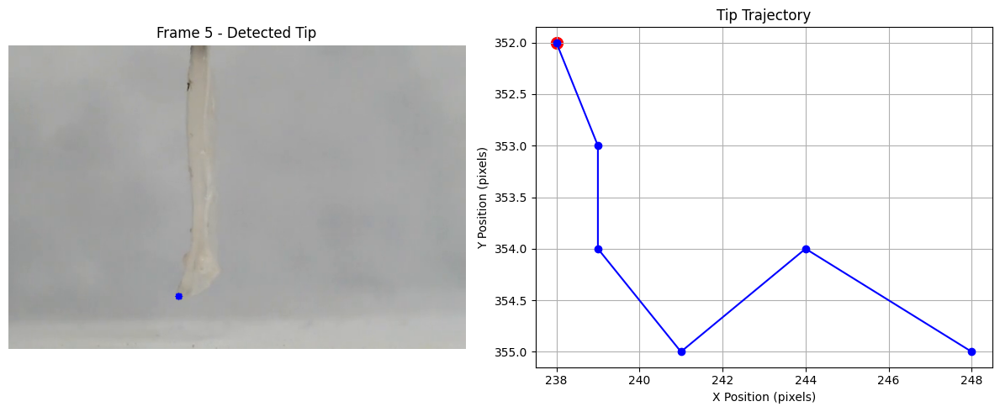


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_007.png: 1024x1024 1 0, 330.0ms
Speed: 4.8ms preprocess, 330.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_008.png: 1024x1024 1 0, 341.8ms
Speed: 3.0ms preprocess, 341.8ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_009.png: 1024x1024 1 0, 331.8ms
Speed: 3.1ms preprocess, 331.8ms inference, 1.0ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_010.png: 1024x1024 1 0, 331.6ms
Speed: 3.0ms preprocess, 331.6ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_011.png: 1024x1024 1 0, 330.9ms
Speed: 3.0ms preprocess, 330.9

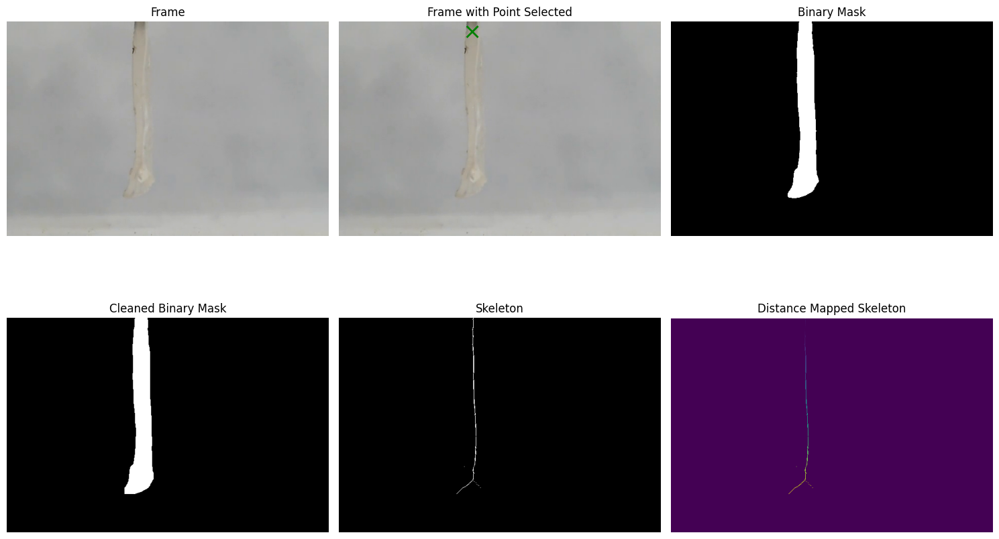

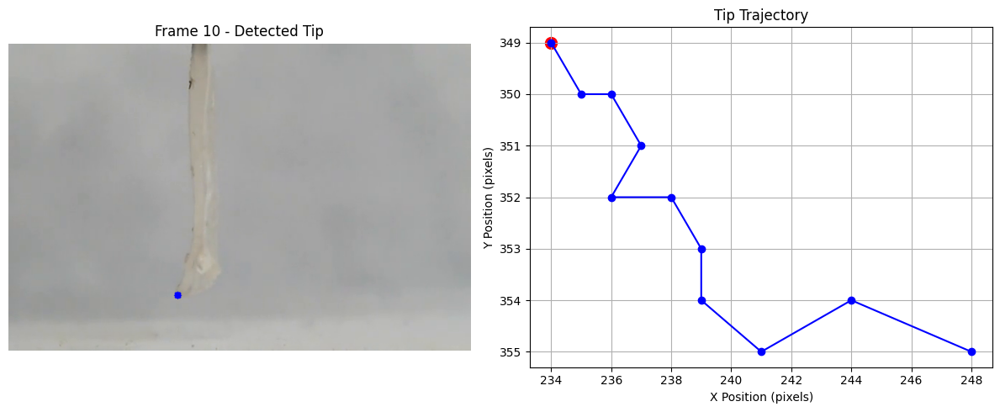


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_012.png: 1024x1024 1 0, 330.4ms
Speed: 4.8ms preprocess, 330.4ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_013.png: 1024x1024 1 0, 345.5ms
Speed: 2.9ms preprocess, 345.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_014.png: 1024x1024 1 0, 328.3ms
Speed: 2.9ms preprocess, 328.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_015.png: 1024x1024 1 0, 328.5ms
Speed: 2.9ms preprocess, 328.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_016.png: 1024x1024 1 0, 327.9ms
Speed: 3.0ms preprocess, 327.9

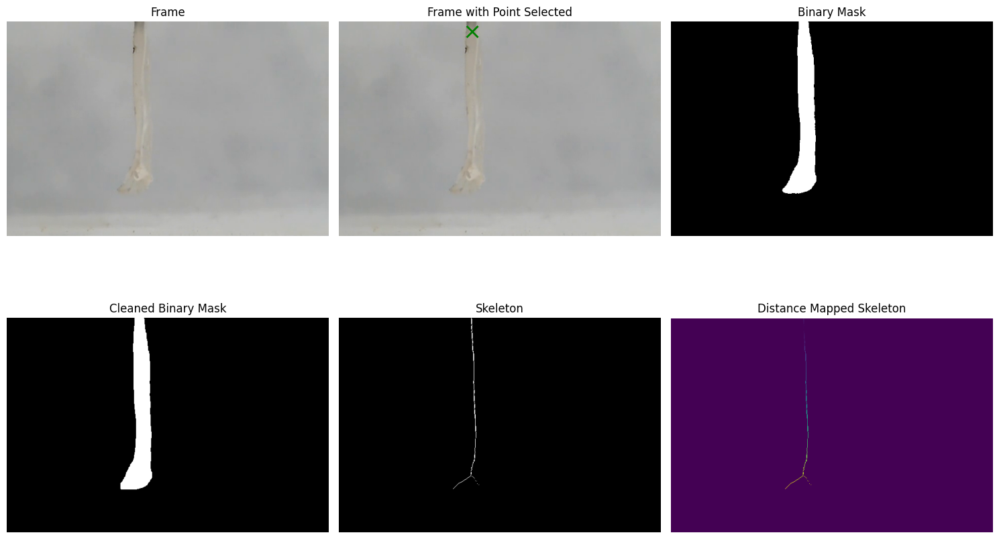

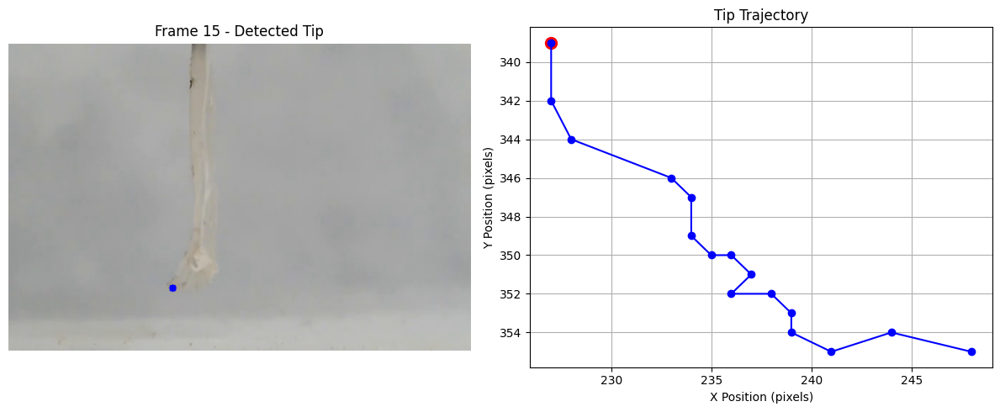


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_017.png: 1024x1024 1 0, 331.5ms
Speed: 4.9ms preprocess, 331.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_018.png: 1024x1024 1 0, 345.8ms
Speed: 3.3ms preprocess, 345.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_019.png: 1024x1024 1 0, 329.2ms
Speed: 3.1ms preprocess, 329.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_020.png: 1024x1024 1 0, 328.5ms
Speed: 3.1ms preprocess, 328.5ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_021.png: 1024x1024 1 0, 328.2ms
Speed: 3.1ms preprocess, 328.2

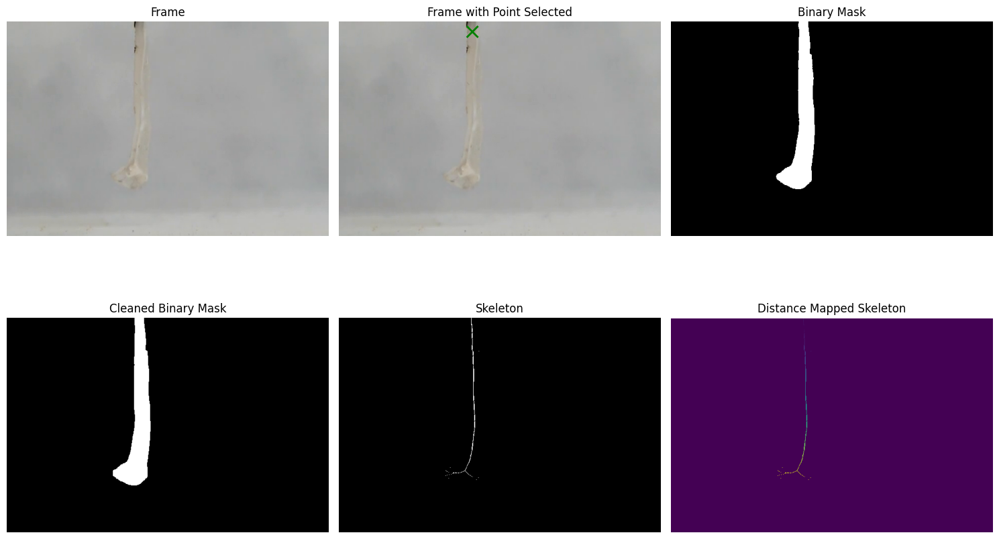

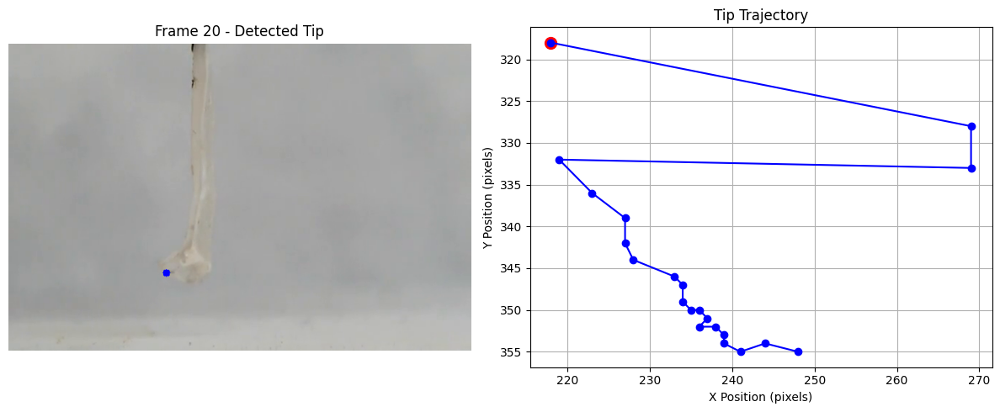


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_022.png: 1024x1024 1 0, 328.7ms
Speed: 3.1ms preprocess, 328.7ms inference, 0.8ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_023.png: 1024x1024 1 0, 334.8ms
Speed: 3.1ms preprocess, 334.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_024.png: 1024x1024 1 0, 330.3ms
Speed: 3.1ms preprocess, 330.3ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_025.png: 1024x1024 1 0, 329.8ms
Speed: 3.1ms preprocess, 329.8ms inference, 0.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_026.png: 1024x1024 1 0, 331.0ms
Speed: 3.1ms preprocess, 331.0

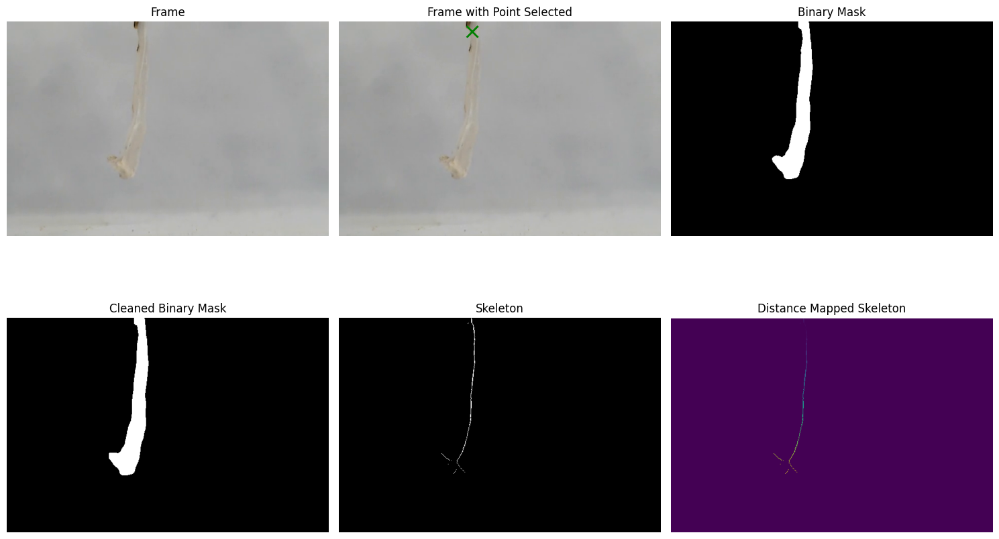

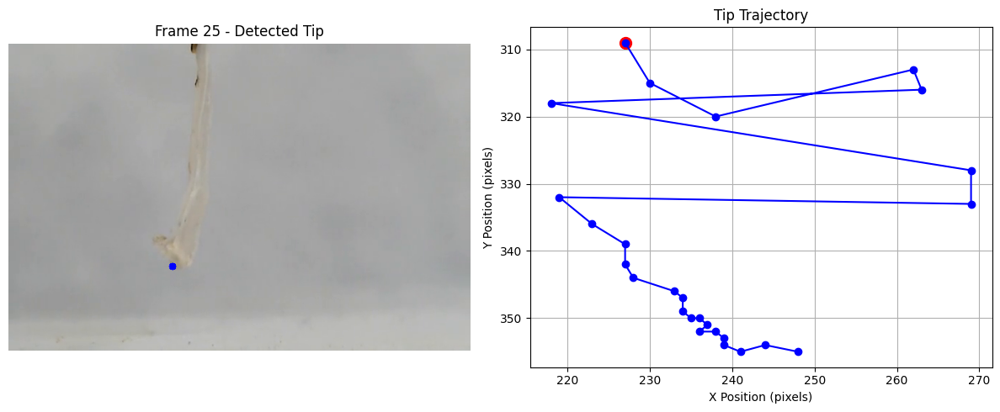


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_027.png: 1024x1024 1 0, 329.9ms
Speed: 4.9ms preprocess, 329.9ms inference, 0.6ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_028.png: 1024x1024 1 0, 330.0ms
Speed: 3.1ms preprocess, 330.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_029.png: 1024x1024 1 0, 328.6ms
Speed: 3.0ms preprocess, 328.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_030.png: 1024x1024 1 0, 329.6ms
Speed: 3.2ms preprocess, 329.6ms inference, 0.9ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_031.png: 1024x1024 1 0, 329.6ms
Speed: 3.1ms preprocess, 329.6

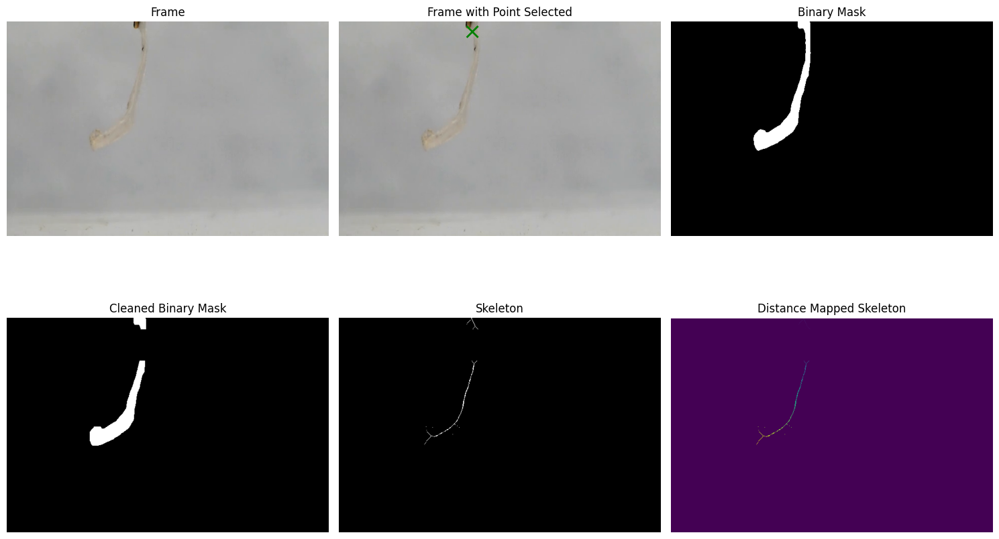

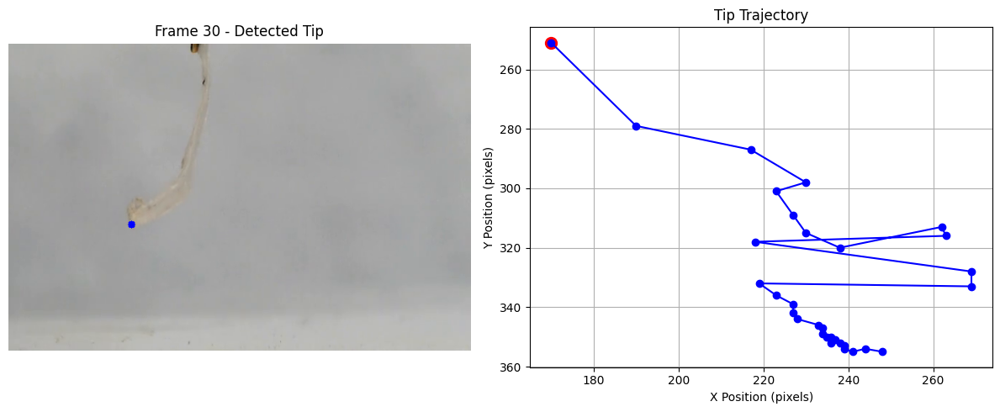


image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_032.png: 1024x1024 1 0, 328.6ms
Speed: 4.9ms preprocess, 328.6ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_033.png: 1024x1024 1 0, 339.2ms
Speed: 3.1ms preprocess, 339.2ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)

image 1/1 /home/yitongt/Documents/Github/cellulose_origami/tracking_frames/frame_034.png: 1024x1024 1 0, 329.8ms
Speed: 3.1ms preprocess, 329.8ms inference, 0.4ms postprocess per image at shape (1, 3, 1024, 1024)


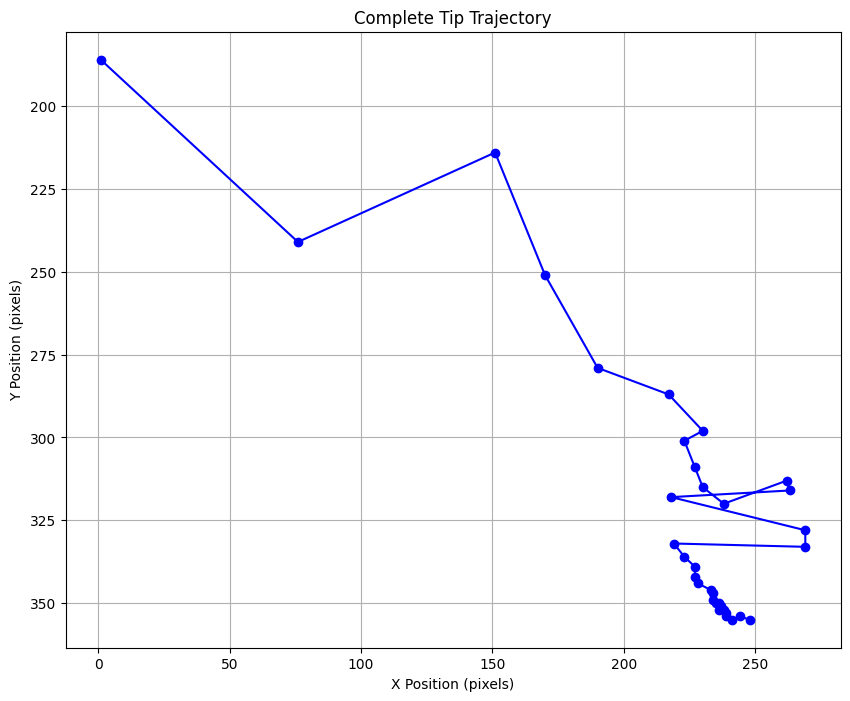

In [49]:
# Set paths
video_name = f"bimorph_idx4_100x" 
video_path = f"bimorph_videos/{video_name}.mp4"
temp_folder = "tracking_frames/"
start_frame = 0
end_frame = None
frame_interval=0.6
point = (265, 20)

extract_frames(video_path, temp_folder, interval=frame_interval)

track_actuator_tip(
    frame_folder=temp_folder,
    start_frame=start_frame,
    end_frame=end_frame,
    output_file=f"tracked_trajectories/{video_name}_tracked.csv",
    json_output_file=f"tracked_trajectories/{video_name}_json.csv",
    anchor_point=point,
    edge_cushion =0,
    maximum_tip_travel_between_frames = 150,
    tip_margin = 20,
    no_wandering_anchor=True
)

for filename in os.listdir(temp_folder):
    file_path = os.path.join(temp_folder, filename)
    if os.path.isdir(file_path):
        shutil.rmtree(file_path)
    else:
        os.remove(file_path)